In [1]:
#%matplotlib widget
%matplotlib notebook

In [171]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import stats
from scipy import linalg
from sklearn import metrics
from sklearn.mixture import GaussianMixture 
from sklearn.cluster import KMeans

import timeSeriesInsightToolkit as tsi

random_state = 170

common_params = {
    "n_init": "auto",
    "random_state": random_state,
}

mycols= plt.cm.tab20(np.arange(0,20))


def drawEllipses(means, covariances, ax, plane = None):
    for i, (mean, covar) in enumerate(zip(means, covariances)):
        if plane == 'xz':
            mean = mean[[0,2]]
            covar = covar[[0,0,2,2],[0,2,0,2]].reshape((2,2))
        v, w = linalg.eigh(covar)
        v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
        u = w[0] / linalg.norm(w[0])
        # Plot an ellipse to show the Gaussian component
        angle = np.arctan(u[1] / u[0])
        angle = 180.0 * angle / np.pi  # convert to degrees
        ell = mpl.patches.Ellipse(mean, v[0], v[1], angle=180.0 + angle,fill=False)#, color=cmap[i])
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)
        ax.scatter(mean[0],mean[1],c='k')#mycols[i])#,c=i+1,cmap="tab20")

def plot_KMeans_results(X,Xc,Zc,f,kmeans):
    fig = plt.figure()
    ax = fig.add_subplot()
    cfset = ax.contourf(Xc, Zc, f)
    labels = kmeans.predict(X)
    ax.scatter(X[:, 0], X[:, 1], s=1, c=[mycols[l] for l in labels])
    print(n_cl,kmeans.cluster_centers_)

    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))
    
def plot_GMM_results(X,Xc,Zc,f,gmm, plane = None):
    fig, [ax,ax2] = plt.subplots(1,2,figsize=(10,5))
    #ax = fig.add_subplot()
    cfset = ax.contourf(Xc, Zc, f)
    if plane == None:
        ax.scatter(X[:, 0], X[:, 1], s=1, c= [mycols[l] for l in labels])
    elif plane == 'xz':
        ax.scatter(X[:, 0], X[:, 2], s=1, c= [mycols[l] for l in labels])
    
    print(n_cl,gmm.means_)

    means = gmm.means_
    covariances = gmm.covariances_
    drawEllipses(means, covariances, ax, plane)
    
    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))
    
    means = gmm.means_
    for i, mean in enumerate(means):
        ax.text(mean[0],mean[1],'Cl.'+str(i))
    
    
    ax2.get_xaxis().set_tick_params(direction="out")
    ax2.yaxis.grid(True, alpha=0.7)
    for k, w in enumerate(gmm.weights_):
        ax2.bar(
            k,
            w,
            width=0.9,
            color="#56B4E9",
            zorder=3,
            align="center",
            edgecolor="black",
        )
        ax2.text(k, w + 0.007, "%.1f%%" % (w * 100.0), horizontalalignment="center")
    ax2.set_xlim(-0.6,  gmm.n_components - 0.4)
    ax2.set_ylim(0.0, 0.2)
    ax2.tick_params(axis="y", which="both", left=False, right=False, labelleft=False)
    ax2.tick_params(axis="x", which="both", top=False)
    return fig,ax,ax2

def plot_3D_KMeans_results(X,kmeans):    
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    #kmeans = KMeans(n_clusters=n_cl, **common_params)
    labels = kmeans.predict(X)
    ax.scatter(X[:, 0], X[:, 2], X[:, 1], c=[mycols[l] for l in labels])
    print(n_cl,kmeans.cluster_centers_)
    
    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_zlabel('y')
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))
    
def plot_3D_GMMs_results(X,gmm):    
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    #kmeans = KMeans(n_clusters=n_cl, **common_params)
    labels = gmm.predict(X)
    ax.scatter(X[:, 0], X[:, 2], X[:, 1], c=[mycols[l] for l in labels])
    #print(n_cl,gmm.means_)
    
    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_zlabel('y')
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))

In [49]:
gmm.covariances_[0]

array([[ 0.66271617,  0.01150634, -0.18131049],
       [ 0.01150634,  0.02001248, -0.02602565],
       [-0.18131049, -0.02602565,  1.51090088]])

In [53]:
gmm.covariances_[0][[0,0,2,2],[0,2,0,2]].reshape((2,2))

array([[ 0.66271617, -0.18131049],
       [-0.18131049,  1.51090088]])

# Load positions

In [16]:
basePath = "/var/www/html/records/proc/bfanini-20231026-kjtgo0m0w/" #"C:/Users/g_gos/records/proc/bfanini-20231026-kjtgo0m0w/"  #"path/to/group/folder/"
pathSes  = basePath + "preprocessed-VR-sessions-gated/" 
ids, fileNames, dfSs, df = tsi.readData(pathSes)
ids, fileNames, [paths,dpaths,fpaths] = tsi.getVarsFromSession(pathSes,['pos','dir','f'])
#print(fpaths[0].shape, paths[1].shape)
bbox = tsi.makeBBox(paths,dpaths,fpaths)

In [17]:
bbox

{'x0': -6.505999999999999,
 'x1': 5.856,
 'y0': -0.04500000000000004,
 'y1': 5.01,
 'z0': -6.006,
 'z1': 5.936}

/tmp/ipykernel_901829/1585646939.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


<IPython.core.display.Javascript object>


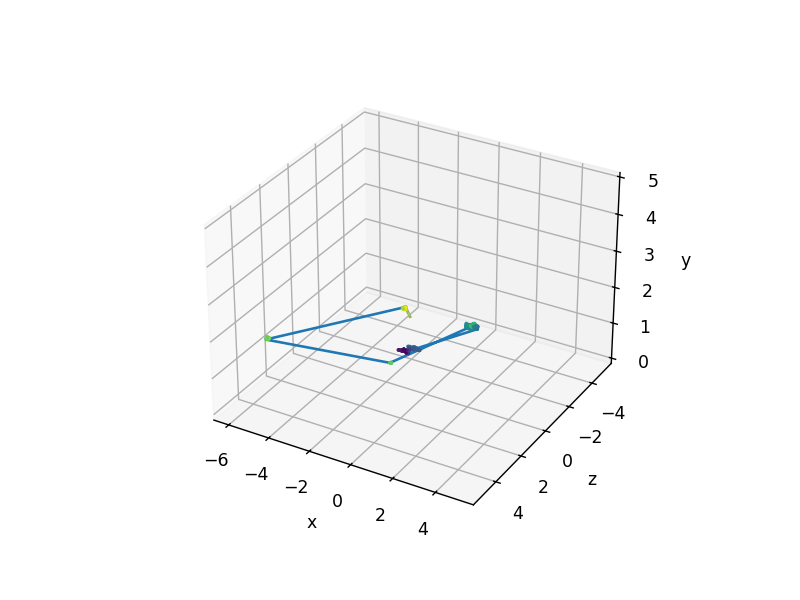

<IPython.core.display.Javascript object>


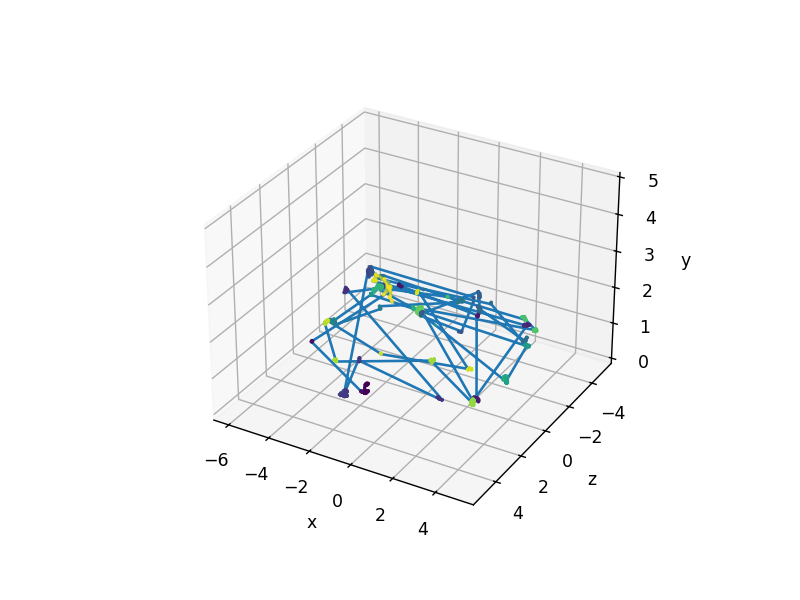

<IPython.core.display.Javascript object>


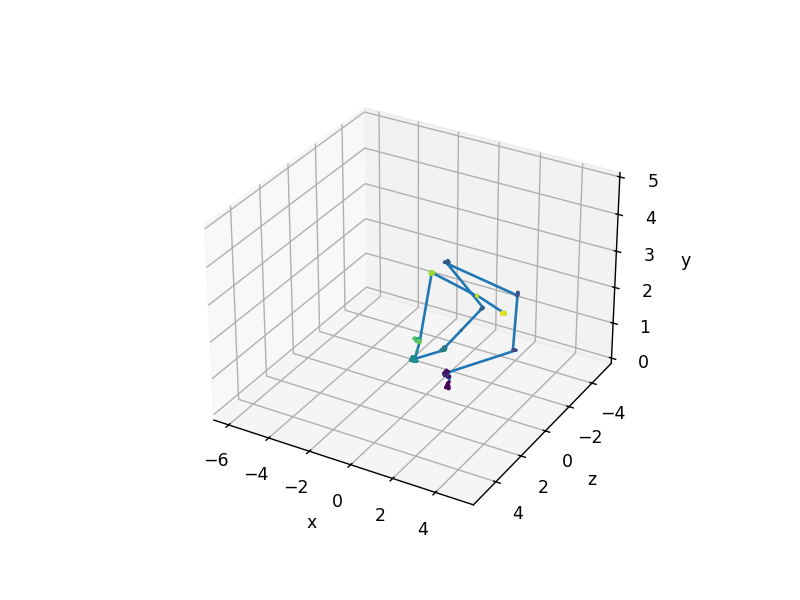

<IPython.core.display.Javascript object>


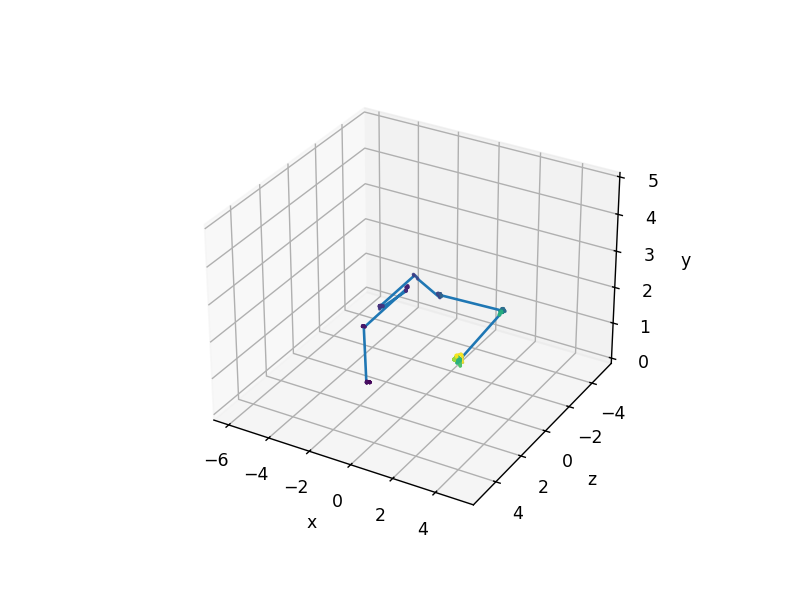

<IPython.core.display.Javascript object>


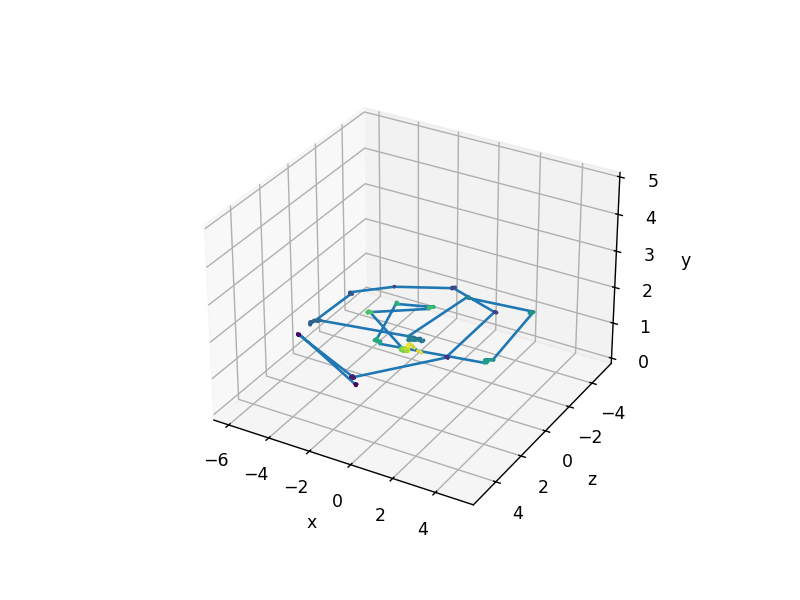

<IPython.core.display.Javascript object>


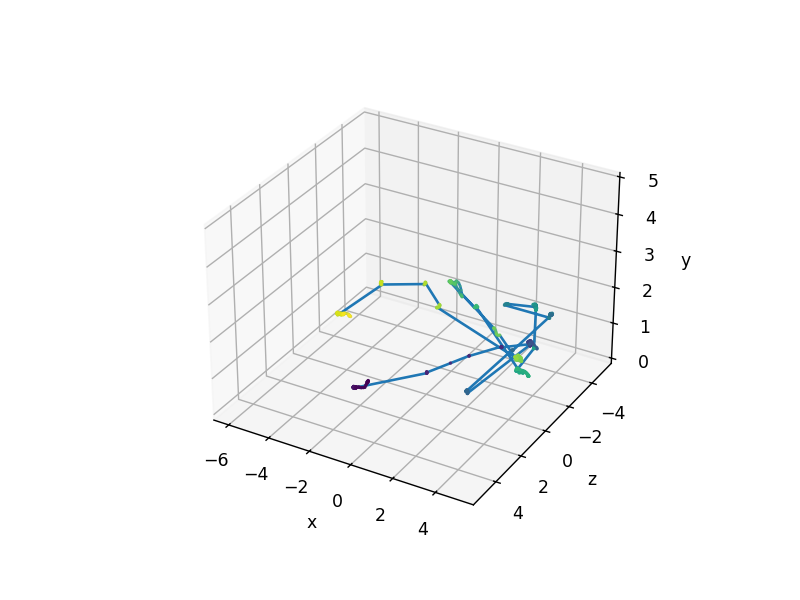

<IPython.core.display.Javascript object>


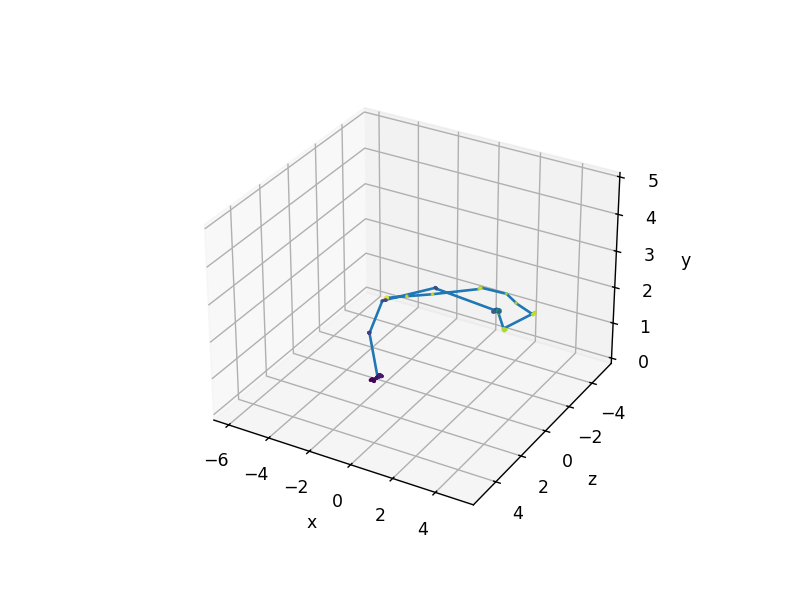

<IPython.core.display.Javascript object>


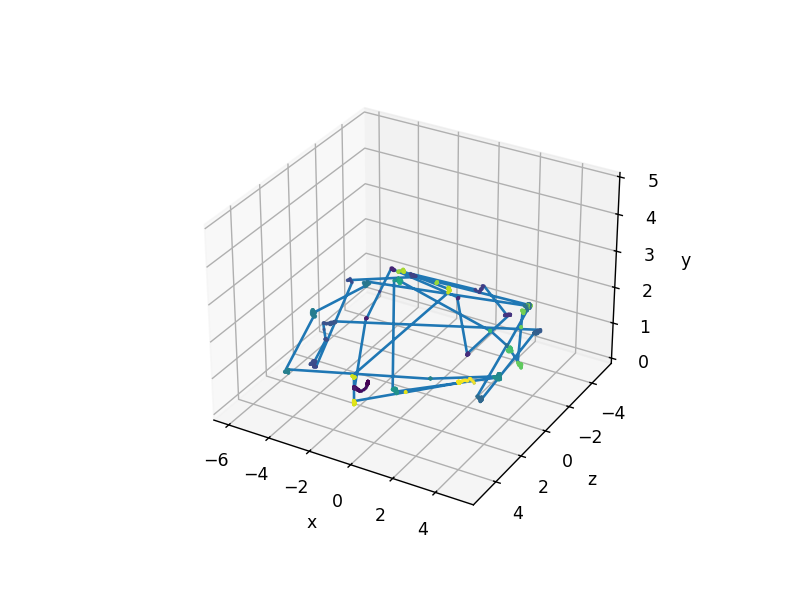

<IPython.core.display.Javascript object>


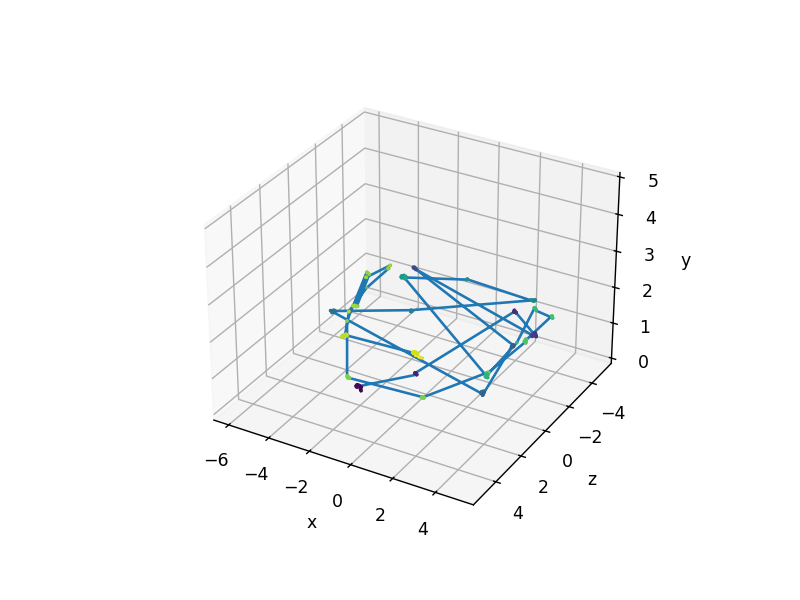

<IPython.core.display.Javascript object>


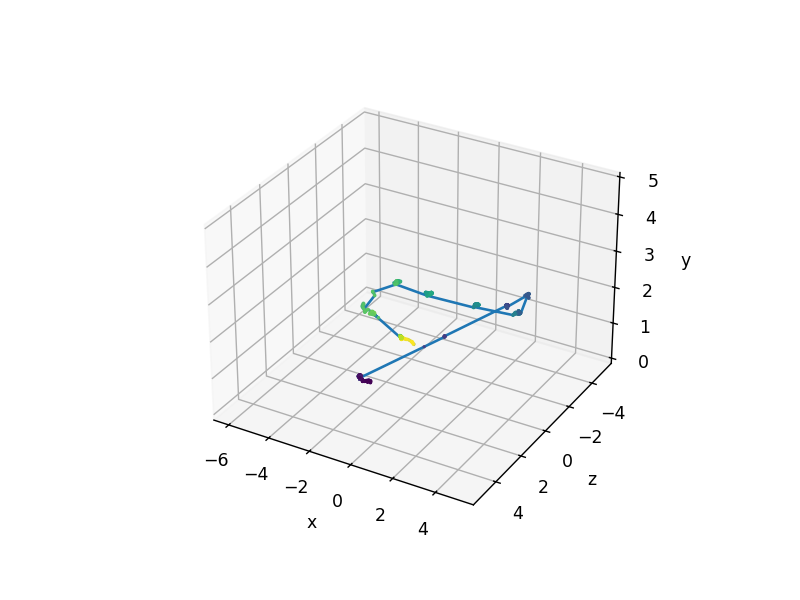

<IPython.core.display.Javascript object>


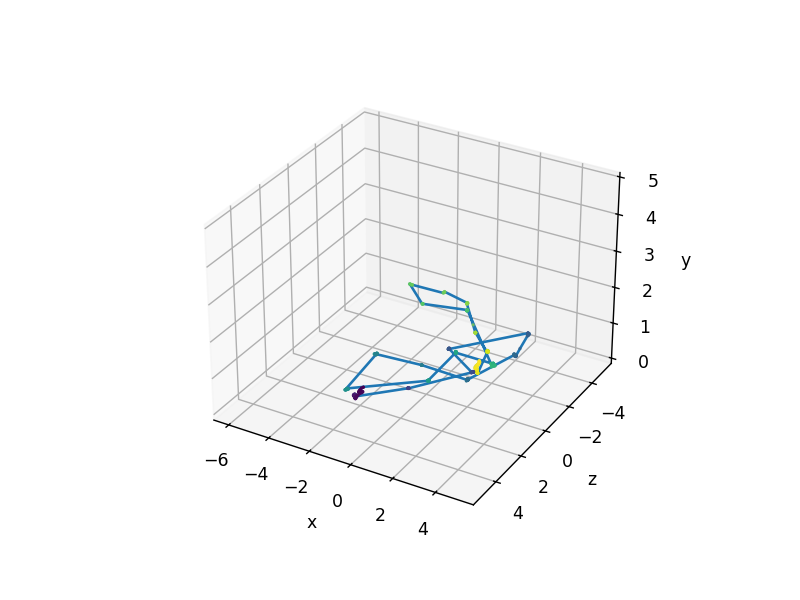

<IPython.core.display.Javascript object>


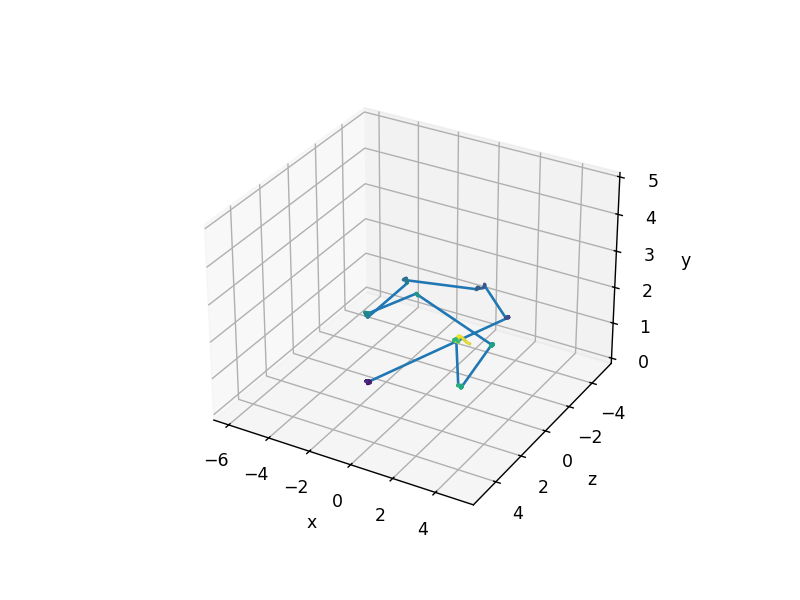

<IPython.core.display.Javascript object>


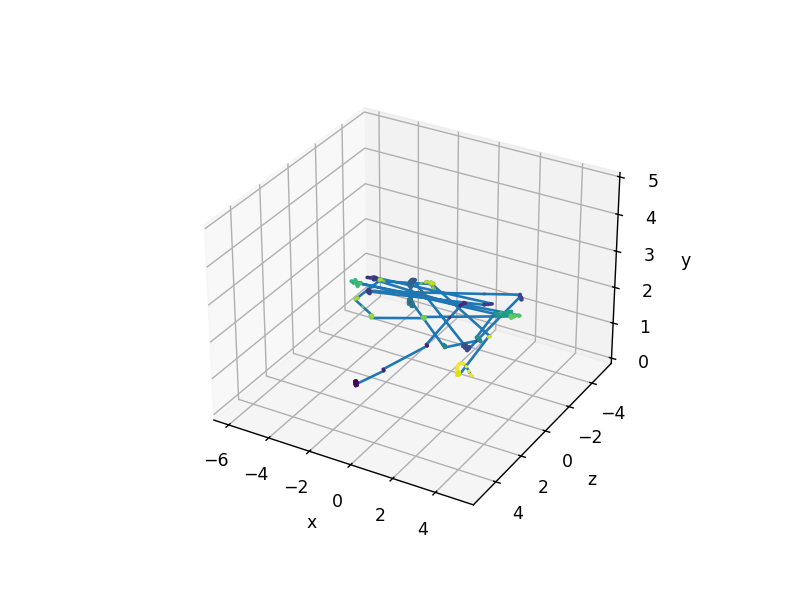

<IPython.core.display.Javascript object>


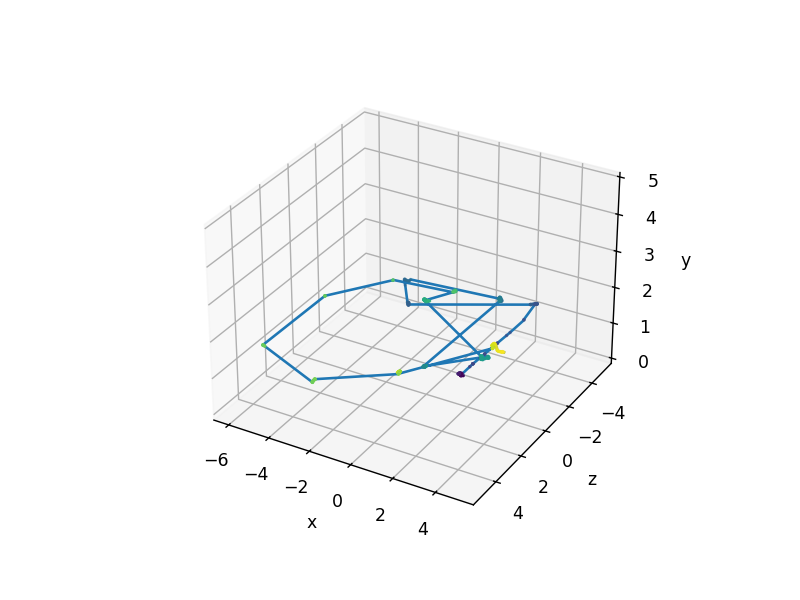

<IPython.core.display.Javascript object>


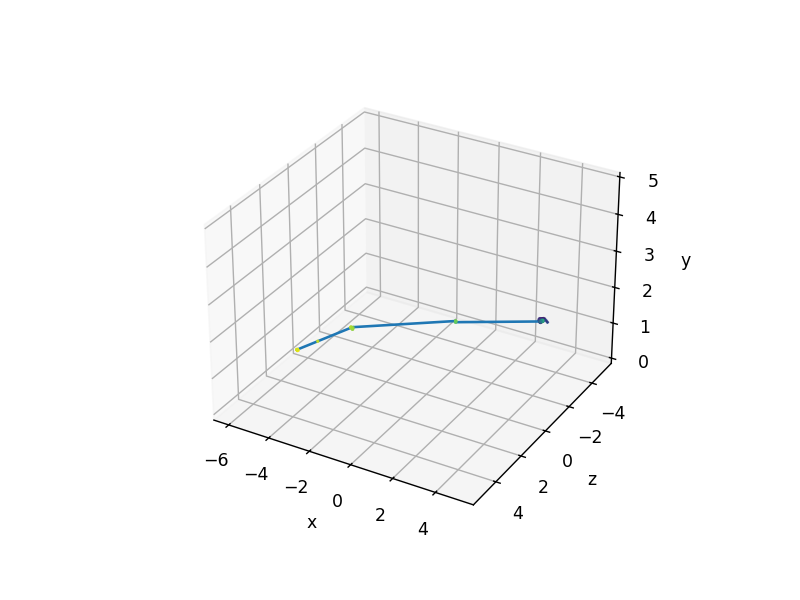

<IPython.core.display.Javascript object>


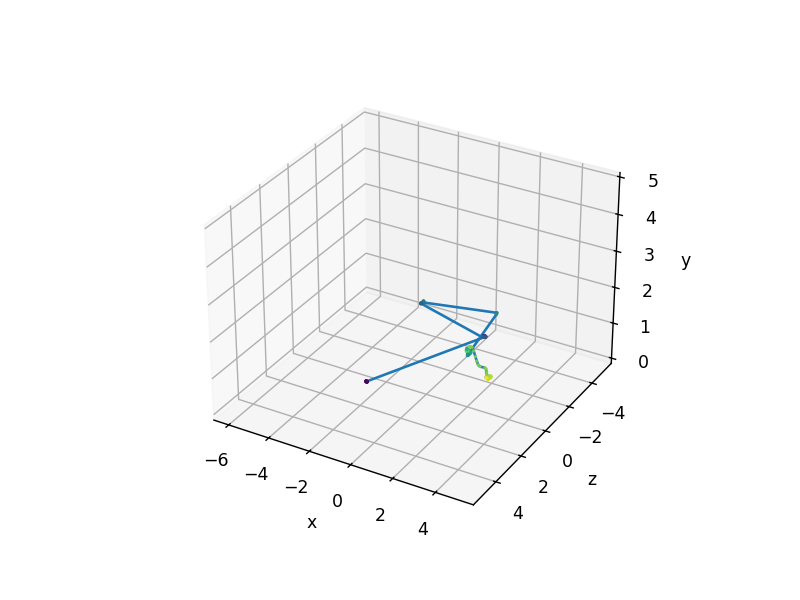

<IPython.core.display.Javascript object>


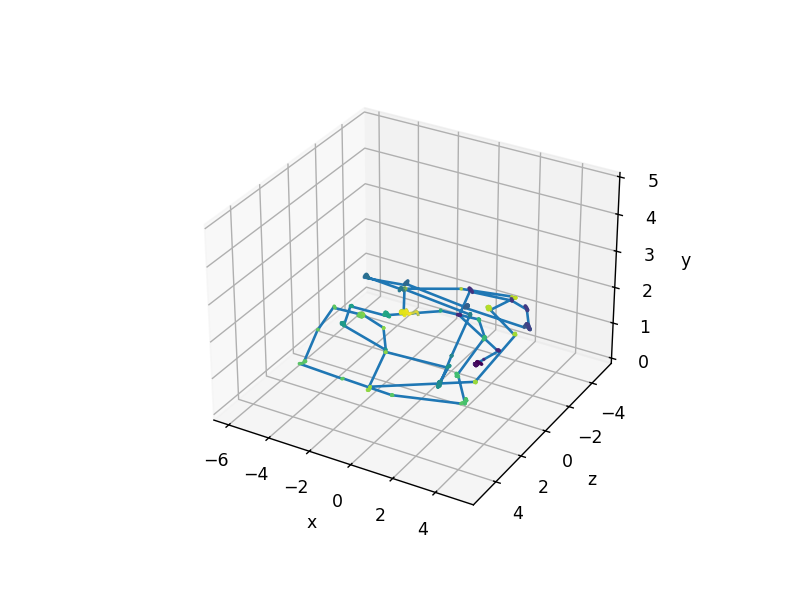

<IPython.core.display.Javascript object>


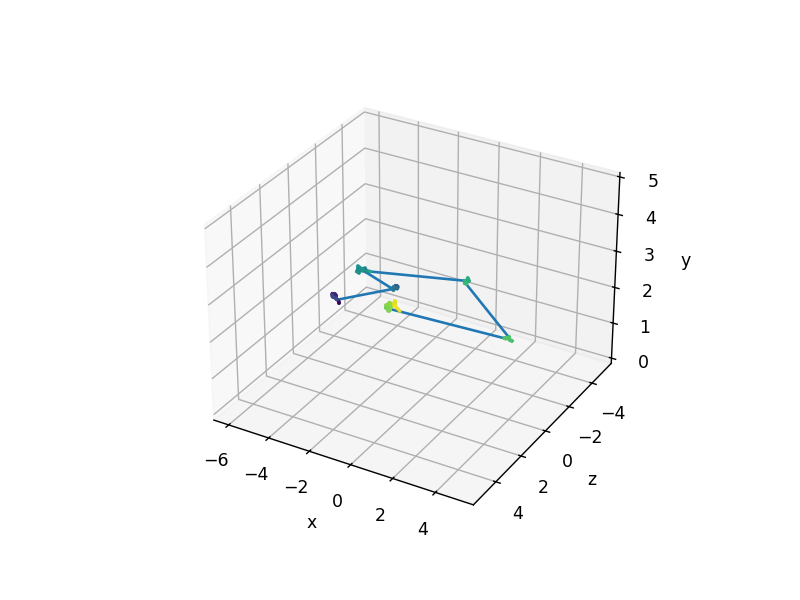

<IPython.core.display.Javascript object>


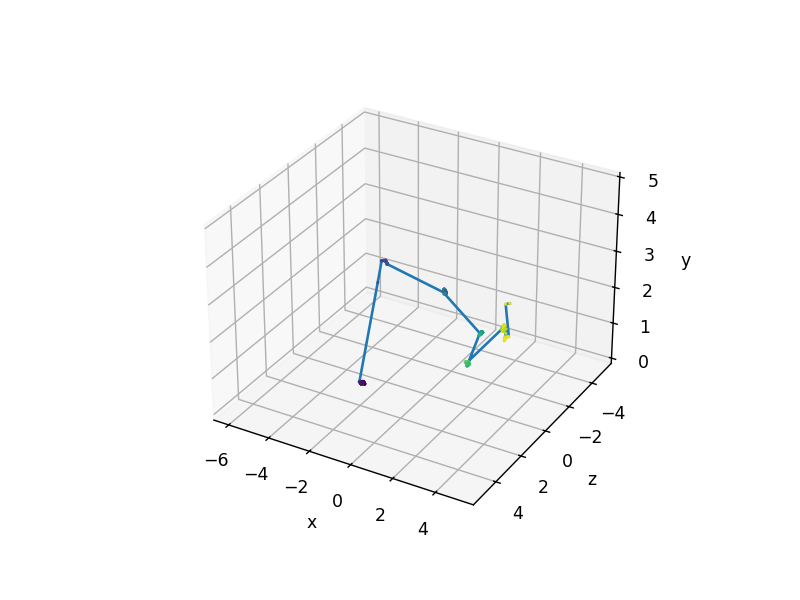

<IPython.core.display.Javascript object>


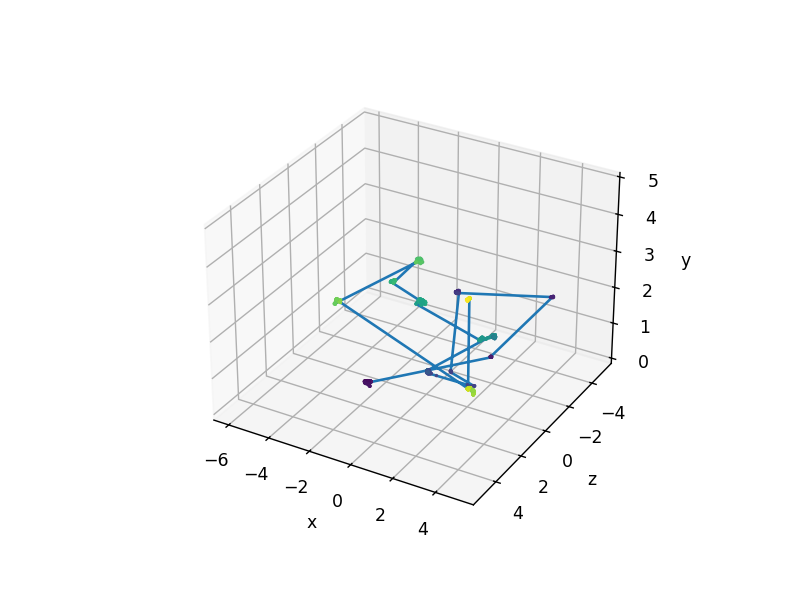

<IPython.core.display.Javascript object>


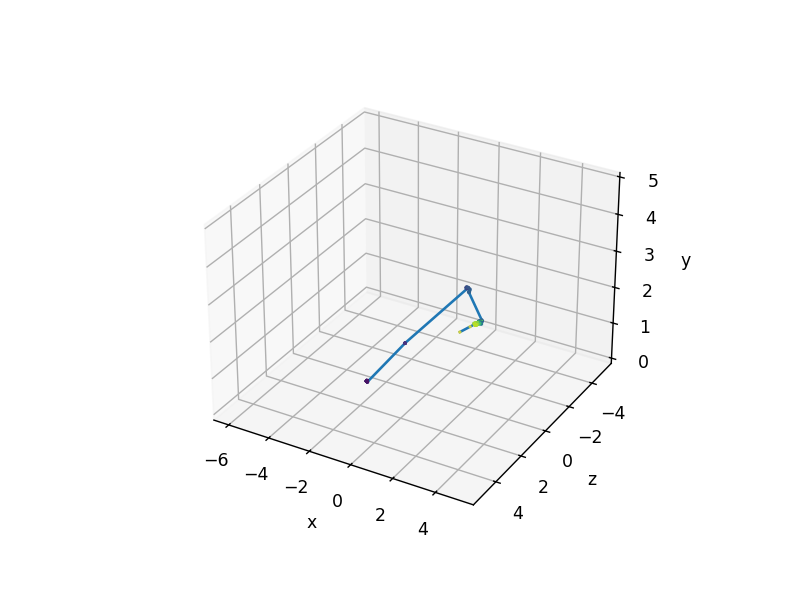

<IPython.core.display.Javascript object>


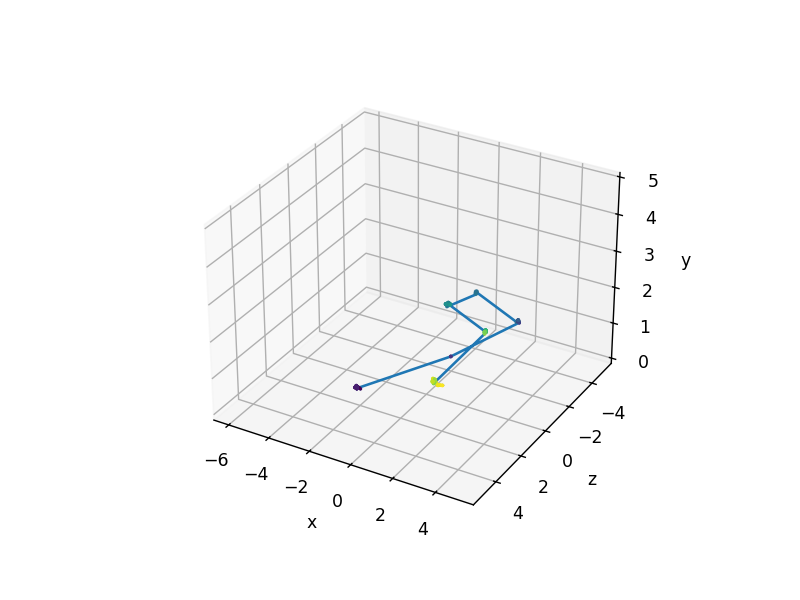

<IPython.core.display.Javascript object>


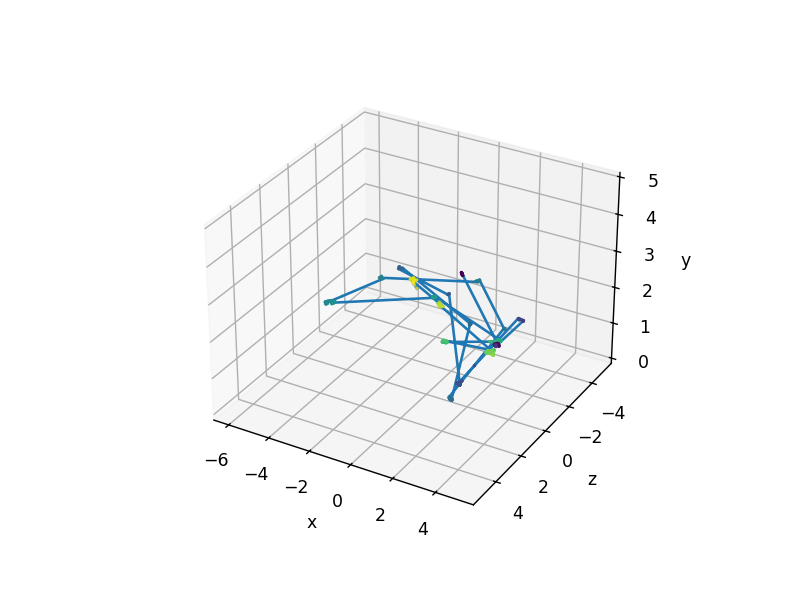

<IPython.core.display.Javascript object>


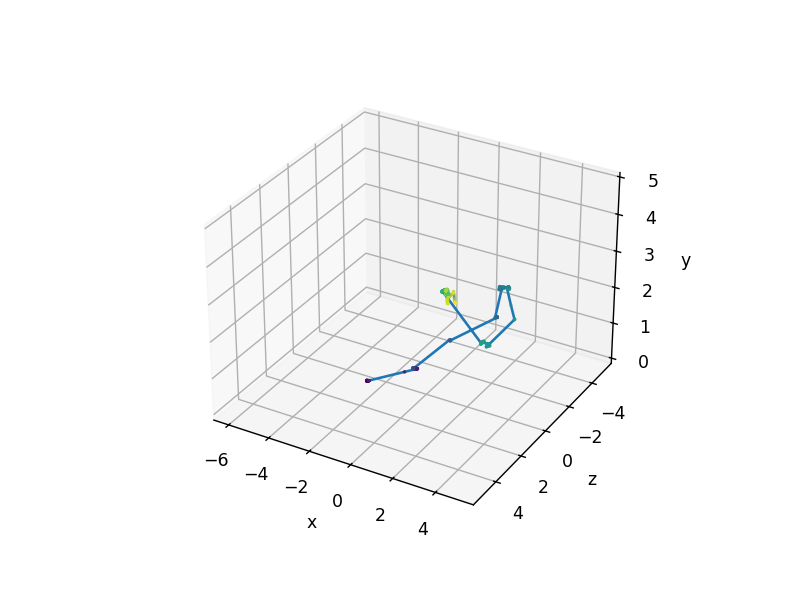

<IPython.core.display.Javascript object>


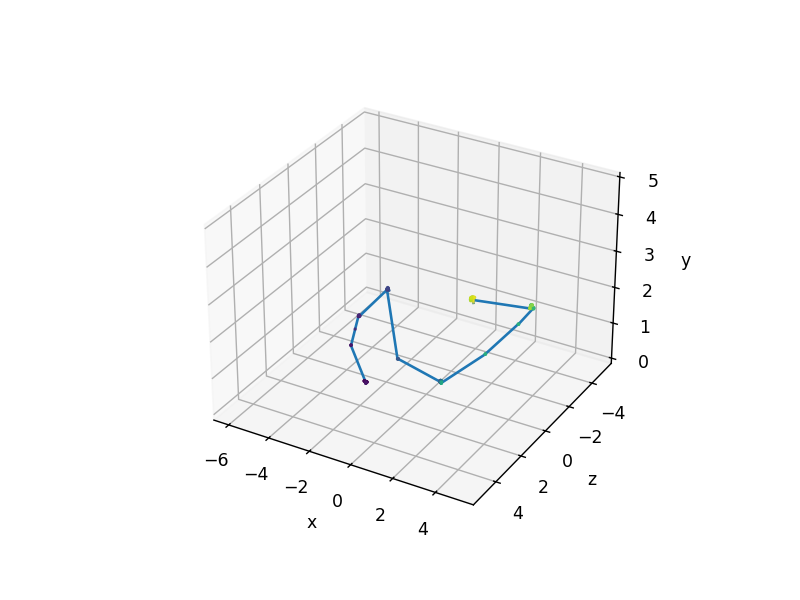

<IPython.core.display.Javascript object>


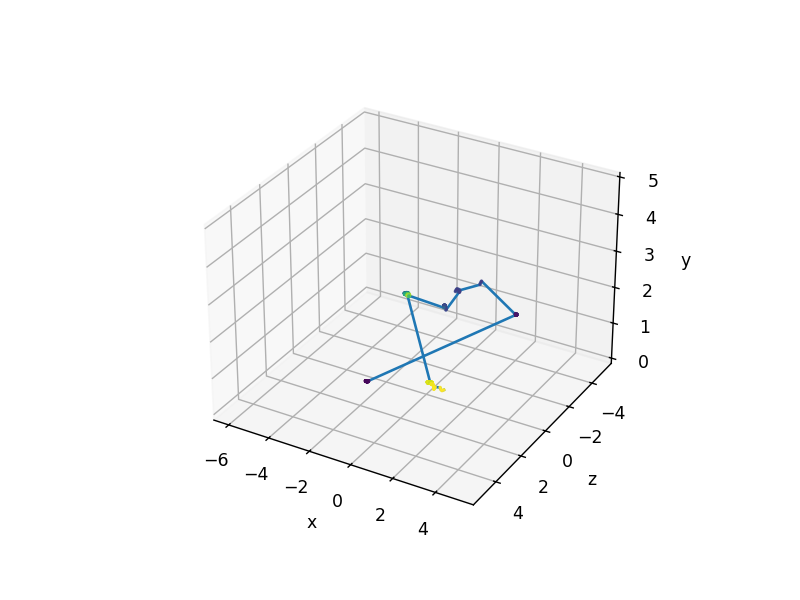

<IPython.core.display.Javascript object>


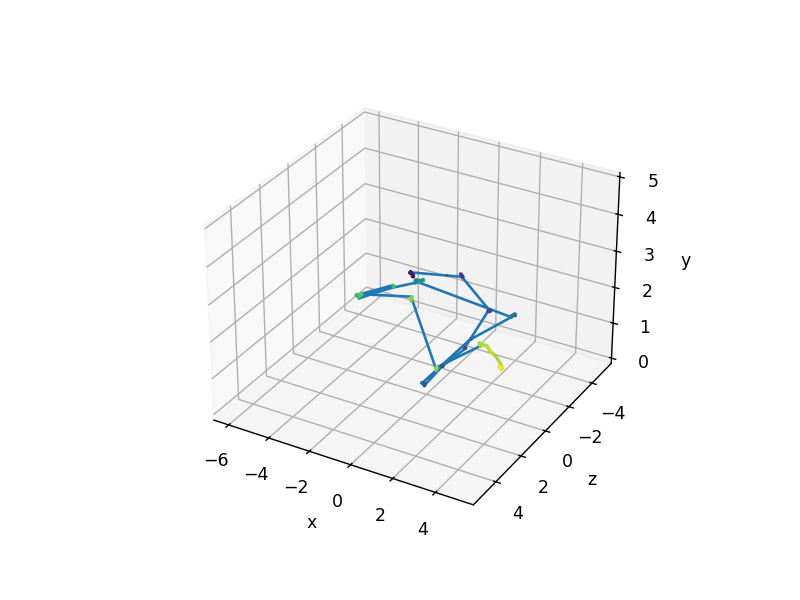

<IPython.core.display.Javascript object>


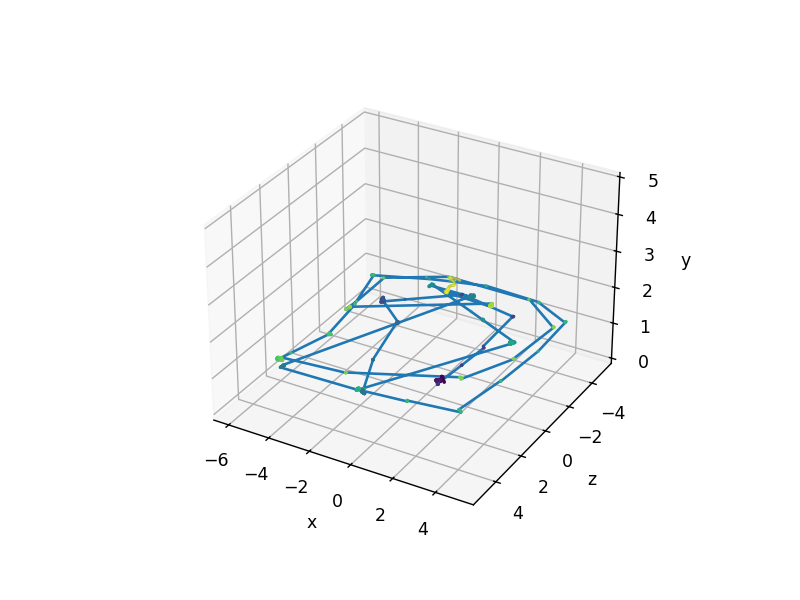

<IPython.core.display.Javascript object>


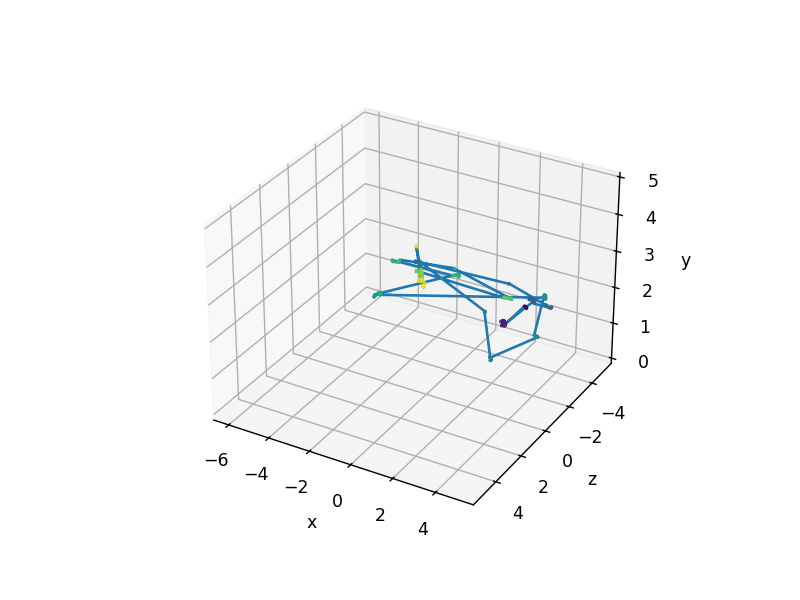

<IPython.core.display.Javascript object>


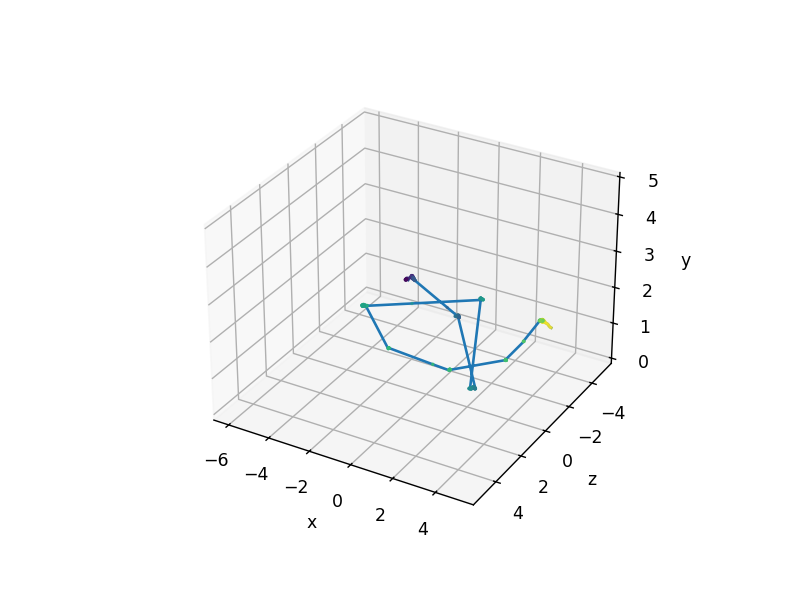

<IPython.core.display.Javascript object>


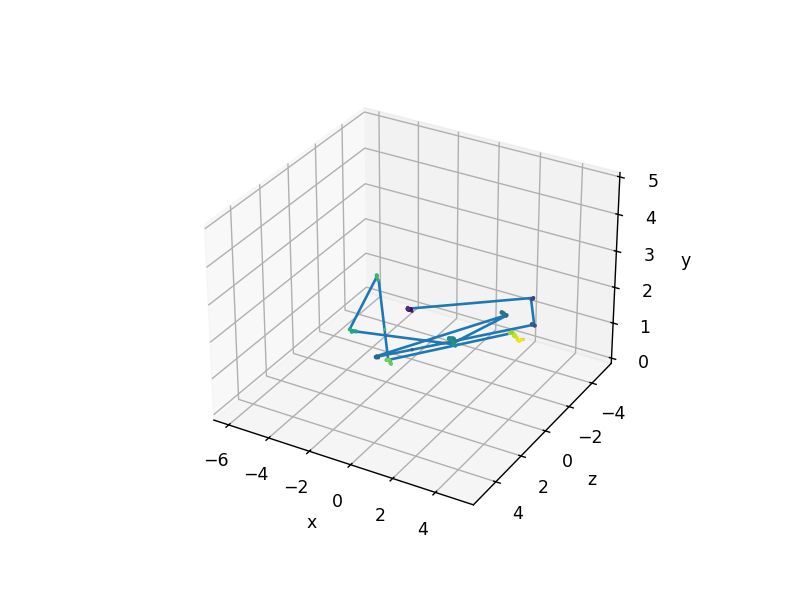

<IPython.core.display.Javascript object>


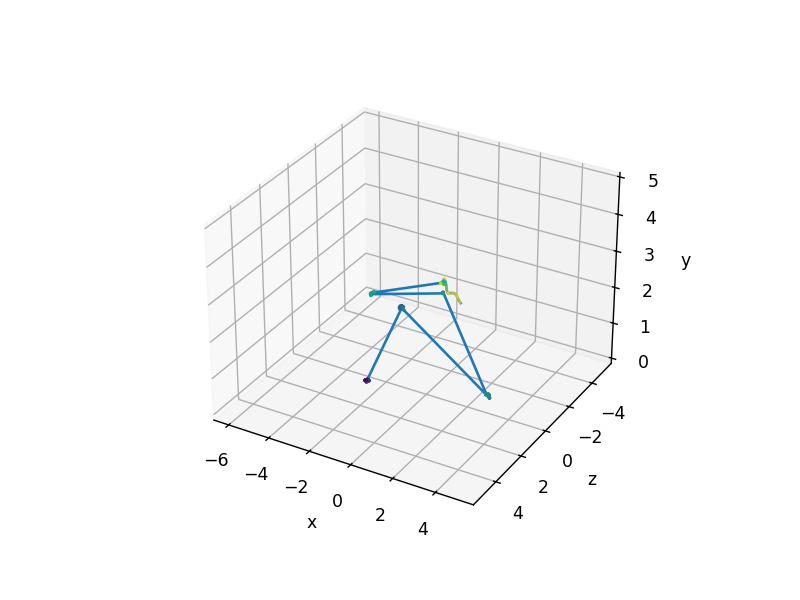

In [18]:
for uId in ids:
    path = paths[uId] #ts[uId],xs[uId],ys[uId],zs[uId]
    #dpath = dpaths[uId]
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    tsi.drawPath(path, dpath=None, BBox=bbox,ax=ax)
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))
    #plt.stop()

In [197]:
len(ids)

32

## 3D Clustering

<IPython.core.display.Javascript object>


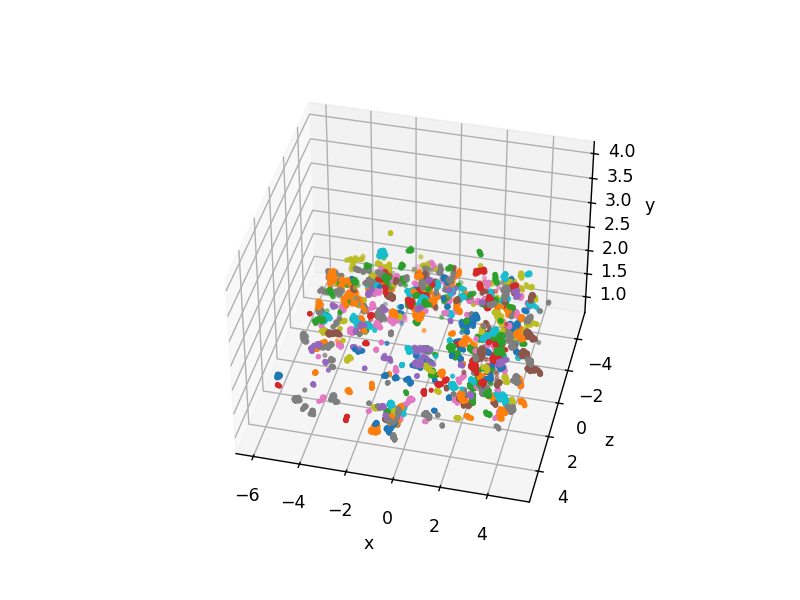

(-6.5, 5.5)

In [196]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
tsi.allPaths3D(paths,ax=ax)
ax.set_ylim((5.5,-5.5))
ax.set_xlim((-6.5,5.5))

<IPython.core.display.Javascript object>


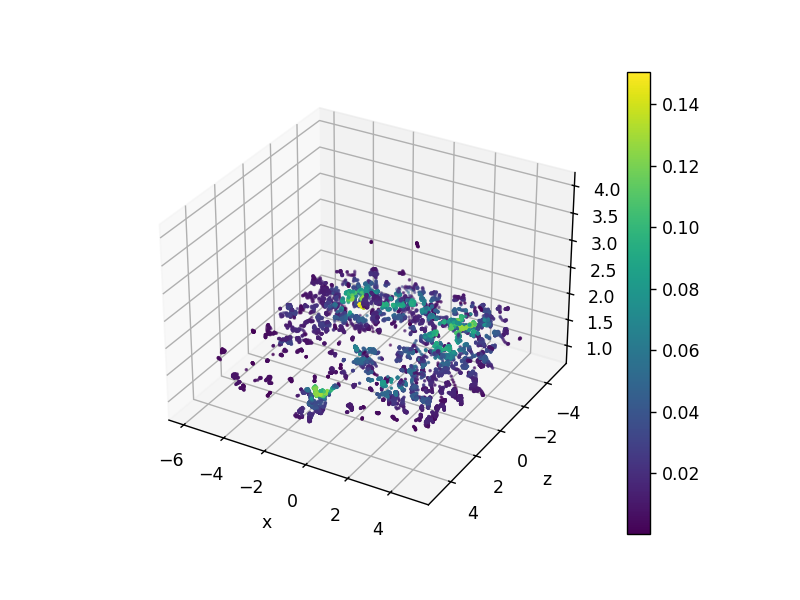

<IPython.core.display.Javascript object>


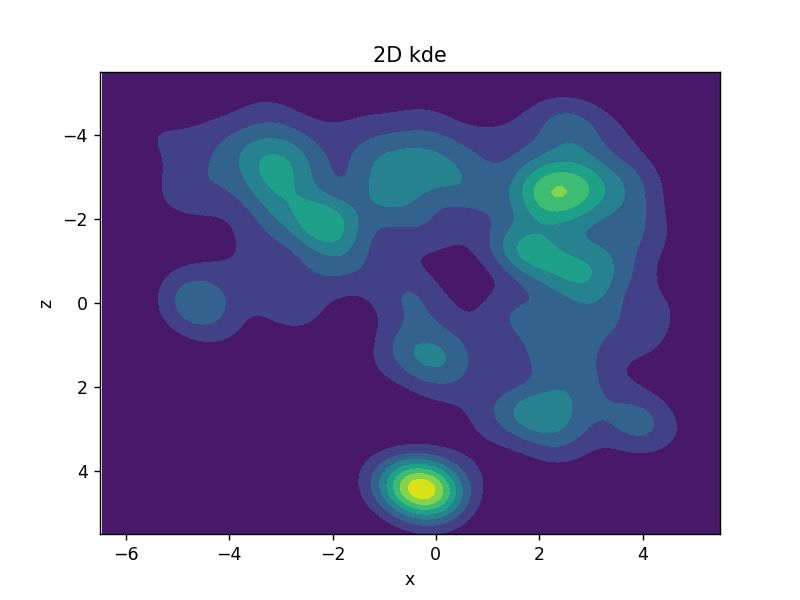

Text(0.5, 1.0, '2D kde')

In [94]:
pathsConc =  np.vstack(paths)
tConv,xConc,yConc,zConc = pathsConc.T#np.concatenate(xs),np.concatenate(ys),np.concatenate(zs)

xyz = np.vstack([xConc,yConc,zConc])
kde = stats.gaussian_kde(xyz)
density = kde(xyz)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')
tsi.plotKDE(xConc,yConc,zConc,density,ax=ax)
ax.set_ylim((5.5,-5.5))
ax.set_xlim((-6.5,5.5))

width = 0.1

pathsConc =  np.vstack(paths)
t,xConc,yConc,zConc = pathsConc.T
xz = np.vstack([xConc,zConc])
kde = stats.gaussian_kde(xz)

xedges, yedges, zedges  = tsi.makeBinsEdges(bbox,width)
Xc, Zc = np.meshgrid((xedges[1:]+xedges[:-1])*0.5, (zedges[1:]+zedges[:-1])*0.5, indexing='xy')
xc, zc = Xc.flatten(), Zc.flatten()
xczc = np.vstack([xc, zc])
density = kde(xczc)

f = np.reshape(density.T, Xc.shape)

fig = plt.figure()
ax = fig.gca()

#sc = plt.scatter(xc[density>th], zc[density>th], c=density[density>th],s=1)
#fig.colorbar(sc, ax=ax)
ax.set_xlabel('x')
ax.set_ylabel('z')
ax.set_ylim((5.5,-5.5))
ax.set_xlim((-6.5,5.5))
#ax.set_xlim((-5,xedges[-1]))#((xedges[0],xedges[-1]))
#ax.set_ylim((zedges[0],zedges[-1]))
cfset = ax.contourf(Xc, Zc, f)
plt.title('2D kde')

<IPython.core.display.Javascript object>


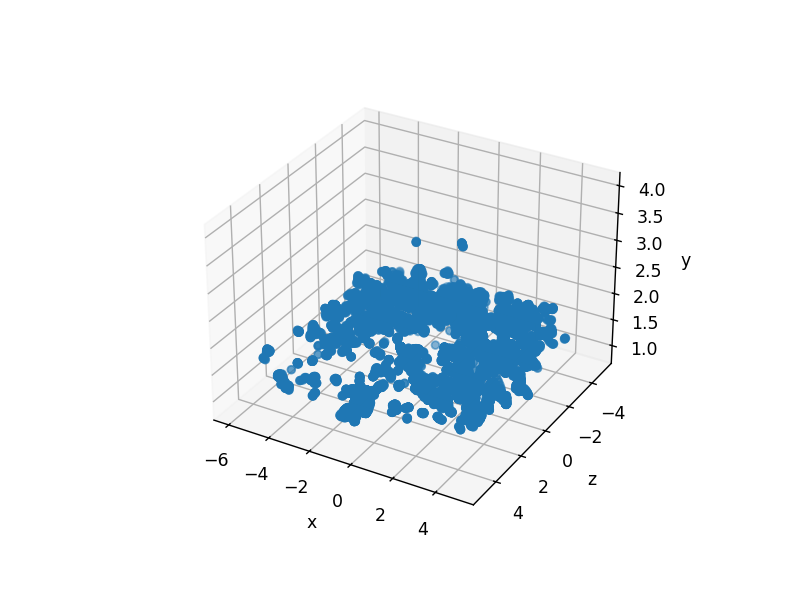

1 [[ 0.15420116  1.58427009 -0.66047882]]


<IPython.core.display.Javascript object>


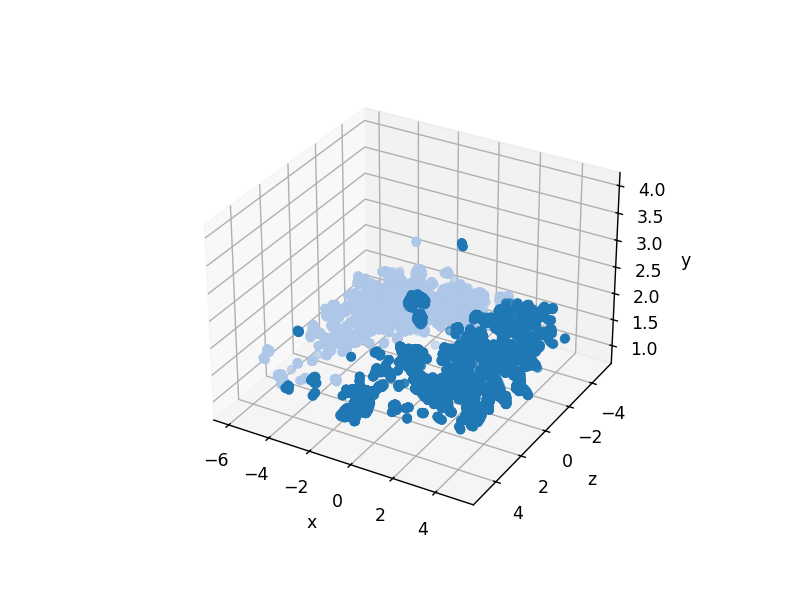

2 [[ 1.81414588  1.60331552  0.36416429]
 [-2.38115481  1.55518061 -2.22549179]]


<IPython.core.display.Javascript object>


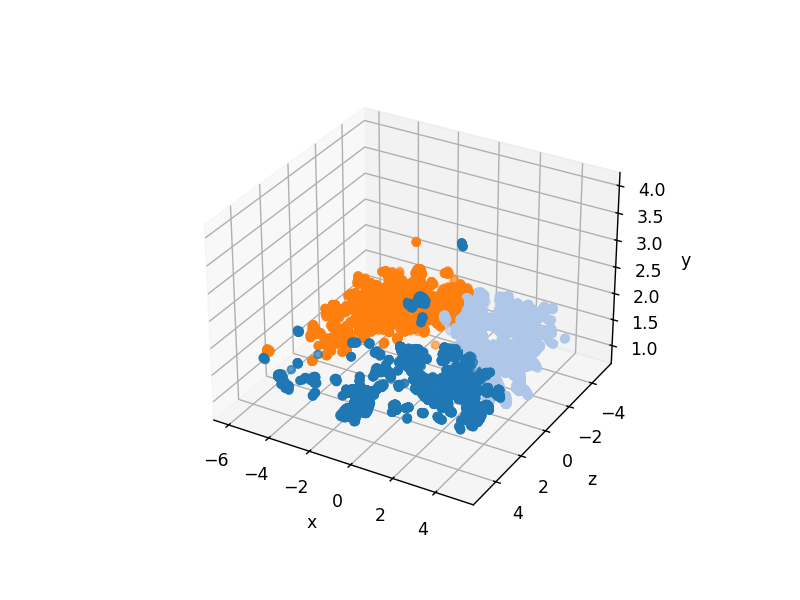

3 [[ 1.00830752  1.60937038  2.64886843]
 [ 2.28047385  1.56941748 -2.1574068 ]
 [-2.71399931  1.57676732 -2.10770635]]


<IPython.core.display.Javascript object>


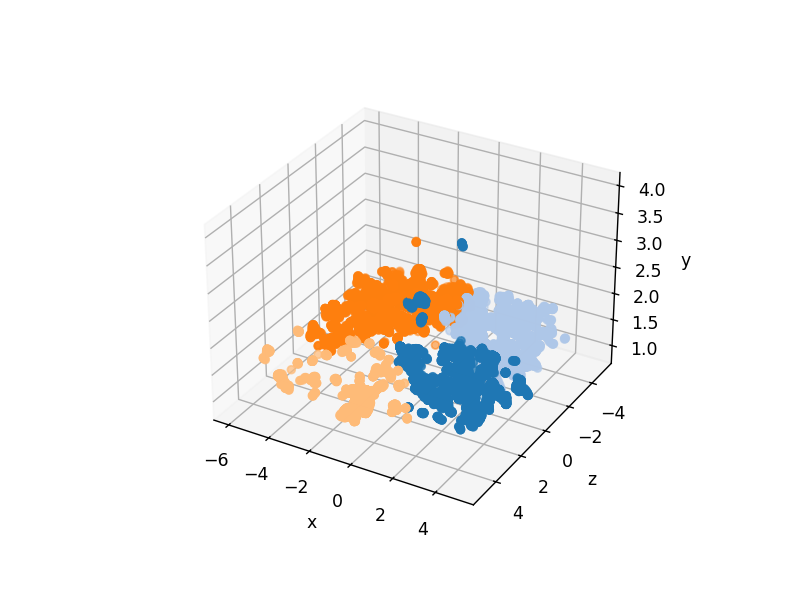

4 [[ 2.06153601  1.61694664  1.53696823]
 [ 2.15621633  1.58180585 -2.4418993 ]
 [-2.71719171  1.57710589 -2.15887029]
 [-0.68951929  1.54355698  4.10692226]]


<IPython.core.display.Javascript object>


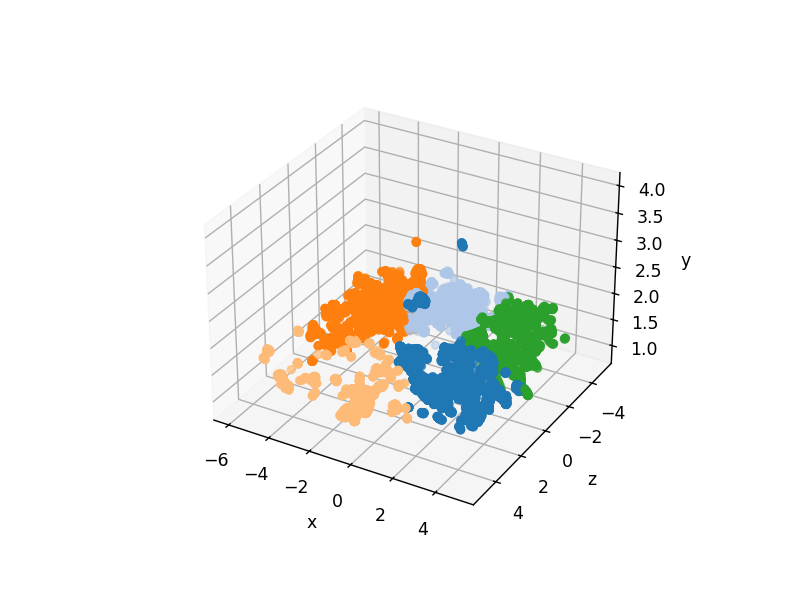

5 [[ 2.03192891  1.6133402   1.64018272]
 [-0.44347875  1.63729477 -2.72852297]
 [-3.36449607  1.5391652  -1.96849474]
 [-0.64482212  1.54681785  4.1399892 ]
 [ 2.66181433  1.5858526  -2.2085419 ]]


<IPython.core.display.Javascript object>


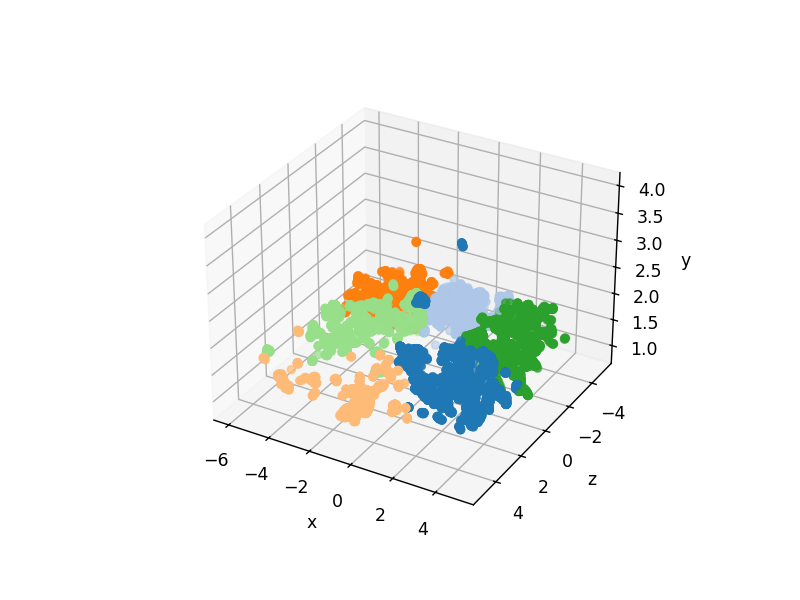

6 [[ 2.0236803   1.6125201   1.6562931 ]
 [-0.27285853  1.58607126 -3.02108459]
 [-3.5250709   1.49653514 -3.26948212]
 [-0.52536808  1.54962652  4.26498095]
 [ 2.68979137  1.58465339 -2.16903762]
 [-2.80909679  1.63936349 -0.57536314]]


<IPython.core.display.Javascript object>


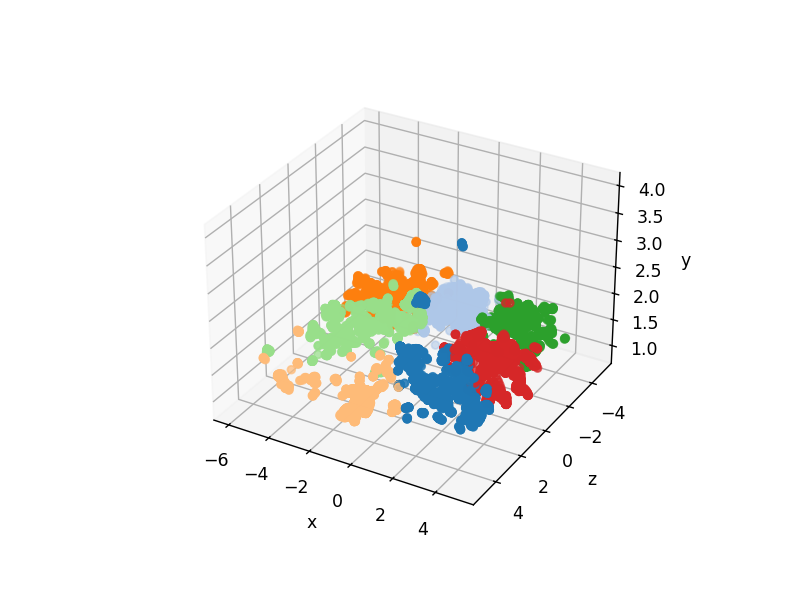

7 [[ 1.78883032  1.64639152  2.00616892]
 [-0.35479412  1.58468953 -2.97093712]
 [-3.52961669  1.49630912 -3.26889026]
 [-0.5541282   1.5488655   4.29051852]
 [ 2.62065684  1.58620378 -3.02117404]
 [-2.81835509  1.63945046 -0.57432725]
 [ 2.74966465  1.55335712 -0.55612958]]


<IPython.core.display.Javascript object>


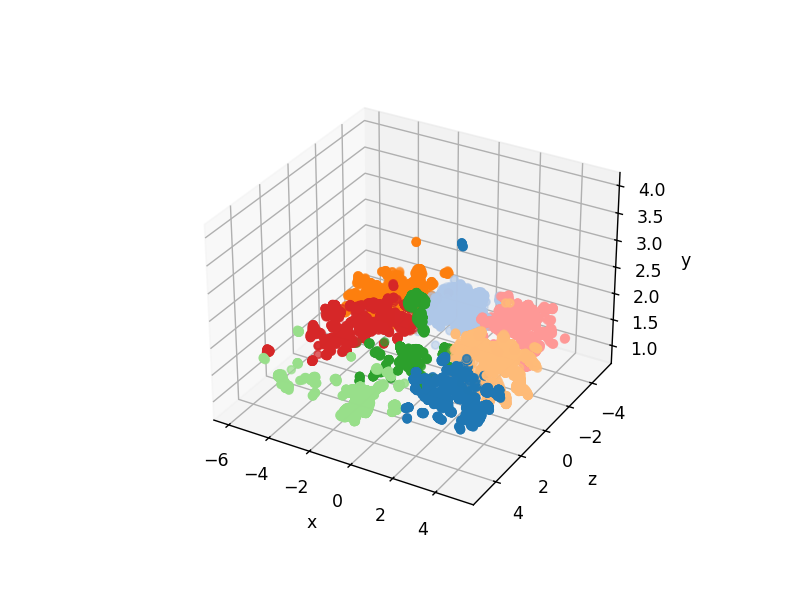

8 [[ 2.65352791  1.58876089  2.3564011 ]
 [-0.35080966  1.58465049 -2.99166869]
 [-3.53219451  1.49487531 -3.2798909 ]
 [ 2.72266288  1.55839524 -0.60303223]
 [-0.17456898  1.80516717  0.86572057]
 [-0.51924118  1.5520542   4.32565593]
 [-3.11253218  1.58590242 -0.68180295]
 [ 2.62233281  1.58630119 -3.0221436 ]]


<IPython.core.display.Javascript object>


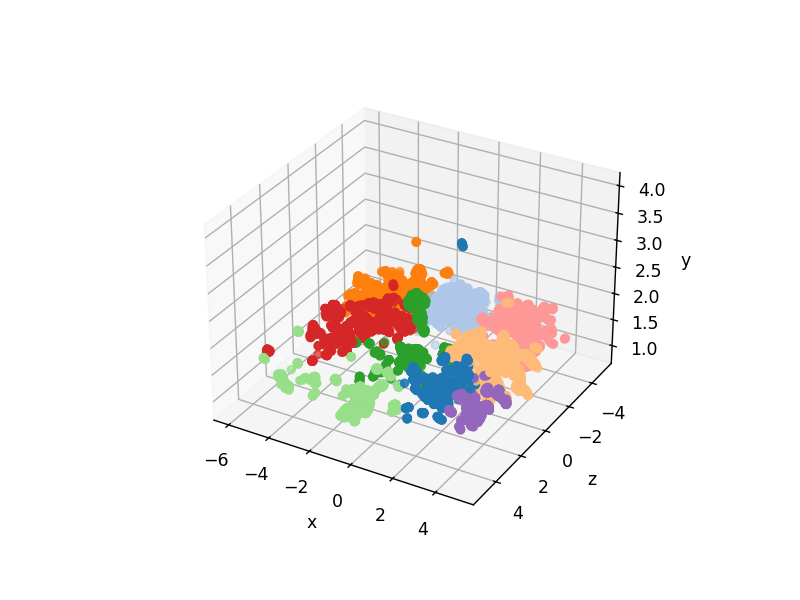

9 [[ 2.13179502  1.61778255  2.28004555]
 [-0.35144191  1.58461384 -2.99276563]
 [-3.53172586  1.49500935 -3.27914019]
 [ 2.68941011  1.56255027 -0.63321017]
 [-0.20085827  1.80751688  0.83220384]
 [-0.52951645  1.55166337  4.33597624]
 [-3.11293589  1.58579089 -0.68164279]
 [ 2.6296844   1.58826813 -3.02983829]
 [ 3.94414097  1.49515419  2.43573128]]


<IPython.core.display.Javascript object>


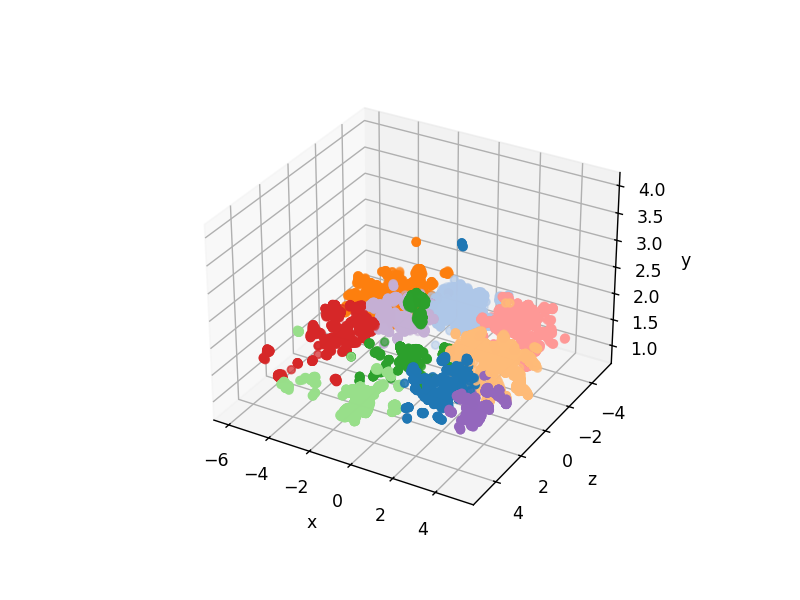

10 [[ 2.14660364  1.6180052   2.2724484 ]
 [-0.24136732  1.57651429 -3.08589701]
 [-3.59296418  1.4934604  -3.32970753]
 [ 2.68750981  1.56284733 -0.6310644 ]
 [-0.19642072  1.81137037  0.86978751]
 [-0.36863239  1.55982787  4.35792213]
 [-4.02612731  1.49395598  0.41358617]
 [ 2.63965074  1.58802784 -3.02465336]
 [ 3.94630939  1.49472928  2.44034144]
 [-2.14725242  1.65009692 -1.62714009]]


<IPython.core.display.Javascript object>


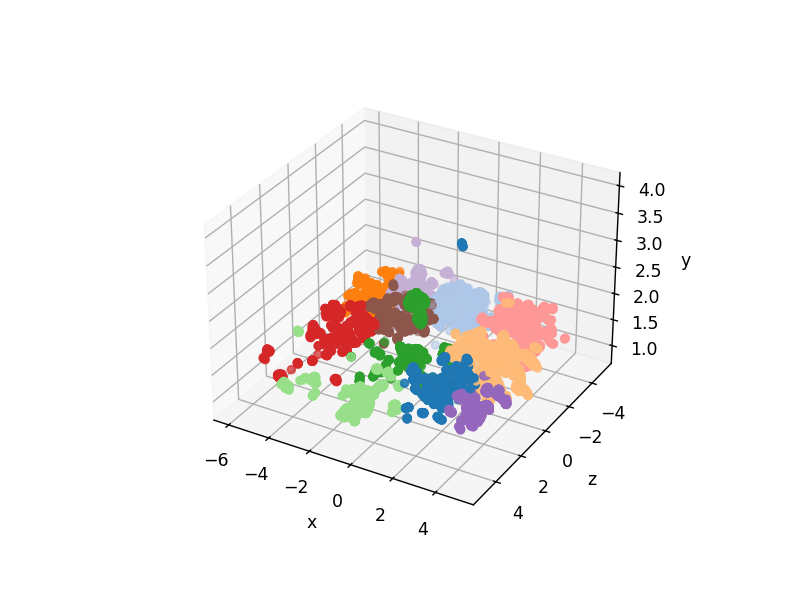

11 [[ 2.14660364  1.6180052   2.2724484 ]
 [-0.19096623  1.57911217 -3.058569  ]
 [-4.67441176  1.37545446 -3.17606262]
 [ 2.68988904  1.56255562 -0.62997253]
 [-0.19556592  1.81133792  0.86956076]
 [-0.36863239  1.55982787  4.35792213]
 [-4.02510107  1.49404875  0.41340687]
 [ 2.64761025  1.58868233 -3.02773435]
 [ 3.94666297  1.49529933  2.44616741]
 [-2.96887167  1.5514     -3.43550121]
 [-2.1391563   1.65018389 -1.63249124]]


<IPython.core.display.Javascript object>


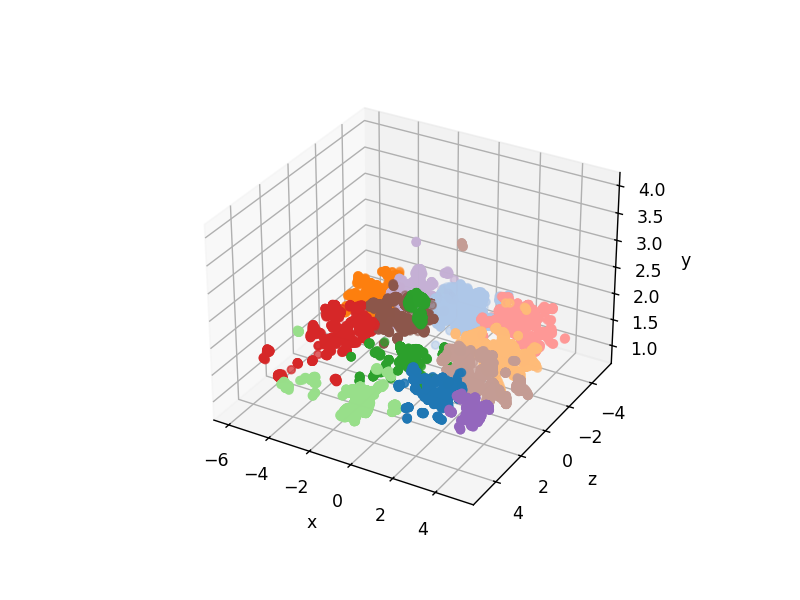

12 [[ 2.04393876  1.59315425  2.65133449]
 [-0.19430029  1.57881744 -3.05777248]
 [-4.67441176  1.37545446 -3.17606262]
 [ 2.64229382  1.58658477 -1.16480603]
 [-0.21860352  1.81296356  0.87677781]
 [-0.38813977  1.55889121  4.3849205 ]
 [-4.02612731  1.49395598  0.41358617]
 [ 2.62582883  1.59077339 -3.10935456]
 [ 3.92139601  1.53344729  2.85454416]
 [-2.96887167  1.5514     -3.43550121]
 [-2.13964229  1.65015762 -1.6313958 ]
 [ 2.78202387  1.5495634   0.69297452]]


<IPython.core.display.Javascript object>


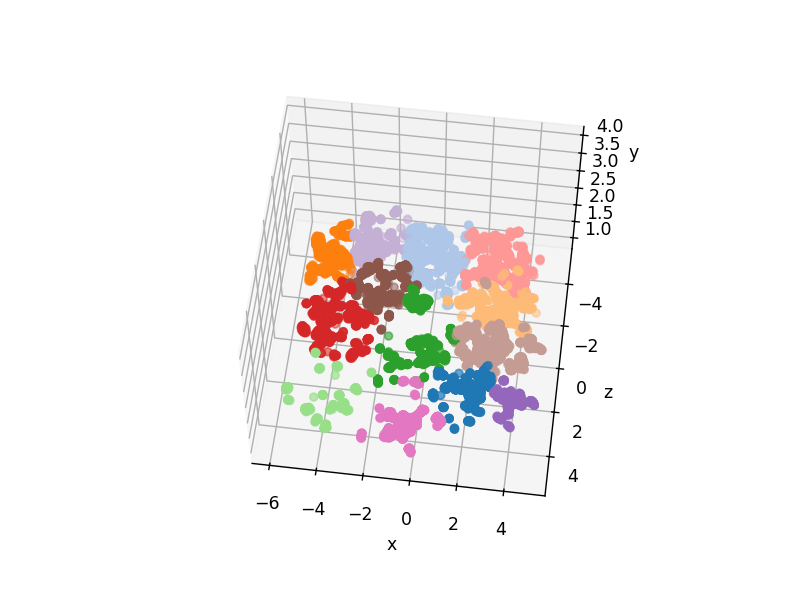

13 [[ 2.04393876  1.59315425  2.65133449]
 [-0.19297259  1.57868281 -3.0587176 ]
 [-4.67647954  1.3748706  -3.18052331]
 [ 2.64211215  1.58657513 -1.16546513]
 [-0.21465081  1.8133208   0.87230382]
 [-4.01022305  1.45464684  3.51788104]
 [-3.97577073  1.5092228   0.05704103]
 [ 2.62582883  1.59077339 -3.10935456]
 [ 3.92139601  1.53344729  2.85454416]
 [-2.96887167  1.5514     -3.43550121]
 [-2.11597824  1.64980462 -1.63977398]
 [ 2.78213612  1.54961351  0.69203962]
 [-0.27148698  1.55907906  4.39004778]]


<IPython.core.display.Javascript object>


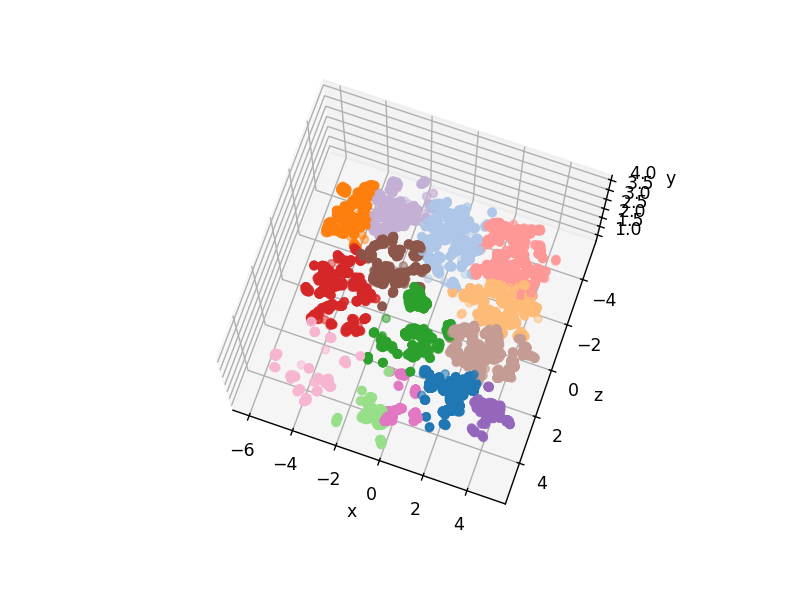

14 [[ 2.08413428  1.59289958  2.63888889]
 [-0.19297259  1.57868281 -3.0587176 ]
 [-4.67647954  1.3748706  -3.18052331]
 [ 2.64211215  1.58657513 -1.16546513]
 [-0.21482336  1.81386315  0.86764946]
 [-0.53457451  1.48387538  4.43240881]
 [-3.97608555  1.50907971  0.05790107]
 [ 2.62582883  1.59077339 -3.10935456]
 [ 3.92139601  1.53344729  2.85454416]
 [-2.96887167  1.5514     -3.43550121]
 [-2.1165881   1.64984021 -1.63960985]
 [ 2.78213612  1.54961351  0.69203962]
 [ 0.10418095  1.65657363  4.26761309]
 [-4.01022305  1.45464684  3.51788104]]


In [55]:
X = xyz.T

sses = []
sses_n_cls = []

silhouette_scores = []
silhouette_scores_n_cls = []

calinski_harabasz_score = []
calinski_harabasz_scores_n_cls = []

davies_bouldin_scores = []
davies_bouldin_scores_n_cls = []

for n_cl in range(1,15):
    kmeans = KMeans(n_clusters=n_cl, **common_params)
    labels = kmeans.fit_predict(X)
    
    plot_3D_KMeans_results(X,kmeans)

    sse = kmeans.inertia_ 
    sses.append(sse)
    sses_n_cls.append(n_cl)

    if n_cl>1:
        sil = metrics.silhouette_score(X, labels, metric='euclidean')
        silhouette_scores.append(sil)
        silhouette_scores_n_cls.append(n_cl)
        ch = metrics.calinski_harabasz_score(X, labels)
        calinski_harabasz_score.append(ch)
        calinski_harabasz_scores_n_cls.append(n_cl)
        db = metrics.davies_bouldin_score(X, labels)
        davies_bouldin_scores.append(db)
        davies_bouldin_scores_n_cls.append(n_cl)

<IPython.core.display.Javascript object>


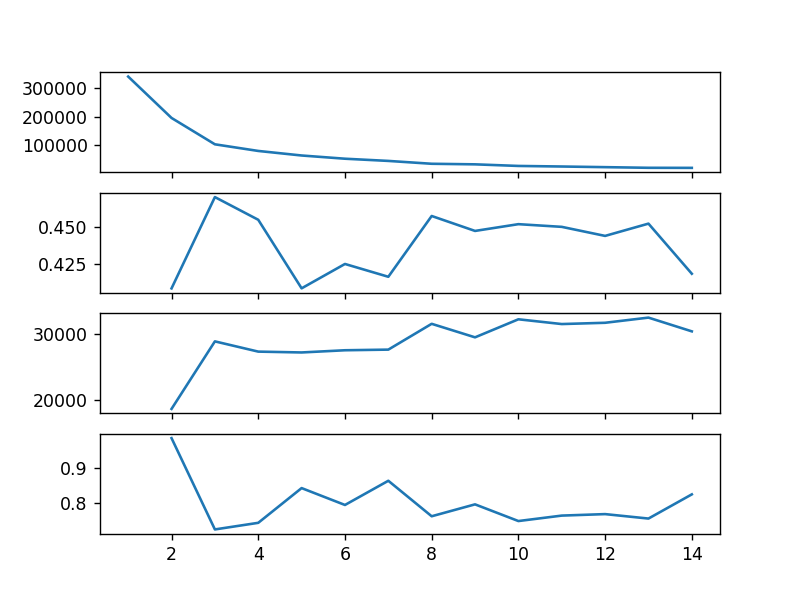

In [21]:
fig, (ax0,ax1,ax2,ax3) = plt.subplots(4,sharex=True)

ax0.plot(sses_n_cls,sses)
ax1.plot(silhouette_scores_n_cls,silhouette_scores) # The best value is 1 and the worst value is -1. Values near 0 indicate overlapping clusters.
ax2.plot(calinski_harabasz_scores_n_cls,calinski_harabasz_score) # The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster.
ax3.plot(davies_bouldin_scores_n_cls,davies_bouldin_scores) # Zero is the lowest possible score. Values closer to zero indicate a better partition.


<IPython.core.display.Javascript object>


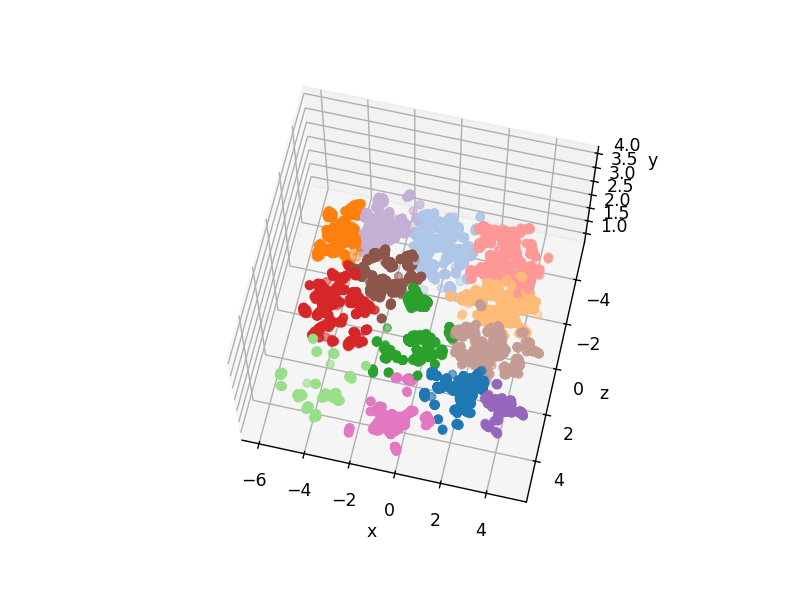

14 [[ 2.04393876  1.59315425  2.65133449]
 [-0.19297259  1.57868281 -3.0587176 ]
 [-4.67647954  1.3748706  -3.18052331]
 [ 2.64211215  1.58657513 -1.16546513]
 [-0.21465081  1.8133208   0.87230382]
 [-4.01022305  1.45464684  3.51788104]
 [-3.97577073  1.5092228   0.05704103]
 [ 2.62582883  1.59077339 -3.10935456]
 [ 3.92139601  1.53344729  2.85454416]
 [-2.96887167  1.5514     -3.43550121]
 [-2.11597824  1.64980462 -1.63977398]
 [ 2.78213612  1.54961351  0.69203962]
 [-0.27148698  1.55907906  4.39004778]]


<IPython.core.display.Javascript object>


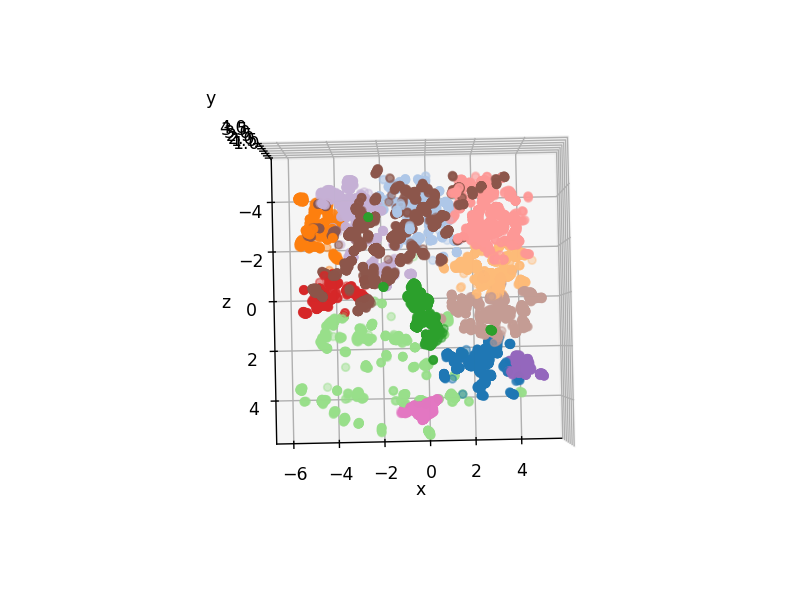

<IPython.core.display.Javascript object>


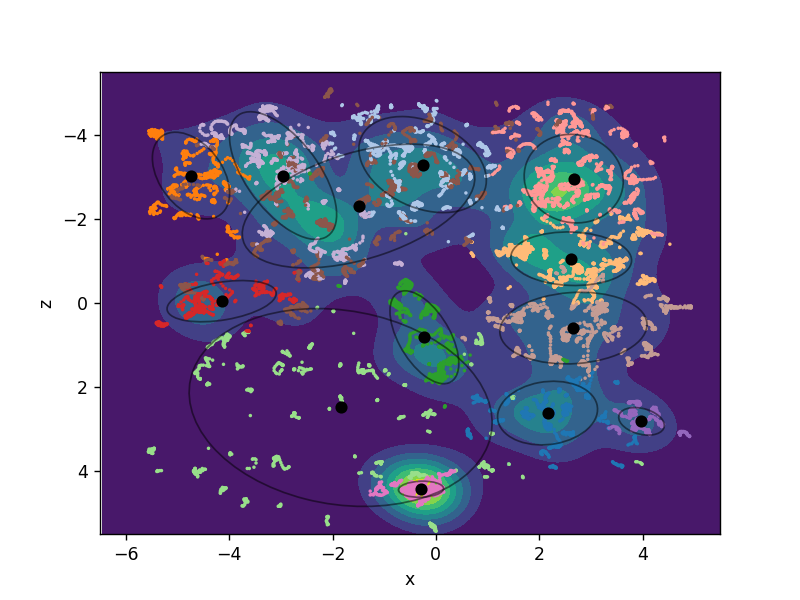

14 [[ 2.16216416  1.59708104  2.62101415]
 [-0.2558253   1.41658698 -3.29567497]
 [-4.73850468  1.3182813  -3.03455544]
 [ 2.62043742  1.60331002 -1.05415175]
 [-0.2215305   1.89980384  0.81552861]
 [-1.84243324  1.46046301  2.48766295]
 [-4.14595406  1.42701998 -0.04367932]
 [ 2.66867706  1.58933005 -2.96128568]
 [ 3.98056233  1.53158298  2.81766896]
 [-2.95653948  1.49650339 -3.03427033]
 [-1.49606547  1.70201343 -2.30869095]
 [ 2.66293549  1.5155964   0.59732785]
 [-0.28685453  1.58342606  4.43406884]]


In [57]:
import matplotlib as mpl
from sklearn.mixture import GaussianMixture

common_params = {
    "n_init": "auto",
    "random_state": random_state,
}

n_classes = 13 #len(np.unique(y_train))

X = xyz.T

kmeans = KMeans(n_clusters=n_classes, **common_params)
labels = kmeans.fit_predict(X)

plot_3D_KMeans_results(X,kmeans)

# Try GMMs using different types of covariances.
gmm = GaussianMixture(n_components=n_classes, covariance_type="full", max_iter=40, random_state=0)
gmm.means_init = kmeans.cluster_centers_
labels = gmm.fit_predict(X)


plot_3D_GMMs_results(X,gmm)
plot_GMM_results(X,Xc,Zc,f,gmm,plane='xz')

## 2D Clustering

<IPython.core.display.Javascript object>


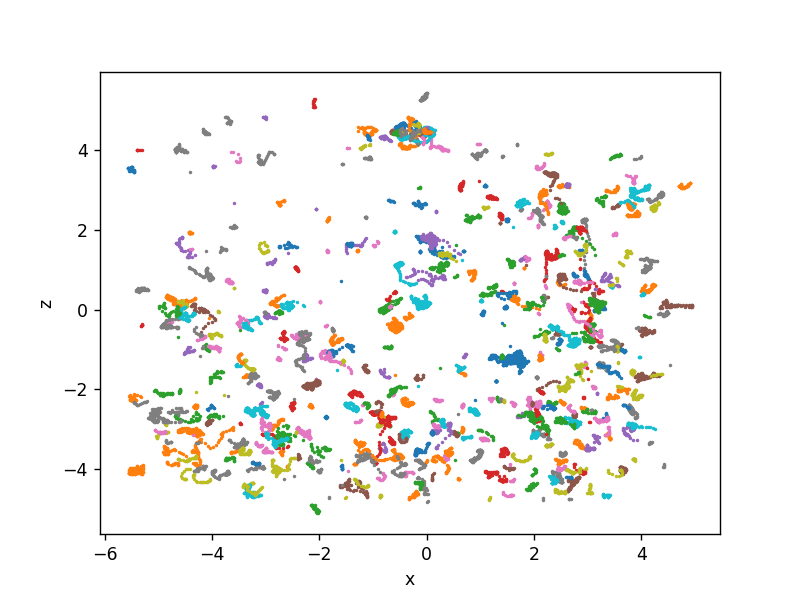

In [58]:
tsi.allPaths2D(paths)

<IPython.core.display.Javascript object>


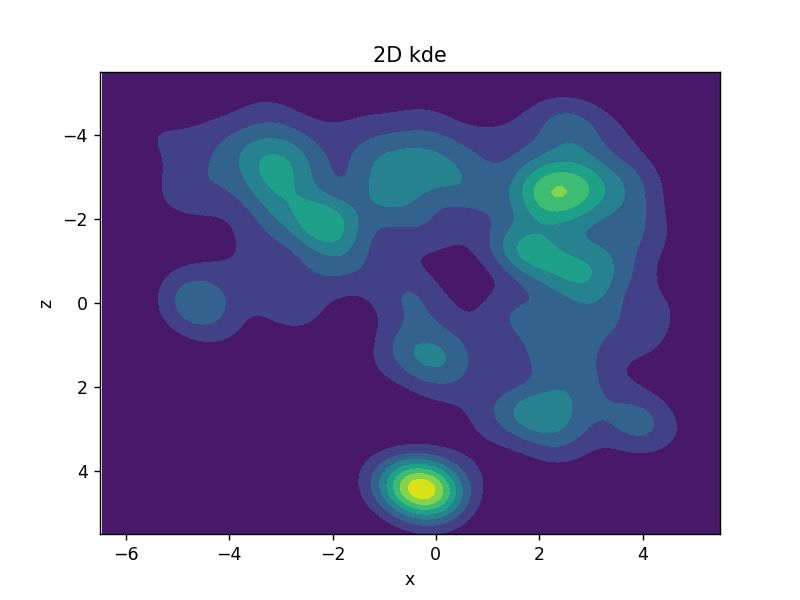

Text(0.5, 1.0, '2D kde')

In [59]:
width = 0.1

pathsConc =  np.vstack(paths)
t,xConc,yConc,zConc = pathsConc.T
xz = np.vstack([xConc,zConc])
kde = stats.gaussian_kde(xz)

xedges, yedges, zedges  = tsi.makeBinsEdges(bbox,width)
Xc, Zc = np.meshgrid((xedges[1:]+xedges[:-1])*0.5, (zedges[1:]+zedges[:-1])*0.5, indexing='xy')
xc, zc = Xc.flatten(), Zc.flatten()
xczc = np.vstack([xc, zc])
density = kde(xczc)

f = np.reshape(density.T, Xc.shape)

fig = plt.figure()
ax = fig.gca()

#sc = plt.scatter(xc[density>th], zc[density>th], c=density[density>th],s=1)
#fig.colorbar(sc, ax=ax)
ax.set_xlabel('x')
ax.set_ylabel('z')
ax.set_ylim((5.5,-5.5))
ax.set_xlim((-6.5,5.5))
#ax.set_xlim((-5,xedges[-1]))#((xedges[0],xedges[-1]))
#ax.set_ylim((zedges[0],zedges[-1]))
cfset = ax.contourf(Xc, Zc, f)
plt.title('2D kde')

1


<IPython.core.display.Javascript object>


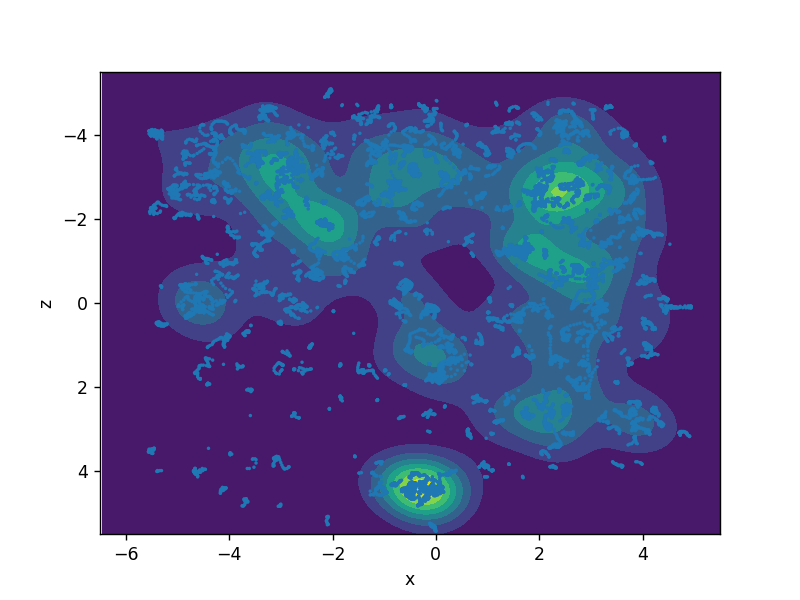

1 [[ 0.15420116 -0.66047882]]
2


<IPython.core.display.Javascript object>


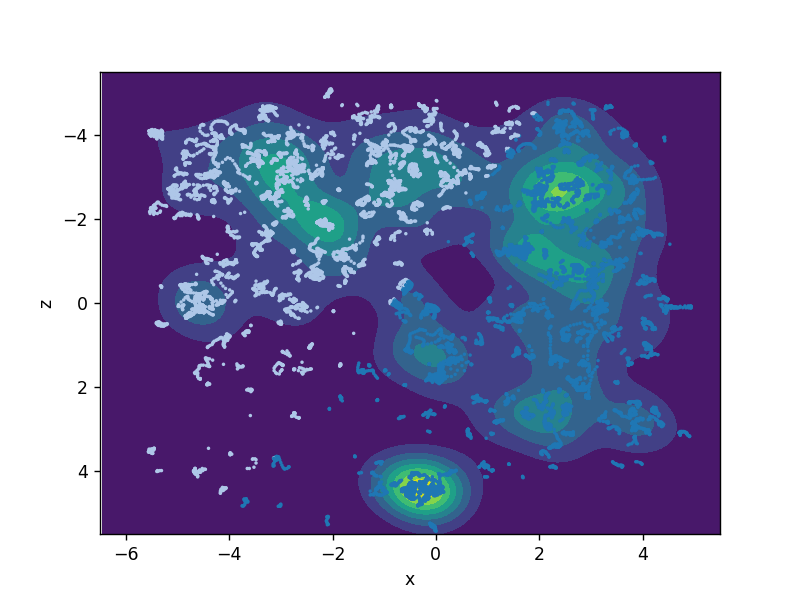

2 [[ 1.81462256  0.3643201 ]
 [-2.3806116  -2.22494514]]
3


<IPython.core.display.Javascript object>


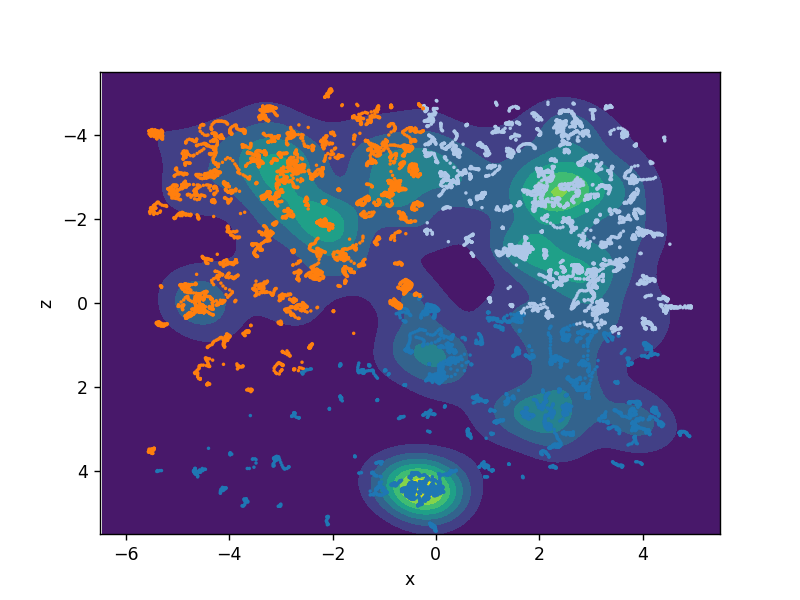

3 [[ 1.01066185  2.64212084]
 [ 2.28014381 -2.16482242]
 [-2.715419   -2.10649835]]
4


<IPython.core.display.Javascript object>


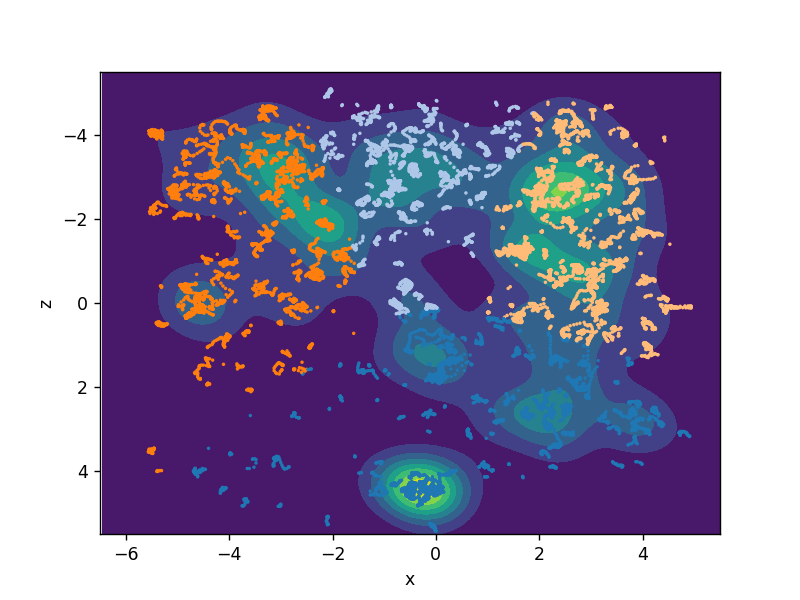

4 [[ 0.90899873  2.85241158]
 [-0.37921727 -2.71217502]
 [-3.37398607 -1.91540694]
 [ 2.71668443 -1.74156927]]
5


<IPython.core.display.Javascript object>


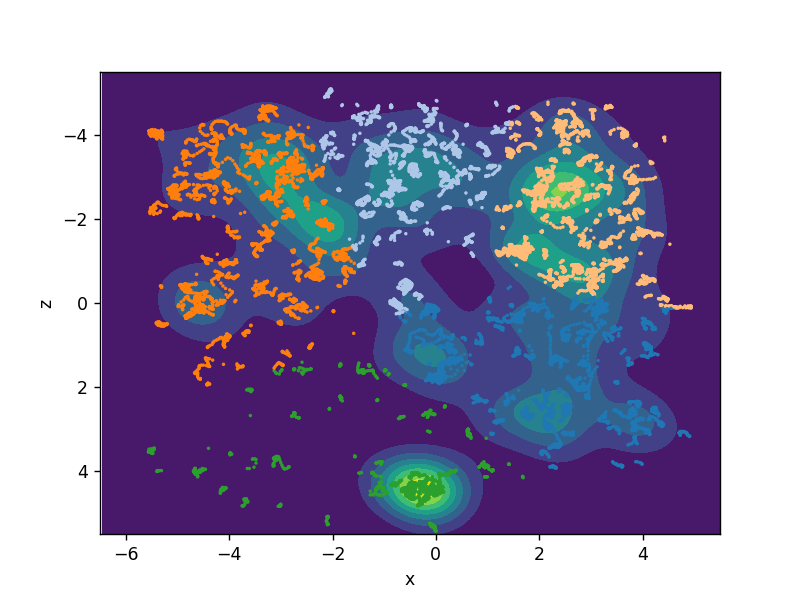

5 [[ 2.01455565  1.64927646]
 [-0.43502337 -2.73813956]
 [-3.36449607 -1.96849474]
 [ 2.67537608 -2.19008253]
 [-0.64482212  4.1399892 ]]
6


<IPython.core.display.Javascript object>


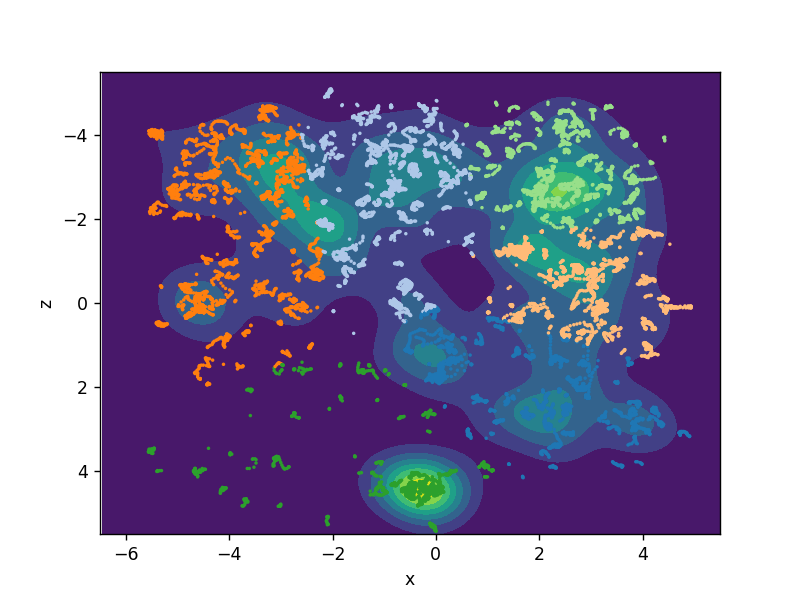

6 [[ 1.81483634  2.0442125 ]
 [-0.9918738  -2.40752292]
 [-3.69484873 -2.01428633]
 [ 2.74187357 -0.54628742]
 [-0.68194412  4.15558208]
 [ 2.46489929 -3.01850824]]
7


<IPython.core.display.Javascript object>


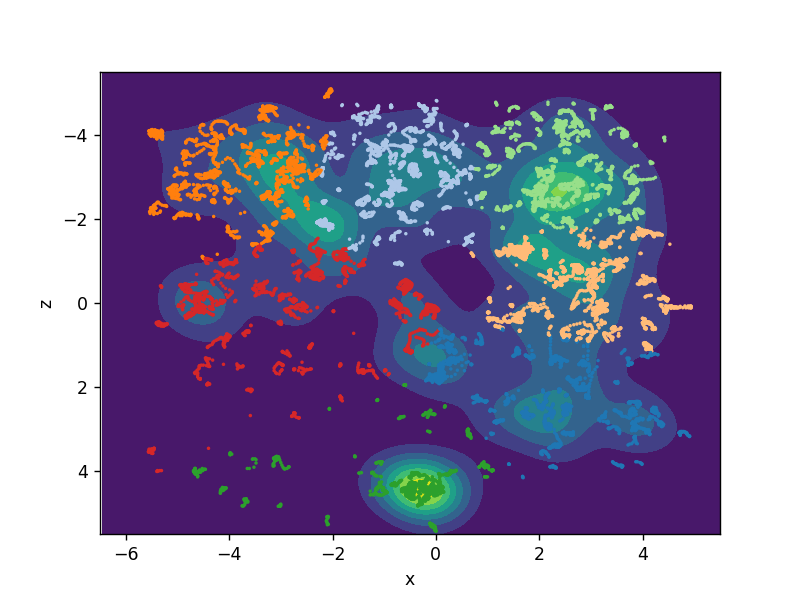

7 [[ 2.17316579  2.20478977]
 [-0.90934241 -2.736714  ]
 [-3.57966015 -3.15671579]
 [ 2.70199331 -0.54306223]
 [-0.48536179  4.31450942]
 [ 2.48490505 -3.01693241]
 [-2.53199321  0.14387563]]
8


<IPython.core.display.Javascript object>


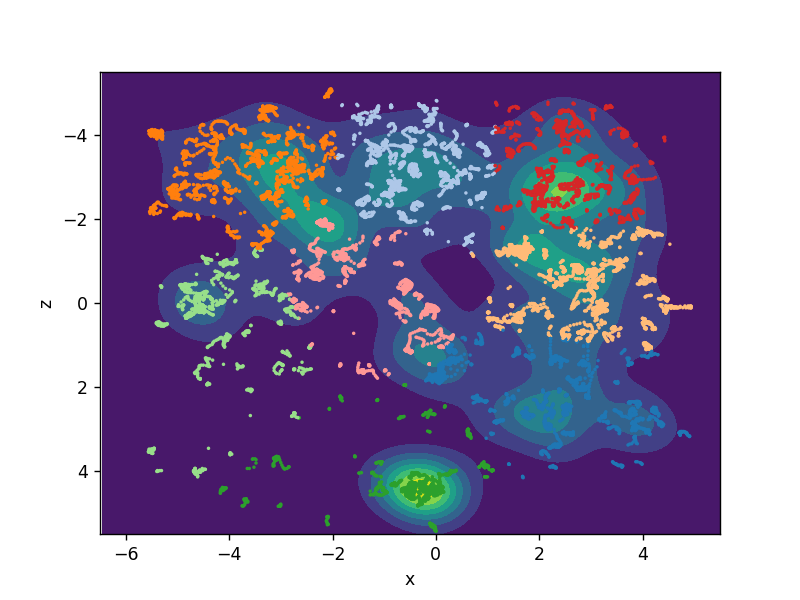

8 [[ 2.21007236  2.22813257]
 [-0.33151698 -3.03208204]
 [-3.51475957 -3.15560035]
 [ 2.70100103 -0.54126584]
 [-0.38706991  4.30727309]
 [-4.17241558  0.40777535]
 [ 2.62411612 -3.01929497]
 [-1.46200543 -0.56487332]]
9


<IPython.core.display.Javascript object>


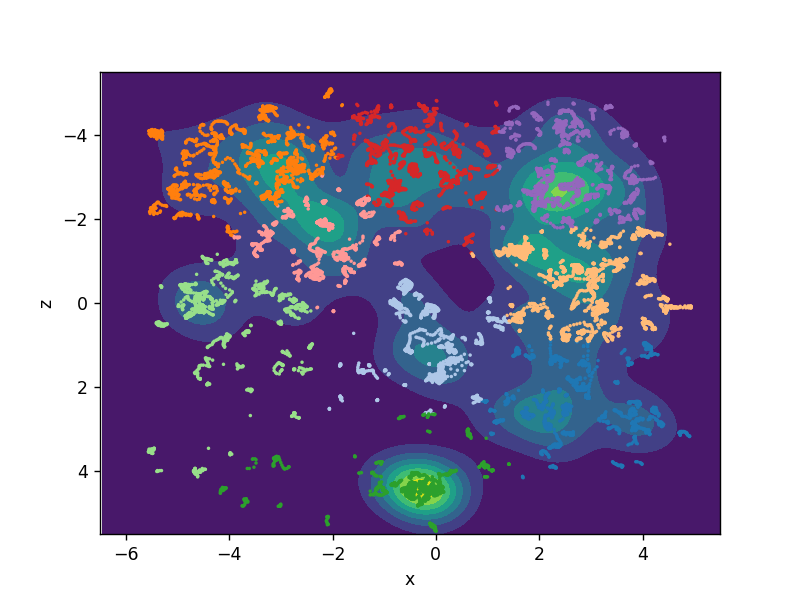

9 [[ 2.65685321  2.39225845]
 [-0.17427037  0.90339401]
 [-3.5935503  -3.32925049]
 [ 2.71653966 -0.5693586 ]
 [-0.36522915  4.35731178]
 [-4.02510107  0.41340687]
 [-0.24256396 -3.08554117]
 [-2.14756305 -1.62752646]
 [ 2.63127671 -3.01526576]]
10


<IPython.core.display.Javascript object>


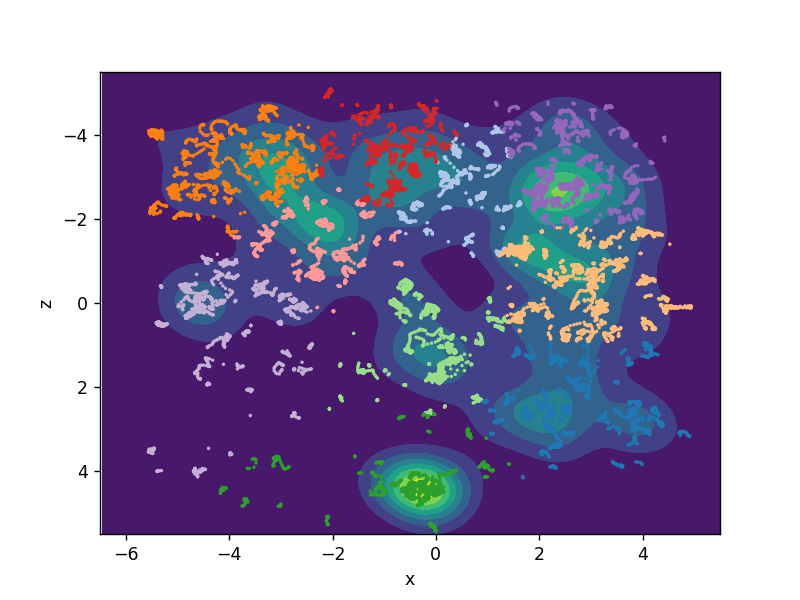

10 [[ 2.65665882  2.39323707]
 [ 0.44382867 -2.57492308]
 [-3.68765467 -3.29344635]
 [ 2.72377619 -0.56691627]
 [-0.36499313  4.36087741]
 [-0.17505926  0.90781309]
 [-0.86704683 -3.41399307]
 [-2.20060206 -1.57723689]
 [ 2.66792002 -3.03951422]
 [-4.02612731  0.41358617]]
11


<IPython.core.display.Javascript object>


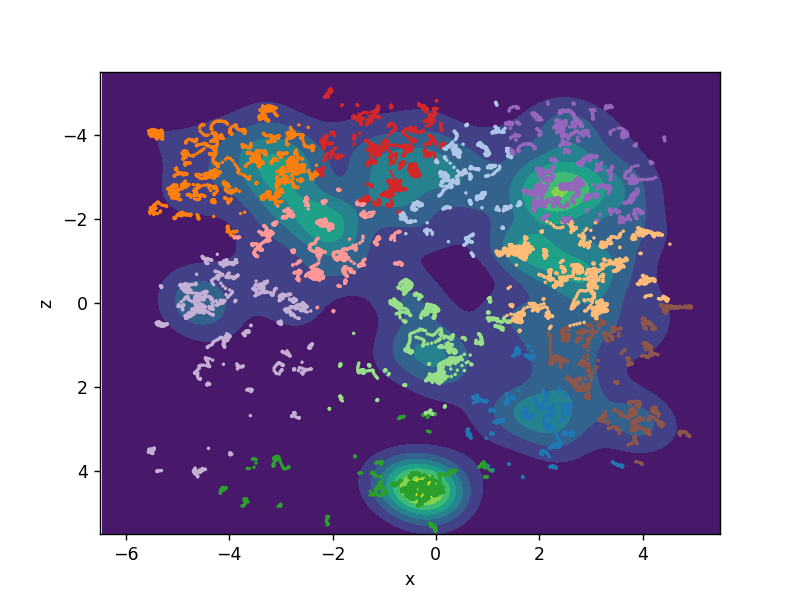

11 [[ 1.90035223  2.67364294]
 [ 0.45812399 -2.67191138]
 [-3.68814336 -3.29348951]
 [ 2.59779172 -0.81811921]
 [-0.40877468  4.39609269]
 [-0.18905459  0.87728952]
 [-0.91087271 -3.3938971 ]
 [-2.19871803 -1.57464543]
 [ 2.68036926 -3.04430525]
 [-4.02612731  0.41358617]
 [ 3.34633776  1.68599848]]
12


<IPython.core.display.Javascript object>


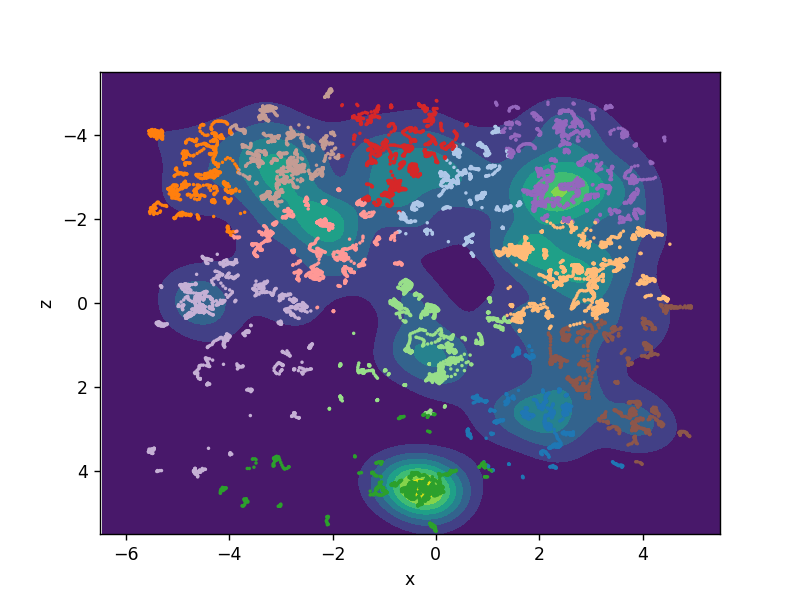

12 [[ 1.90035223  2.67364294]
 [ 0.44115255 -2.56338605]
 [-4.68205939 -3.17800766]
 [ 2.59781642 -0.81951881]
 [-0.40805186  4.39238439]
 [-0.18937255  0.8726371 ]
 [-0.72436041 -3.37057205]
 [-2.20149743 -1.57824755]
 [ 2.66778953 -3.0534581 ]
 [-4.02612731  0.41358617]
 [ 3.34633776  1.68599848]
 [-3.01835494 -3.40943669]]
13


<IPython.core.display.Javascript object>


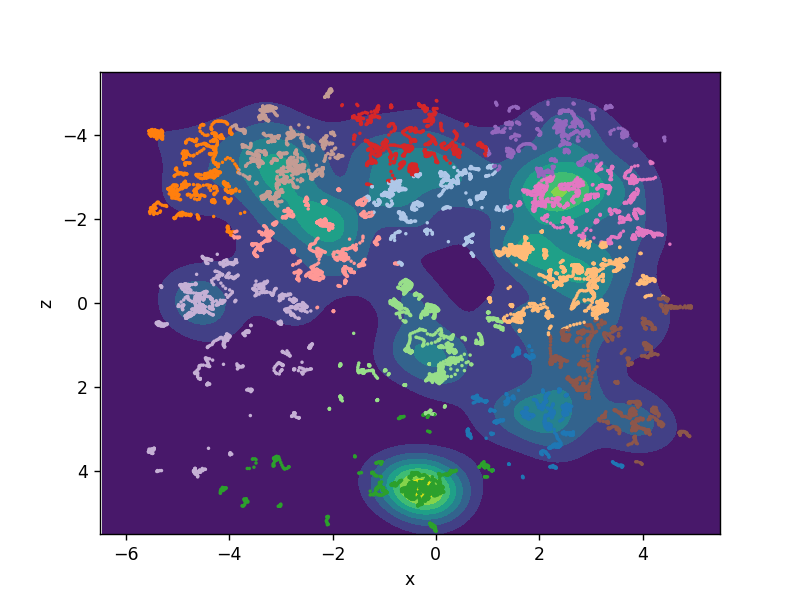

13 [[ 1.9144773   2.65139877]
 [-0.10112332 -2.46211832]
 [-4.68143541 -3.18351196]
 [ 2.40989142 -0.71291693]
 [-0.39058093  4.39184531]
 [-0.22028152  0.8929465 ]
 [-0.49797846 -3.69837857]
 [-2.2230742  -1.58569187]
 [ 2.43832395 -3.8554329 ]
 [-4.02612731  0.41358617]
 [ 3.3744315   1.65143523]
 [-3.01341961 -3.40870582]
 [ 2.8650273  -2.47128868]]
14


<IPython.core.display.Javascript object>


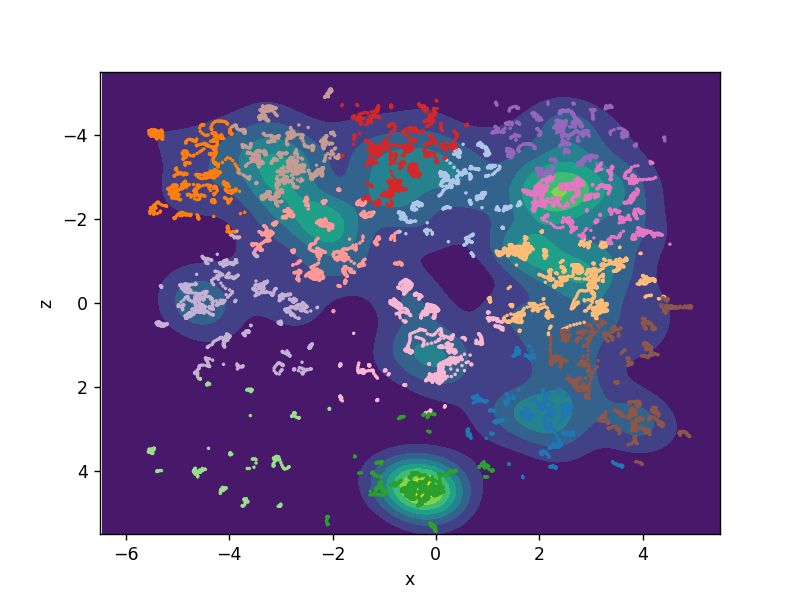

14 [[ 1.9154656   2.64976658]
 [ 0.42617251 -2.51641902]
 [-4.68058317 -3.18216061]
 [ 2.41892053 -0.70557343]
 [-0.27151414  4.39081269]
 [-4.01022305  3.51788104]
 [-0.70995449 -3.37616782]
 [-2.17970398 -1.58476328]
 [ 2.46324761 -3.86337987]
 [-3.97682468  0.06065672]
 [ 3.37301261  1.65522326]
 [-3.01637226 -3.40848303]
 [ 2.88514043 -2.47341833]
 [-0.21701733  0.88094666]]


In [60]:
X = xz.T

sses = []
sses_n_cls = []

silhouette_scores = []
silhouette_scores_n_cls = []

calinski_harabasz_score = []
calinski_harabasz_scores_n_cls = []

davies_bouldin_scores = []
davies_bouldin_scores_n_cls = []

for n_cl in range(1,15):
    print(n_cl)
    kmeans = KMeans(n_clusters=n_cl, **common_params)
    labels = kmeans.fit_predict(X)
    plot_KMeans_results(X,Xc,Zc,f,kmeans)

    sse = kmeans.inertia_ 
    sses.append(sse)
    sses_n_cls.append(n_cl)

    if n_cl>1:
        sil = metrics.silhouette_score(X, labels, metric='euclidean') #The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster
        silhouette_scores.append(sil)
        silhouette_scores_n_cls.append(n_cl)
        ch = metrics.calinski_harabasz_score(X, labels)
        calinski_harabasz_score.append(ch)
        calinski_harabasz_scores_n_cls.append(n_cl)
        db = metrics.davies_bouldin_score(X, labels)
        davies_bouldin_scores.append(db)
        davies_bouldin_scores_n_cls.append(n_cl)

<IPython.core.display.Javascript object>


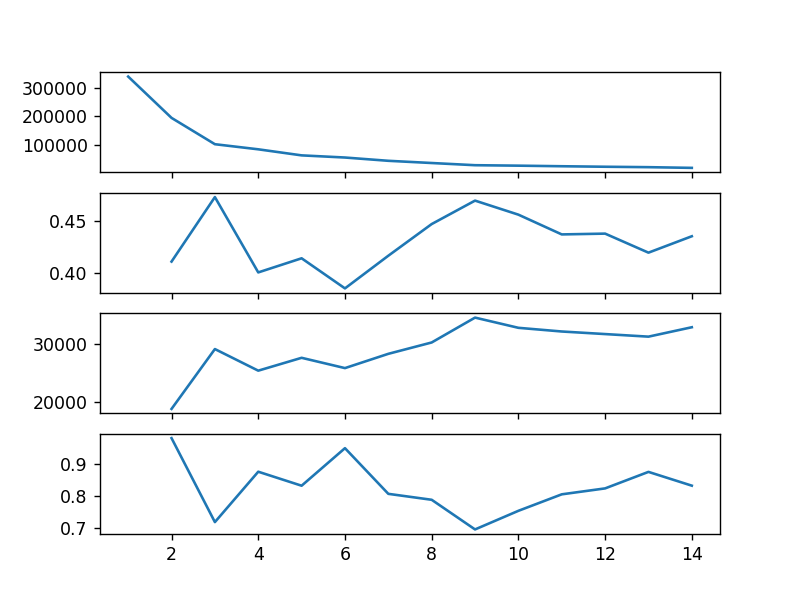

In [62]:
fig, (ax0,ax1,ax2,ax3) = plt.subplots(4,sharex=True)

ax0.plot(sses_n_cls,sses)
ax1.plot(silhouette_scores_n_cls,silhouette_scores)
ax2.plot(calinski_harabasz_scores_n_cls,calinski_harabasz_score)
ax3.plot(davies_bouldin_scores_n_cls,davies_bouldin_scores)

number of classes 1


<IPython.core.display.Javascript object>


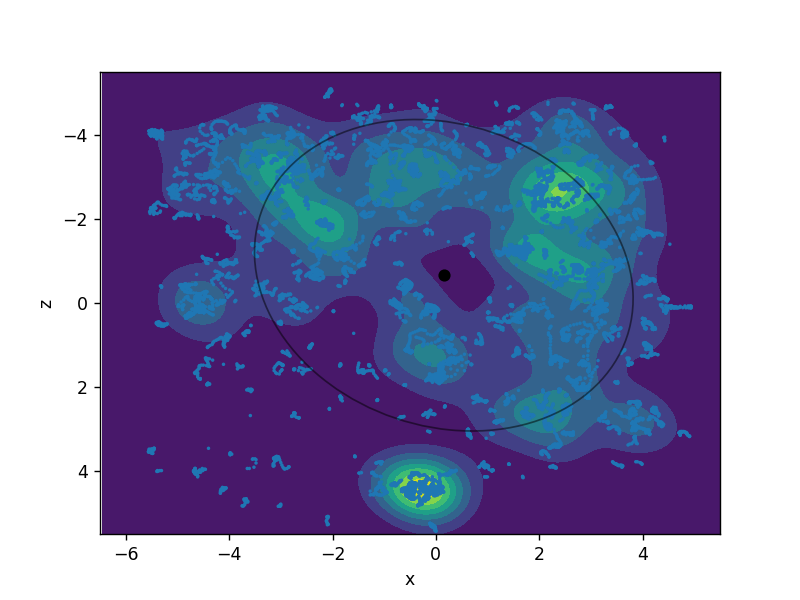

1 [[ 0.15420116 -0.66047882]]
number of classes 2


<IPython.core.display.Javascript object>


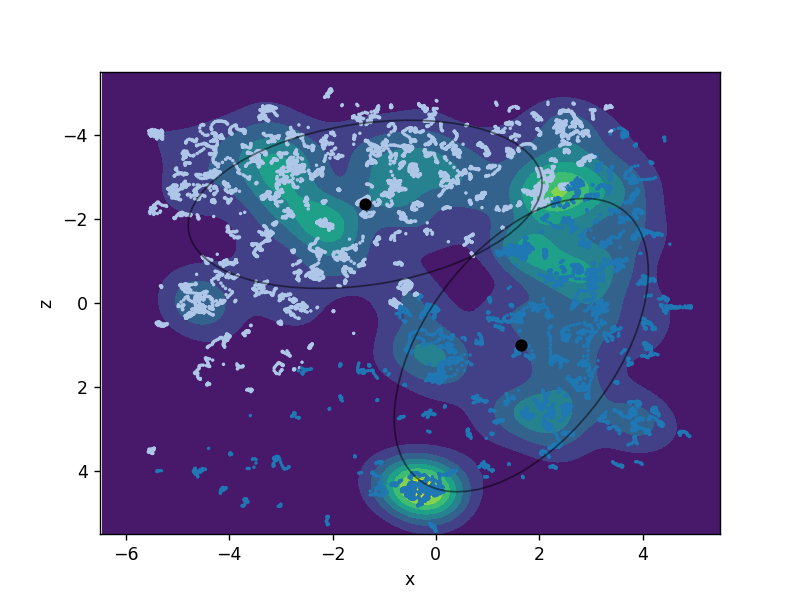

2 [[ 1.65323771  1.0022063 ]
 [-1.36885239 -2.34980284]]
number of classes 3


<IPython.core.display.Javascript object>


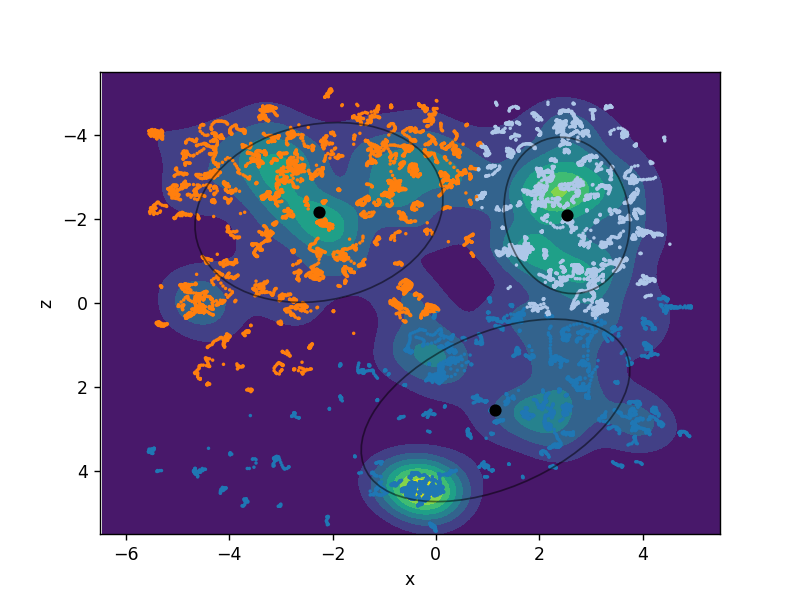

3 [[ 1.15483685  2.55621015]
 [ 2.53638491 -2.08617426]
 [-2.26221759 -2.15587196]]
number of classes 4


<IPython.core.display.Javascript object>


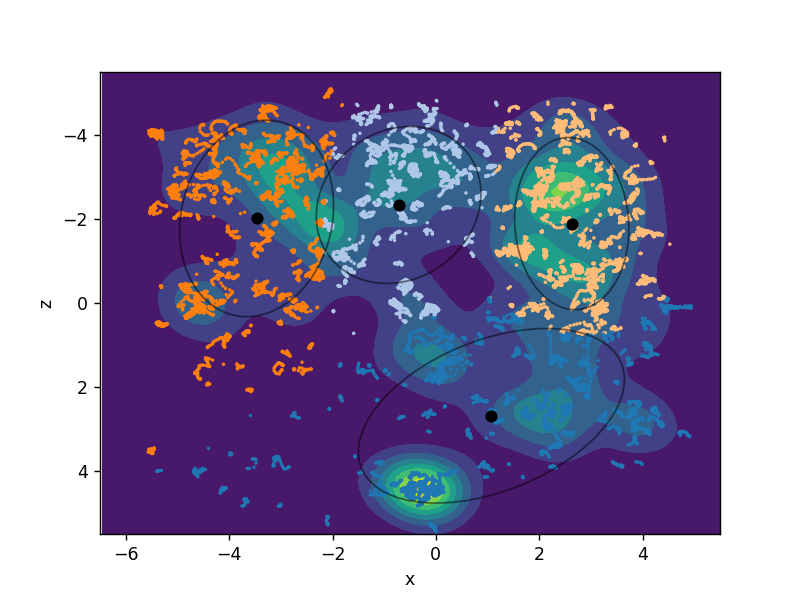

4 [[ 1.07582511  2.6852256 ]
 [-0.72088155 -2.33400157]
 [-3.46842486 -2.01407052]
 [ 2.6299975  -1.89170603]]
number of classes 5


<IPython.core.display.Javascript object>


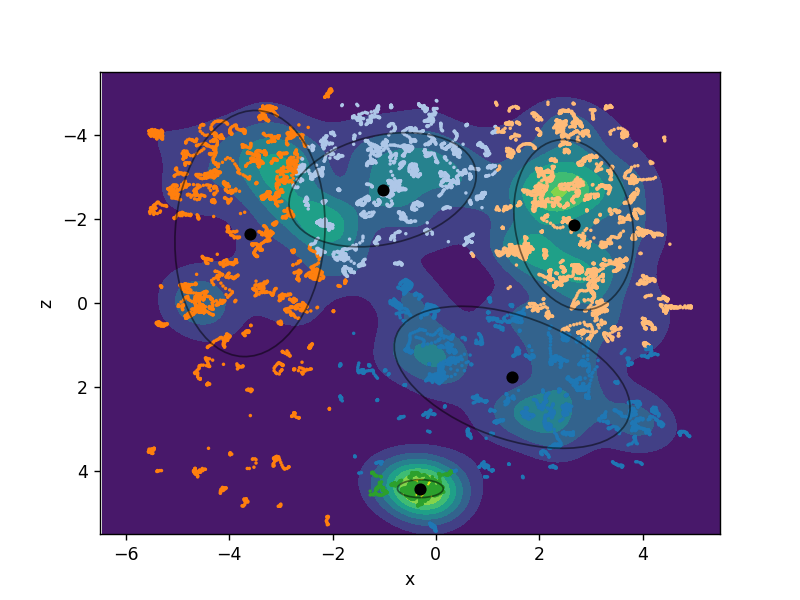

5 [[ 1.47708569  1.76819833]
 [-1.03074445 -2.69609183]
 [-3.59735295 -1.65427845]
 [ 2.66979734 -1.86318661]
 [-0.29938846  4.42010416]]
number of classes 6


<IPython.core.display.Javascript object>


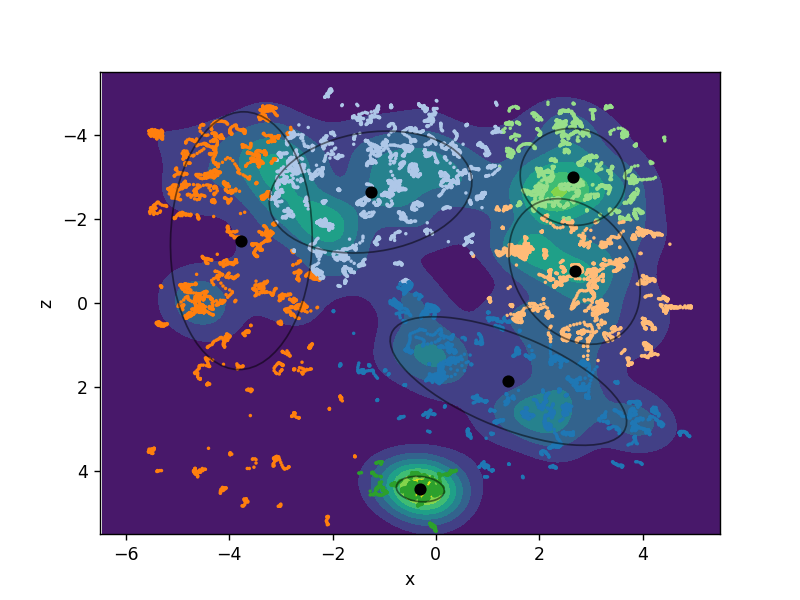

6 [[ 1.40439641  1.85776804]
 [-1.26342948 -2.64149372]
 [-3.76462491 -1.48391641]
 [ 2.68460422 -0.75045075]
 [-0.30027961  4.42977425]
 [ 2.65460983 -3.00122276]]
number of classes 7


<IPython.core.display.Javascript object>


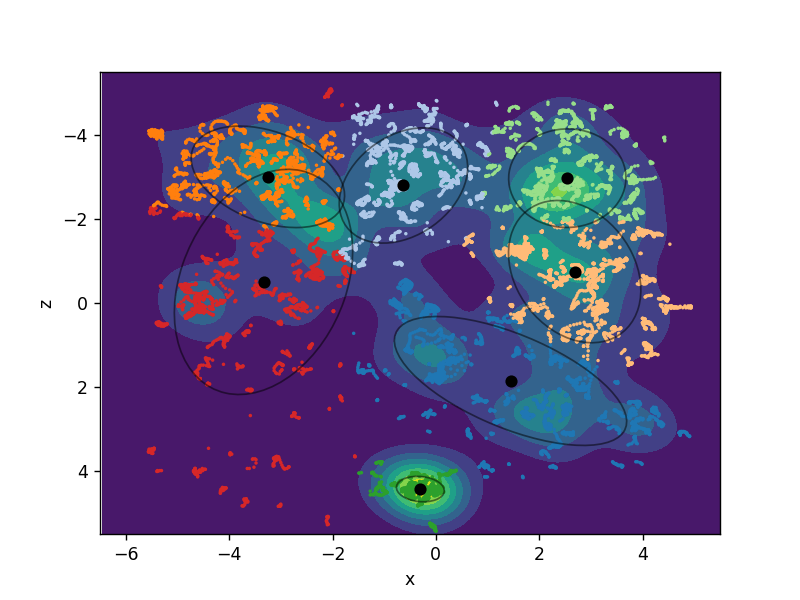

7 [[ 1.44550275  1.85620483]
 [-0.62718464 -2.79879805]
 [-3.25097899 -3.00432798]
 [ 2.6873878  -0.7477348 ]
 [-0.29968437  4.43009112]
 [ 2.54447877 -2.97191996]
 [-3.33525141 -0.50196773]]
number of classes 8


<IPython.core.display.Javascript object>


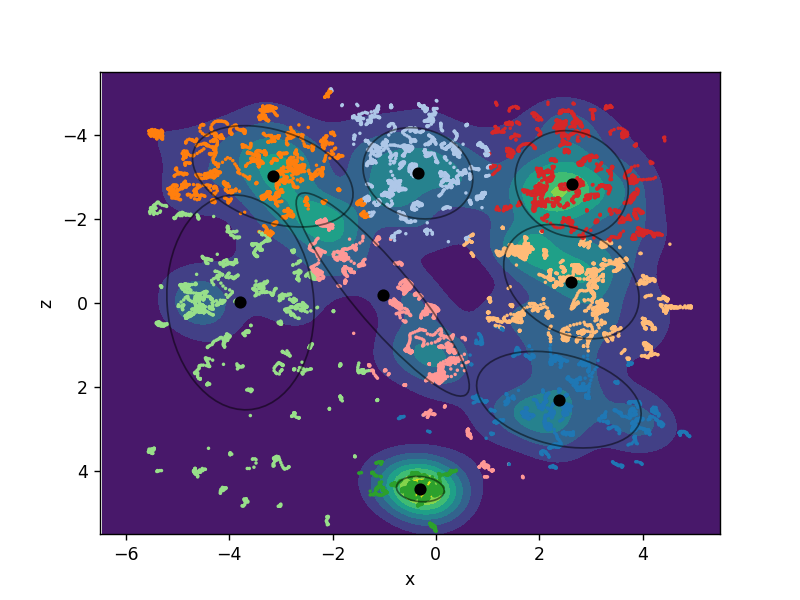

8 [[ 2.38147213  2.3010972 ]
 [-0.34761066 -3.08828617]
 [-3.15607609 -3.01615758]
 [ 2.62297442 -0.50865417]
 [-0.29970633  4.43017945]
 [-3.78093453 -0.01421181]
 [ 2.62943101 -2.83491949]
 [-1.02801636 -0.2022432 ]]
number of classes 9


<IPython.core.display.Javascript object>


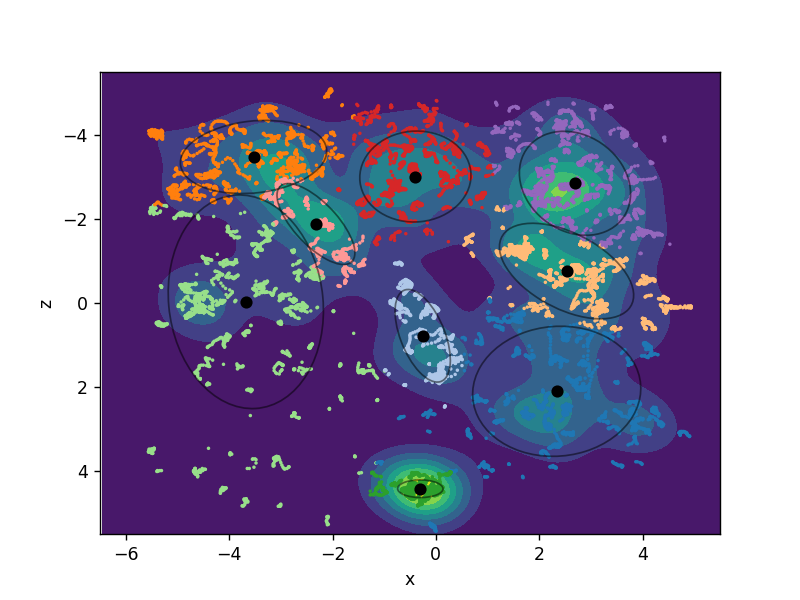

9 [[ 2.33957162  2.10209413]
 [-0.25413817  0.78054283]
 [-3.52792095 -3.47632932]
 [ 2.53000594 -0.7605019 ]
 [-0.30059289  4.42186397]
 [-3.67774153 -0.02931302]
 [-0.39599765 -3.01124654]
 [-2.32055412 -1.87981513]
 [ 2.69310545 -2.8503359 ]]
number of classes 10


<IPython.core.display.Javascript object>


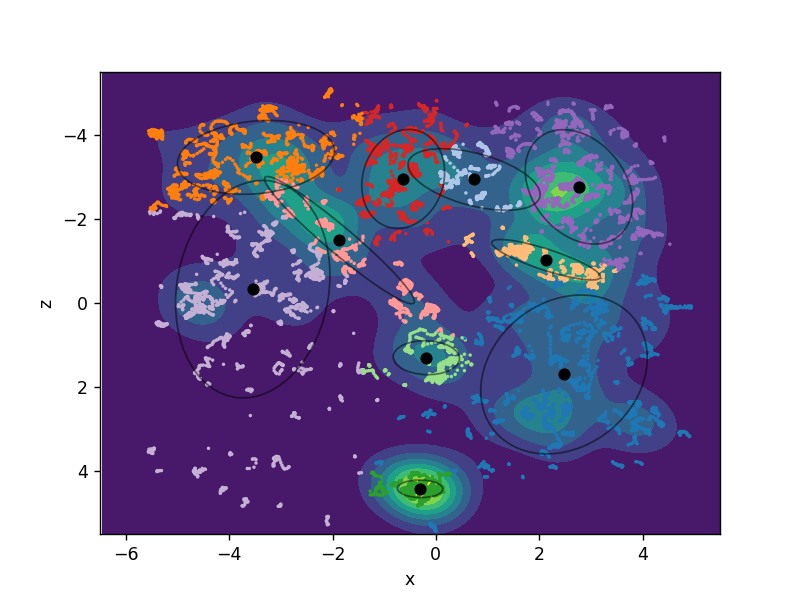

10 [[ 2.48114139  1.70112967]
 [ 0.73978999 -2.94080974]
 [-3.48091345 -3.46706633]
 [ 2.13361031 -1.03010525]
 [-0.30343969  4.42275049]
 [-0.1834172   1.30225802]
 [-0.6316322  -2.95390811]
 [-1.86478103 -1.49712037]
 [ 2.76908361 -2.76463435]
 [-3.54373508 -0.32929505]]
number of classes 11


<IPython.core.display.Javascript object>


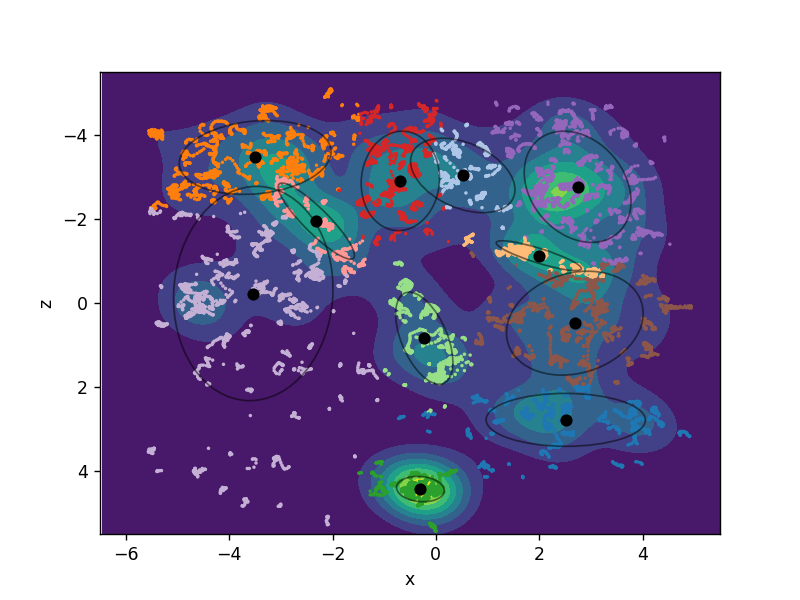

11 [[ 2.51445005  2.7820198 ]
 [ 0.52138433 -3.03690996]
 [-3.49620302 -3.46501426]
 [ 1.99258889 -1.1266103 ]
 [-0.29817577  4.43031147]
 [-0.22399469  0.83927651]
 [-0.6869785  -2.90695288]
 [-2.31326229 -1.94959122]
 [ 2.74409048 -2.76742228]
 [-3.53378051 -0.22584596]
 [ 2.68983684  0.48000238]]
number of classes 12


<IPython.core.display.Javascript object>


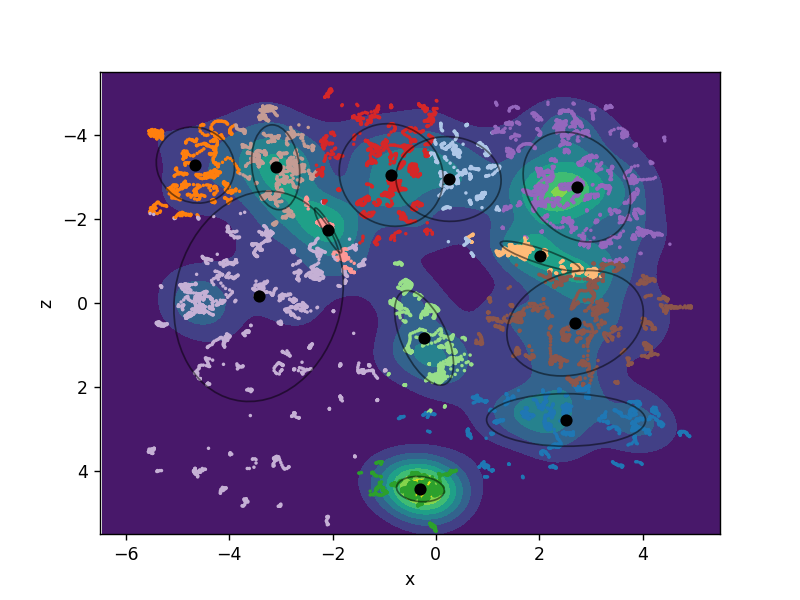

12 [[ 2.52081144  2.78441464]
 [ 0.24543843 -2.95260892]
 [-4.65431972 -3.2840286 ]
 [ 2.01832834 -1.11819232]
 [-0.29799781  4.43030712]
 [-0.22724127  0.82915508]
 [-0.86369335 -3.0474937 ]
 [-2.08457883 -1.72825655]
 [ 2.72850113 -2.7625357 ]
 [-3.43043233 -0.15869944]
 [ 2.69587565  0.48058967]
 [-3.10019563 -3.23161366]]
number of classes 13


<IPython.core.display.Javascript object>


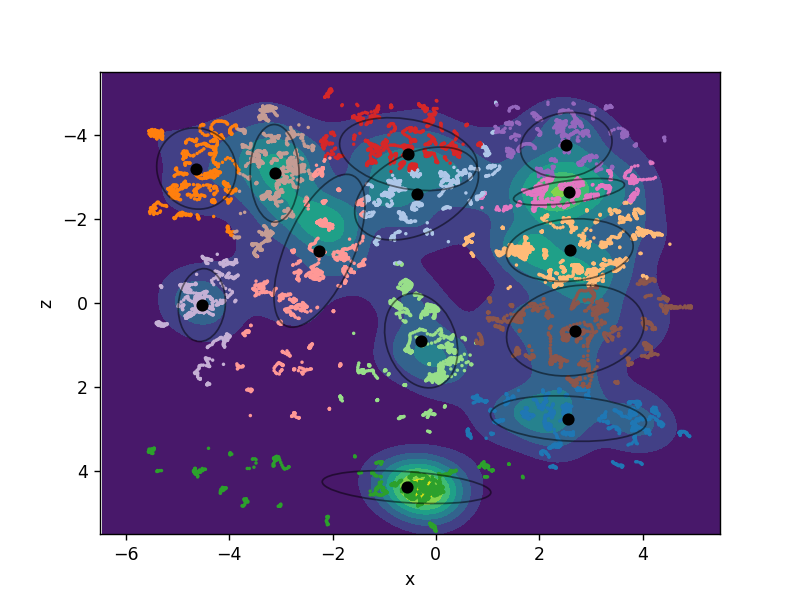

13 [[ 2.566757    2.75144707]
 [-0.37183694 -2.60643993]
 [-4.63319884 -3.20227132]
 [ 2.5920785  -1.25913812]
 [-0.56697248  4.38401468]
 [-0.28434365  0.89626463]
 [-0.53149654 -3.54385793]
 [-2.25238116 -1.24354138]
 [ 2.52407636 -3.76424853]
 [-4.52905152  0.04968773]
 [ 2.70029297  0.65561669]
 [-3.12001635 -3.0873773 ]
 [ 2.57774027 -2.6481959 ]]
number of classes 14


<IPython.core.display.Javascript object>


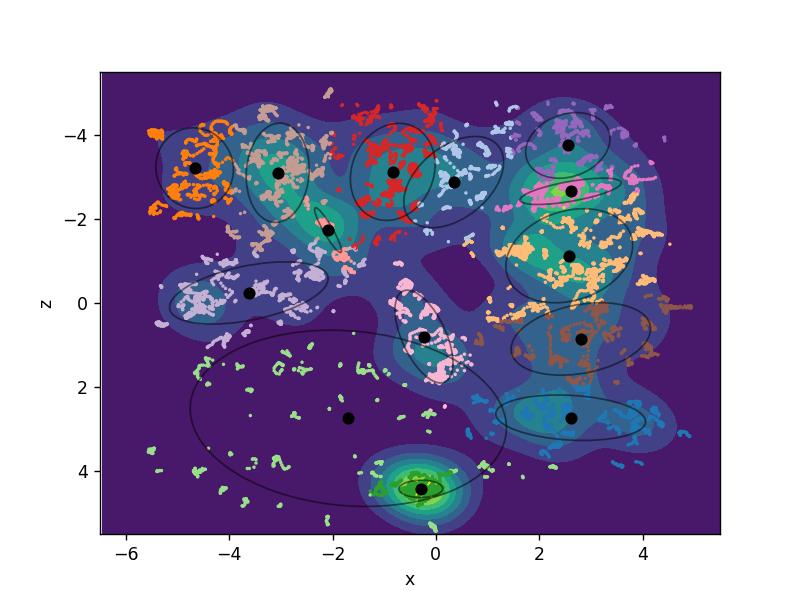

14 [[ 2.6100462   2.73109981]
 [ 0.34593487 -2.87905754]
 [-4.66874249 -3.21043721]
 [ 2.5823901  -1.1248187 ]
 [-0.29065703  4.423868  ]
 [-1.69456763  2.74517856]
 [-0.83428575 -3.12251366]
 [-2.08581292 -1.73537359]
 [ 2.55382837 -3.75177264]
 [-3.61912988 -0.23941319]
 [ 2.80579013  0.85624328]
 [-3.06135798 -3.10098942]
 [ 2.60840048 -2.65867784]
 [-0.22927607  0.79912939]]
number of classes 15


<IPython.core.display.Javascript object>


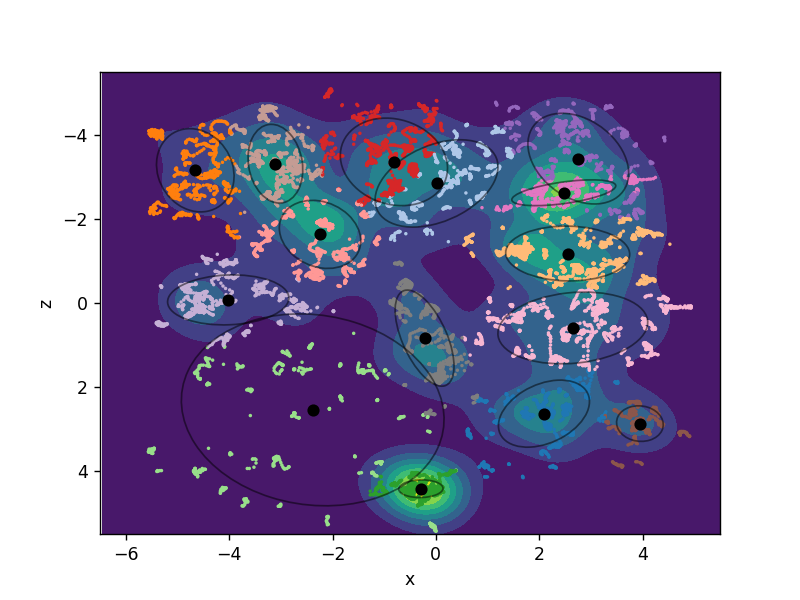

15 [[ 2.09255183  2.63439633]
 [ 0.01353815 -2.84733072]
 [-4.65570449 -3.16011904]
 [ 2.55208022 -1.17812196]
 [-0.28957134  4.42170406]
 [-2.38300482  2.54385376]
 [-0.81118921 -3.36028266]
 [-2.2409715  -1.63357602]
 [ 2.75698012 -3.43709436]
 [-4.01812617 -0.07402383]
 [ 3.94990995  2.87120235]
 [-3.10507279 -3.31664684]
 [ 2.47657848 -2.62476887]
 [ 2.65122578  0.59368097]
 [-0.21779781  0.83638018]]
number of classes 16


<IPython.core.display.Javascript object>


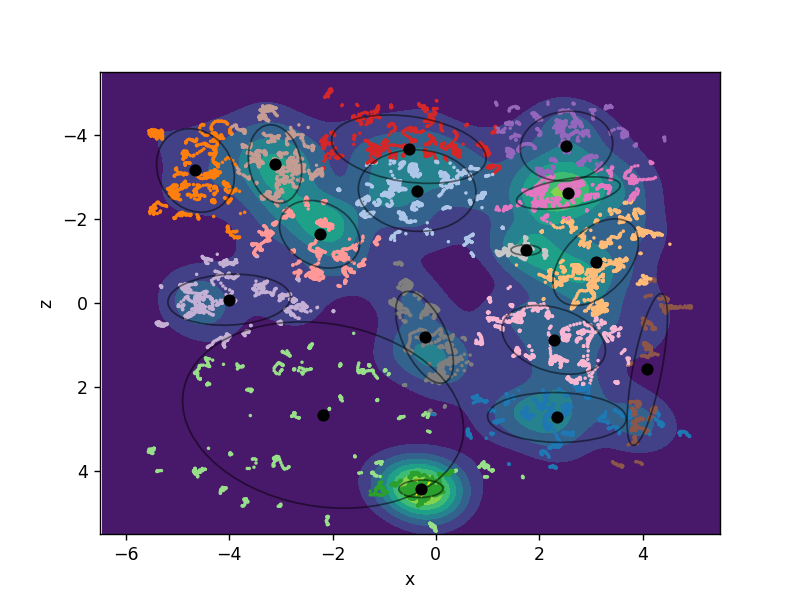

16 [[ 2.34419622  2.72482182]
 [-0.36229861 -2.6771727 ]
 [-4.65247882 -3.1561318 ]
 [ 3.09325749 -0.97194519]
 [-0.28875151  4.4217533 ]
 [-2.18174288  2.66689452]
 [-0.52285333 -3.66258328]
 [-2.24815555 -1.63593854]
 [ 2.52829098 -3.73576855]
 [-3.99988733 -0.07862253]
 [ 4.09190174  1.58165296]
 [-3.11239201 -3.31213572]
 [ 2.56553278 -2.61975817]
 [ 2.28113982  0.87611256]
 [-0.21849525  0.81645051]
 [ 1.74183776 -1.26026016]]
number of classes 17


<IPython.core.display.Javascript object>


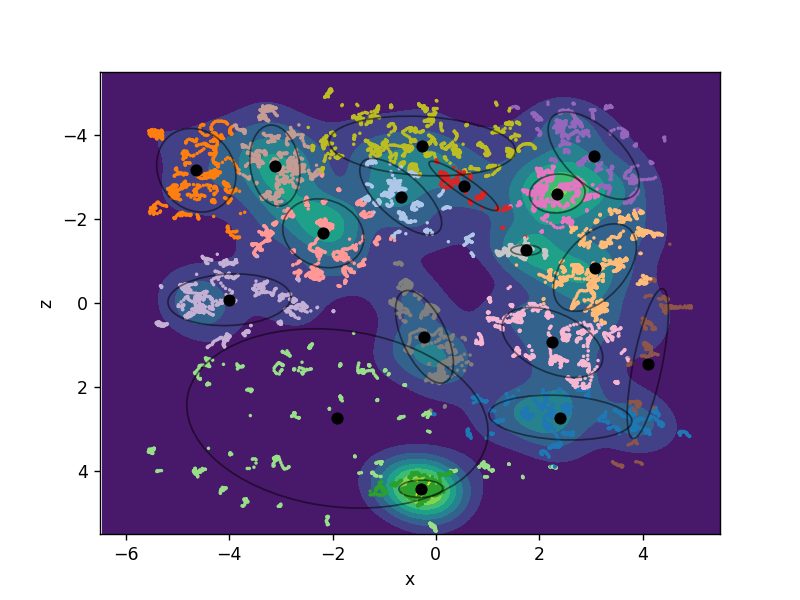

17 [[ 2.41034583  2.72803684]
 [-0.67957002 -2.53287339]
 [-4.63670082 -3.16108238]
 [ 3.0797865  -0.84324227]
 [-0.28962796  4.42295607]
 [-1.90503554  2.74823191]
 [ 0.53691897 -2.78805771]
 [-2.17802264 -1.65945117]
 [ 3.0542915  -3.50912938]
 [-3.99524091 -0.07823634]
 [ 4.10249285  1.44350633]
 [-3.11530843 -3.27157162]
 [ 2.3511198  -2.60684937]
 [ 2.25606775  0.93943365]
 [-0.22057674  0.80428828]
 [ 1.74276948 -1.25934006]
 [-0.26174243 -3.73796172]]
number of classes 18


<IPython.core.display.Javascript object>


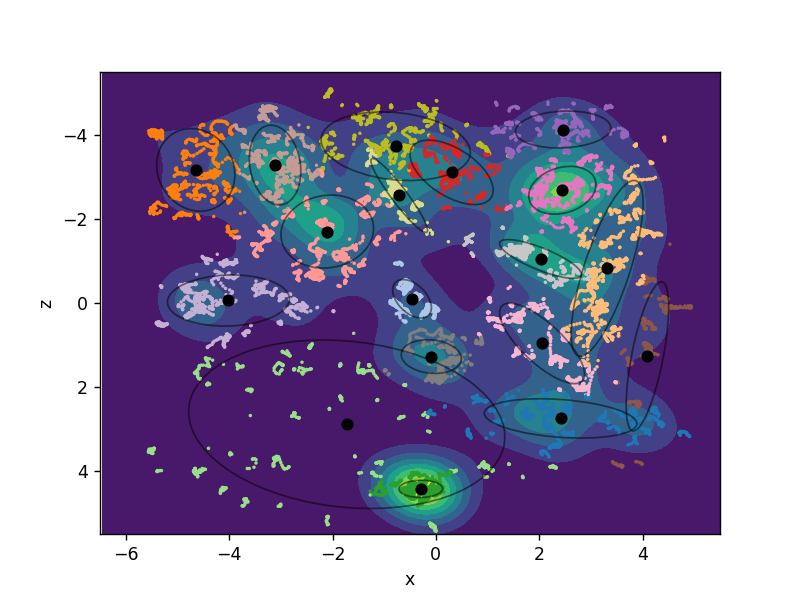

18 [[ 2.41373677  2.74816714]
 [-0.46003265 -0.09996428]
 [-4.64705882 -3.16970363]
 [ 3.31599311 -0.82521068]
 [-0.29073015  4.42422958]
 [-1.72472633  2.88659428]
 [ 0.30570001 -3.11077484]
 [-2.10105192 -1.70096481]
 [ 2.46364372 -4.13062445]
 [-4.01393831 -0.05982969]
 [ 4.09515459  1.27198116]
 [-3.11071584 -3.28458433]
 [ 2.44908523 -2.68497287]
 [ 2.05690433  0.96227567]
 [-0.08730472  1.27587202]
 [ 2.0258337  -1.0486629 ]
 [-0.77667684 -3.73292754]
 [-0.70862103 -2.55988614]]
number of classes 19


<IPython.core.display.Javascript object>


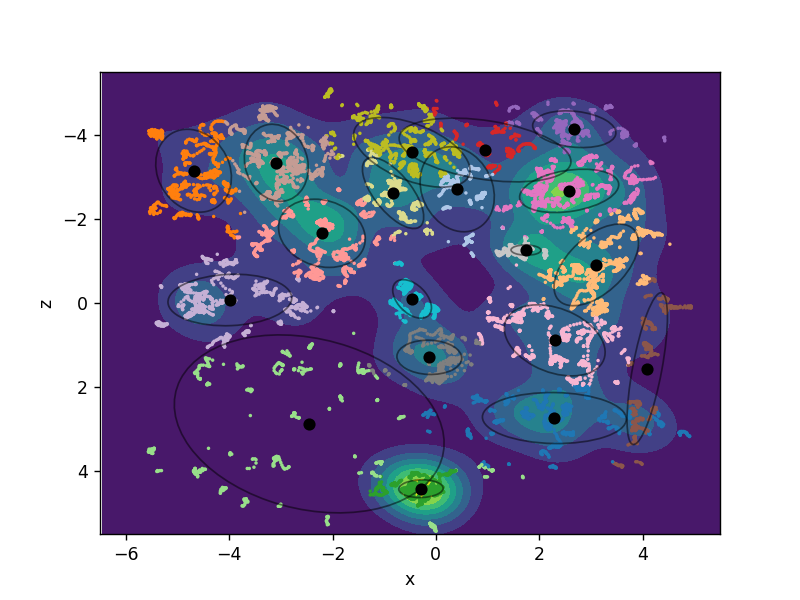

19 [[ 2.29440004  2.7388509 ]
 [ 0.41373437 -2.70753017]
 [-4.68885511 -3.14962636]
 [ 3.10536997 -0.90695638]
 [-0.28805842  4.42097009]
 [-2.45070456  2.87829641]
 [ 0.95217033 -3.64310628]
 [-2.20505088 -1.65956228]
 [ 2.6794007  -4.13804446]
 [-3.98666166 -0.07183133]
 [ 4.0920314   1.56207564]
 [-3.08746226 -3.33839594]
 [ 2.58061991 -2.66962617]
 [ 2.30095412  0.88955321]
 [-0.12614425  1.29330688]
 [ 1.74452457 -1.25940905]
 [-0.46358747 -3.58807249]
 [-0.82775418 -2.61828953]
 [-0.45952952 -0.09709202]]


In [80]:
X = xz.T

lls = []
lls_n_cls = []

silhouette_scores = []
silhouette_scores_n_cls = []

calinski_harabasz_score = []
calinski_harabasz_scores_n_cls = []

davies_bouldin_scores = []
davies_bouldin_scores_n_cls = []

for n_cl in range(1,20):
    print("number of classes",n_cl)
    kmeans = KMeans(n_clusters=n_cl, **common_params)
    kmeans.fit(X)
    #plot_KMeans_results(X,Xc,Zc,f,kmeans)

    # Try GMMs using different types of covariances.
    gmm = GaussianMixture(n_components=n_cl, covariance_type="full", max_iter=40, random_state=0)
    gmm.means_init = kmeans.cluster_centers_
    labels = gmm.fit_predict(X)

    plot_GMM_results(X,Xc,Zc,f,gmm)
    
    ll =  gmm.score(X)
    lls.append(ll)
    lls_n_cls.append(n_cl)

    if n_cl>1:
        sil = metrics.silhouette_score(X, labels, metric='euclidean') #The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster
        silhouette_scores.append(sil)
        silhouette_scores_n_cls.append(n_cl)
        ch = metrics.calinski_harabasz_score(X, labels)
        calinski_harabasz_score.append(ch)
        calinski_harabasz_scores_n_cls.append(n_cl)
        db = metrics.davies_bouldin_score(X, labels)
        davies_bouldin_scores.append(db)
        davies_bouldin_scores_n_cls.append(n_cl)

<IPython.core.display.Javascript object>


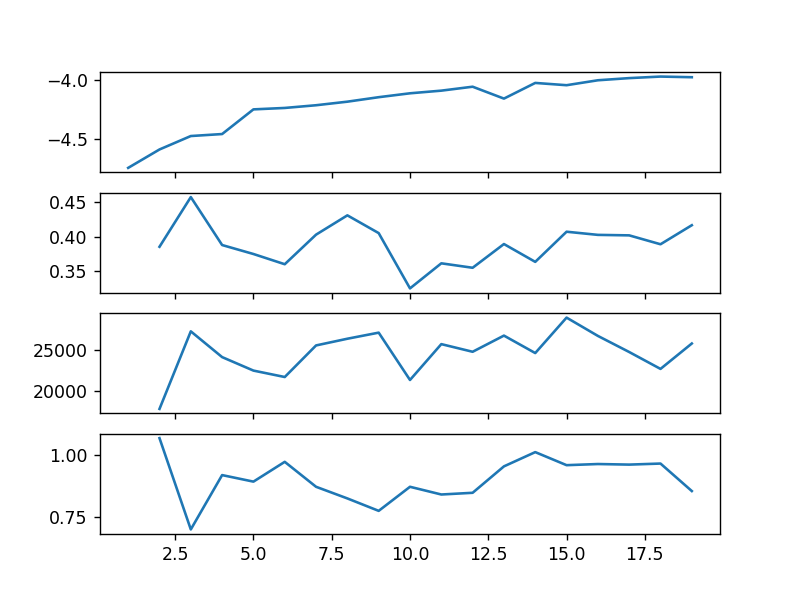

In [81]:
fig, (ax0,ax1,ax2,ax3) = plt.subplots(4,sharex=True)

ax0.plot(lls_n_cls,lls)
ax1.plot(silhouette_scores_n_cls,silhouette_scores)
ax2.plot(calinski_harabasz_scores_n_cls,calinski_harabasz_score)
ax3.plot(davies_bouldin_scores_n_cls,davies_bouldin_scores)

<IPython.core.display.Javascript object>


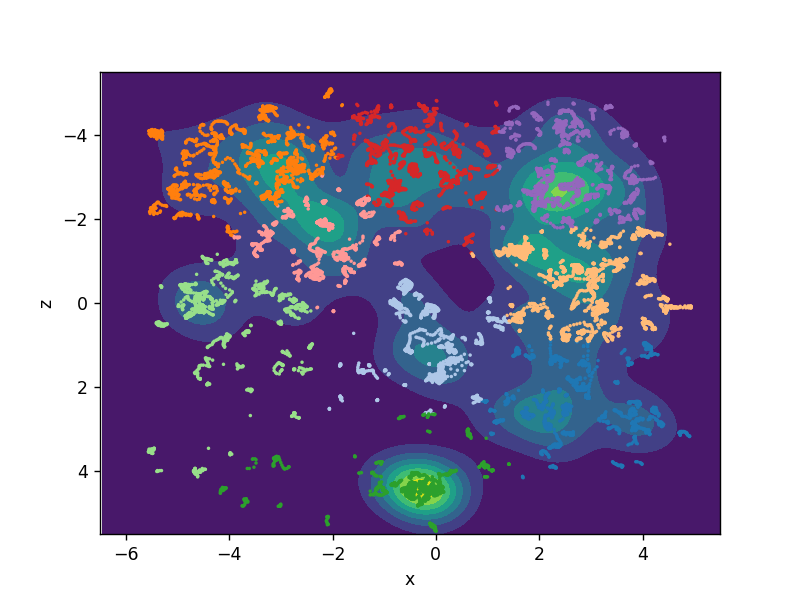

19 [[ 2.65685321  2.39225845]
 [-0.17427037  0.90339401]
 [-3.5935503  -3.32925049]
 [ 2.71653966 -0.5693586 ]
 [-0.36522915  4.35731178]
 [-4.02510107  0.41340687]
 [-0.24256396 -3.08554117]
 [-2.14756305 -1.62752646]
 [ 2.63127671 -3.01526576]]


<IPython.core.display.Javascript object>


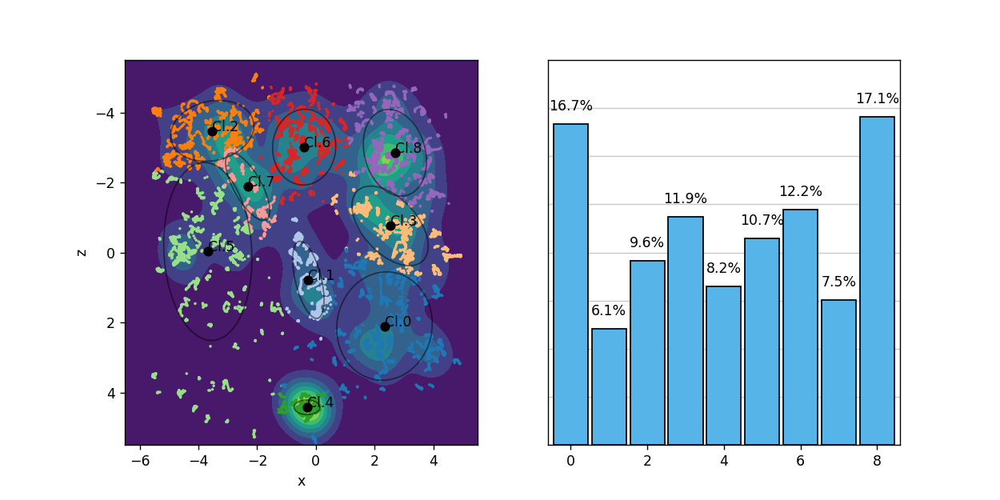

19 [[ 2.33957162  2.10209413]
 [-0.25413817  0.78054283]
 [-3.52792095 -3.47632932]
 [ 2.53000594 -0.7605019 ]
 [-0.30059289  4.42186397]
 [-3.67774153 -0.02931302]
 [-0.39599765 -3.01124654]
 [-2.32055412 -1.87981513]
 [ 2.69310545 -2.8503359 ]]


<IPython.core.display.Javascript object>


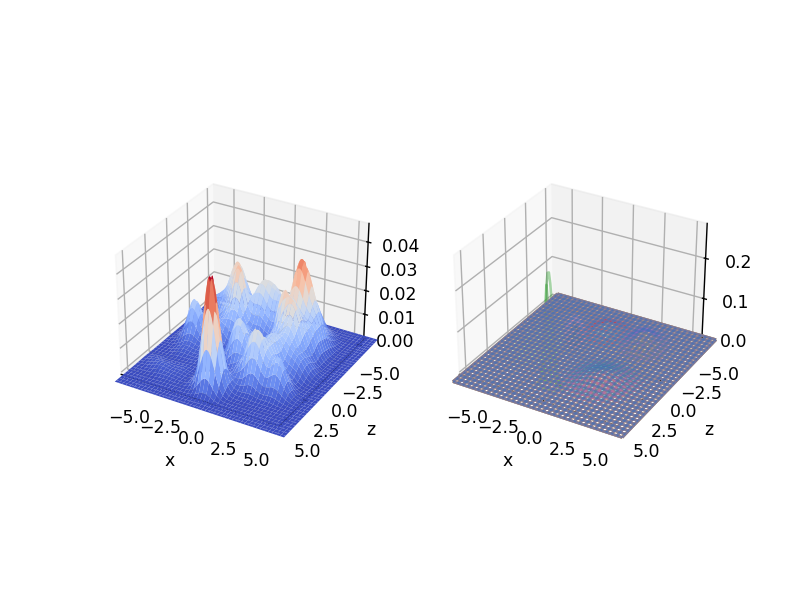

0 w 0.16682387469510448
1 w 0.060522948147226155
2 w 0.09580842312343779
3 w 0.11874257672459061
4 w 0.08245683420301865
5 w 0.10731660037969623
6 w 0.12242584666475959
7 w 0.07527881720222365
8 w 0.17062407885994277


<IPython.core.display.Javascript object>


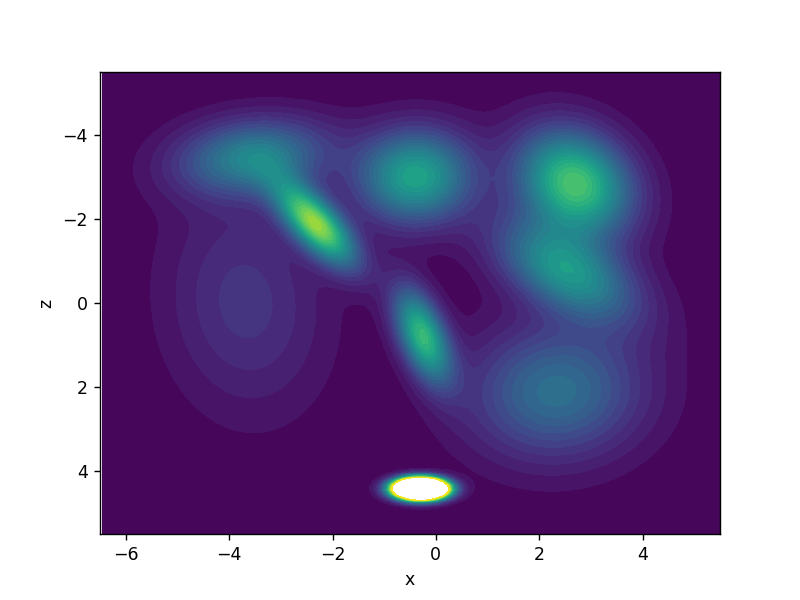

<IPython.core.display.Javascript object>


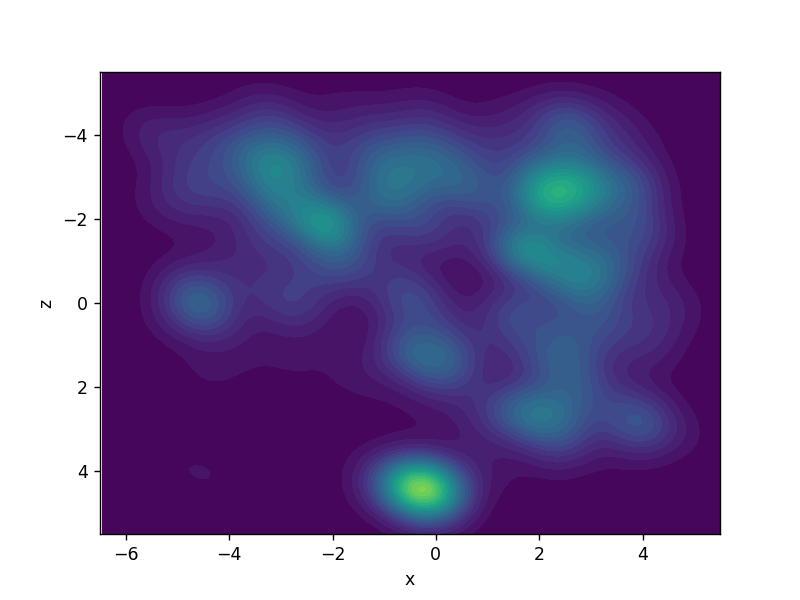

(-6.5, 5.5)

In [209]:
n_classes = 9 #len(np.unique(y_train))

X = xz.T

kmeans = KMeans(n_clusters=n_classes, **common_params)
labels = kmeans.fit_predict(X)

plot_KMeans_results(X,Xc,Zc,f,kmeans)

# Try GMMs using different types of covariances.
gmm = GaussianMixture(n_components=n_classes, covariance_type="full", max_iter=200, random_state=0)
gmm.means_init = kmeans.cluster_centers_
labels = gmm.fit_predict(X)

fig,ax,ax2 = plot_GMM_results(X,Xc,Zc,f,gmm)


    
fig = plt.figure()
ax = fig.add_subplot(121, projection='3d')
surf = ax.plot_surface(Xc,Zc,f,cmap=mpl.cm.coolwarm)

ax.set_xlabel('x')
ax.set_ylabel('z')
ax.set_ylim((5.5,-5.5))
ax.set_xlim((-6.5,5.5))

from scipy.stats import multivariate_normal
ax1 = fig.add_subplot(122, projection='3d')

means = gmm.means_
covs = gmm.covariances_
weights = gmm.weights_

cum = np.zeros(Xc.shape)

for i,(mean,cov,w) in enumerate(zip(means,covs,weights)):
    #if not i == 4:
    print(i,'w',w)
    rv = multivariate_normal(mean, cov)
    # Probability Density
    pos = np.empty(Xc.shape + (2,))
    pos[:, :, 0] = Xc
    pos[:, :, 1] = Zc
    pd = rv.pdf(pos)
    ax1.plot_wireframe(Xc,Zc,w*pd,color=mycols[i],alpha=0.4, rstride=4, cstride=4)
    cum = cum + w*pd
    


                     
ax1.set_xlabel('x')
ax1.set_ylabel('z')
ax1.set_ylim((5.5,-5.5))
ax1.set_xlim((-6.5,5.5))


fig = plt.figure()
ax0 = fig.add_subplot()
cfset = ax0.contourf(Xc, Zc, cum,levels=np.arange(0,0.06,0.002))
ax0.set_xlabel('x')
ax0.set_ylabel('z')
ax0.set_ylim((5.5,-5.5))
ax0.set_xlim((-6.5,5.5))

fig = plt.figure()
ax0 = fig.add_subplot()
cfset = ax0.contourf(Xc, Zc, f,levels=np.arange(0,0.06,0.002))
ax0.set_xlabel('x')
ax0.set_ylabel('z')
ax0.set_ylim((5.5,-5.5))
ax0.set_xlim((-6.5,5.5))

In [110]:
np.unique(labels)

array([0, 1, 2, 3, 4, 5, 6, 7, 8])

<IPython.core.display.Javascript object>


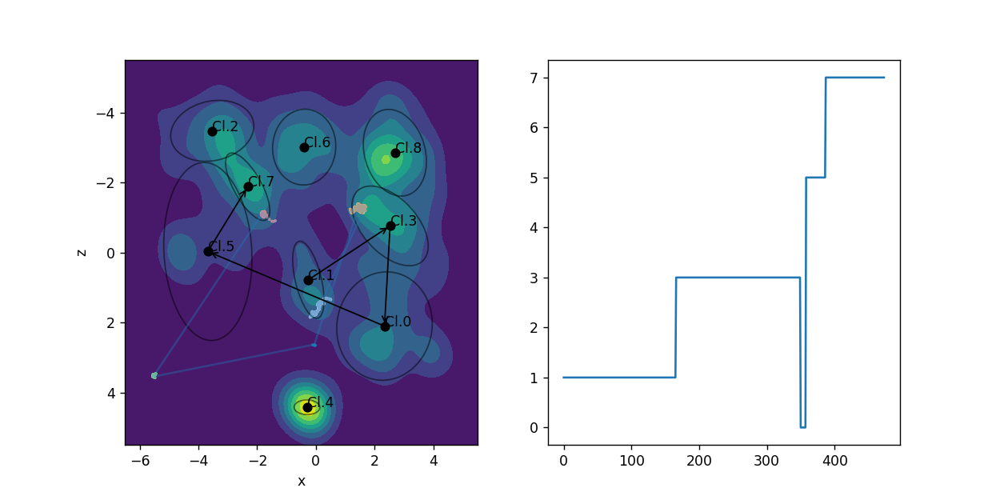

[1, 3, 0, 5, 7]
[[1, 3], [3, 0], [0, 5], [5, 7]]


<IPython.core.display.Javascript object>


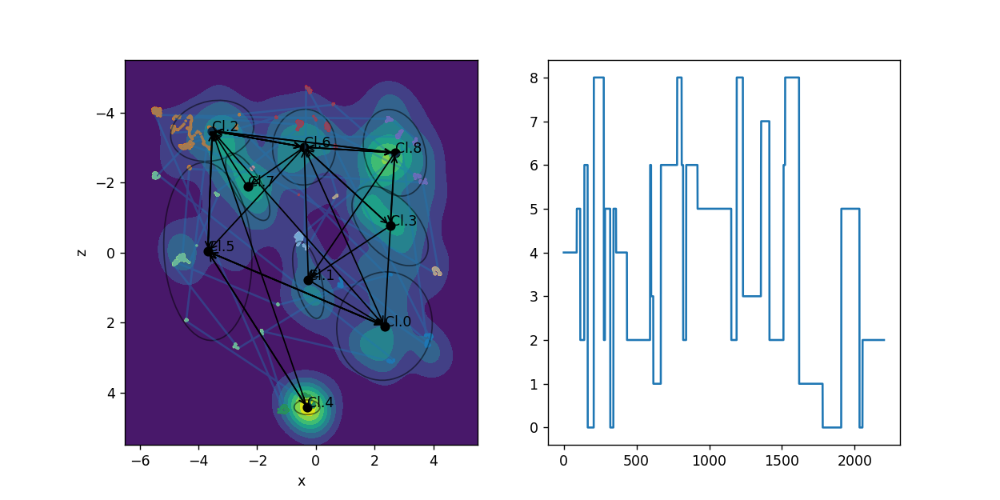

[4, 5, 2, 6, 0, 8, 2, 5, 0, 5, 4, 2, 6, 3, 1, 6, 8, 6, 2, 6, 5, 2, 8, 3, 6, 7, 2, 6, 8, 1, 0, 5, 0, 2]
[[4, 5], [5, 2], [2, 6], [6, 0], [0, 8], [8, 2], [2, 5], [5, 0], [0, 5], [5, 4], [4, 2], [2, 6], [6, 3], [3, 1], [1, 6], [6, 8], [8, 6], [6, 2], [2, 6], [6, 5], [5, 2], [2, 8], [8, 3], [3, 6], [6, 7], [7, 2], [2, 6], [6, 8], [8, 1], [1, 0], [0, 5], [5, 0], [0, 2]]


<IPython.core.display.Javascript object>


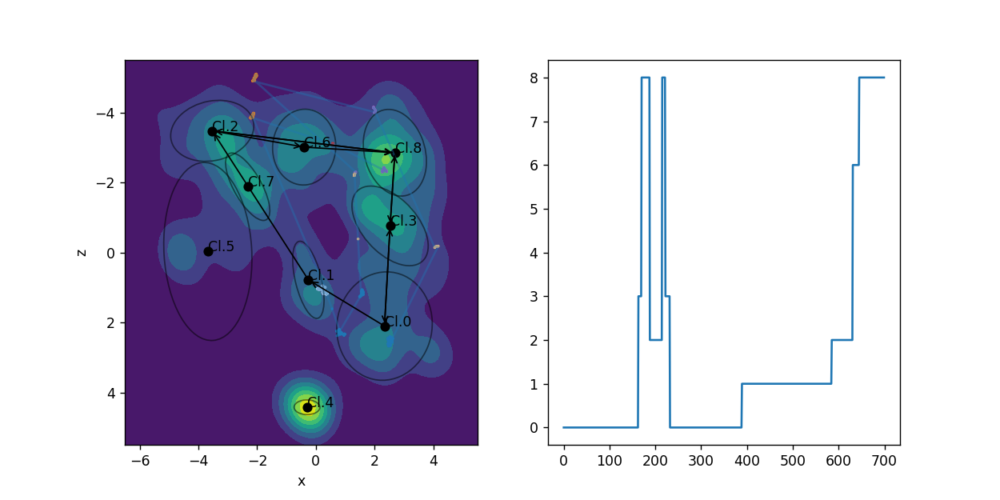

[0, 3, 8, 2, 8, 3, 0, 1, 2, 6, 8]
[[0, 3], [3, 8], [8, 2], [2, 8], [8, 3], [3, 0], [0, 1], [1, 2], [2, 6], [6, 8]]


<IPython.core.display.Javascript object>


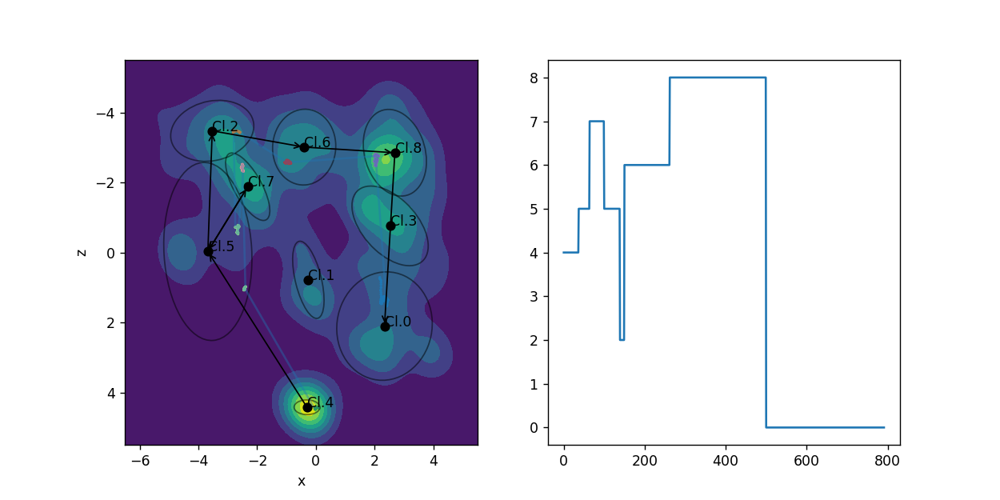

[4, 5, 7, 5, 2, 6, 8, 0]
[[4, 5], [5, 7], [7, 5], [5, 2], [2, 6], [6, 8], [8, 0]]


<IPython.core.display.Javascript object>


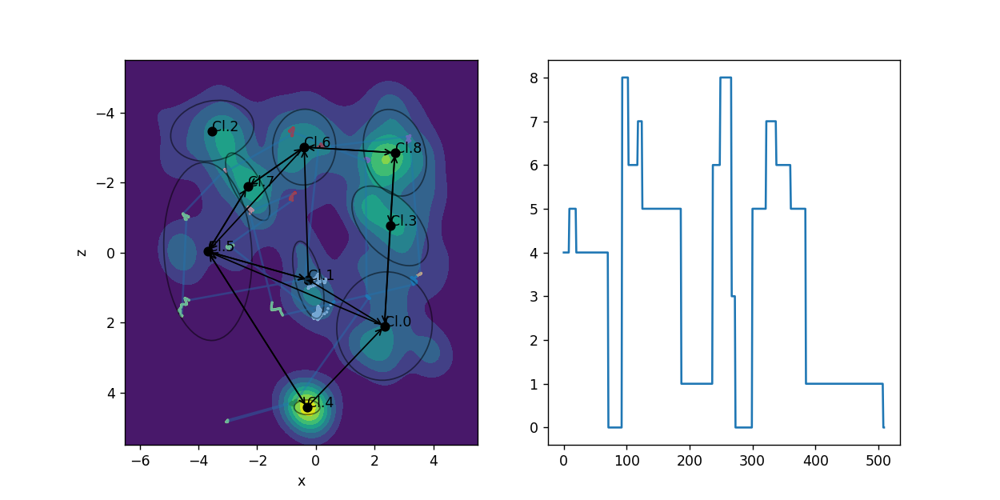

[4, 5, 4, 0, 8, 6, 7, 5, 1, 6, 8, 3, 0, 5, 7, 6, 5, 1, 0]
[[4, 5], [5, 4], [4, 0], [0, 8], [8, 6], [6, 7], [7, 5], [5, 1], [1, 6], [6, 8], [8, 3], [3, 0], [0, 5], [5, 7], [7, 6], [6, 5], [5, 1], [1, 0]]


<IPython.core.display.Javascript object>


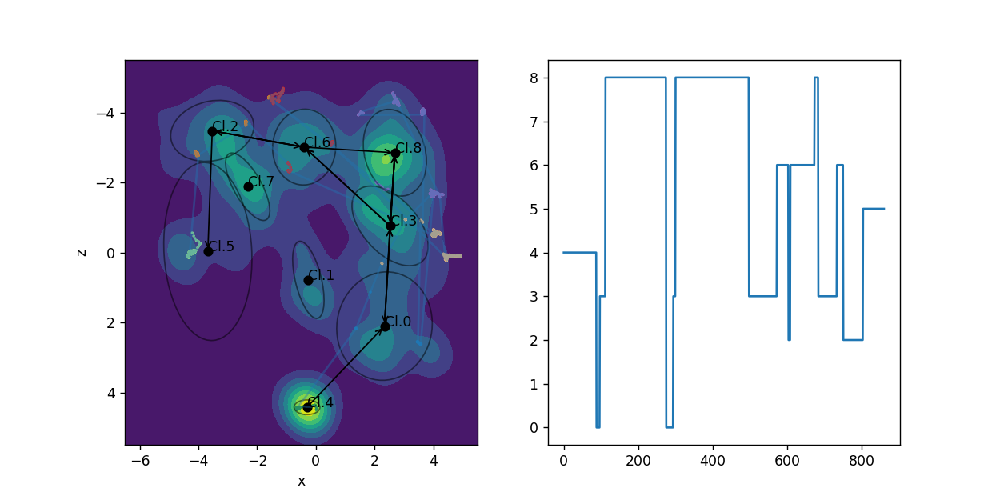

[4, 0, 3, 8, 0, 3, 8, 3, 6, 2, 6, 8, 3, 6, 2, 5]
[[4, 0], [0, 3], [3, 8], [8, 0], [0, 3], [3, 8], [8, 3], [3, 6], [6, 2], [2, 6], [6, 8], [8, 3], [3, 6], [6, 2], [2, 5]]


<IPython.core.display.Javascript object>


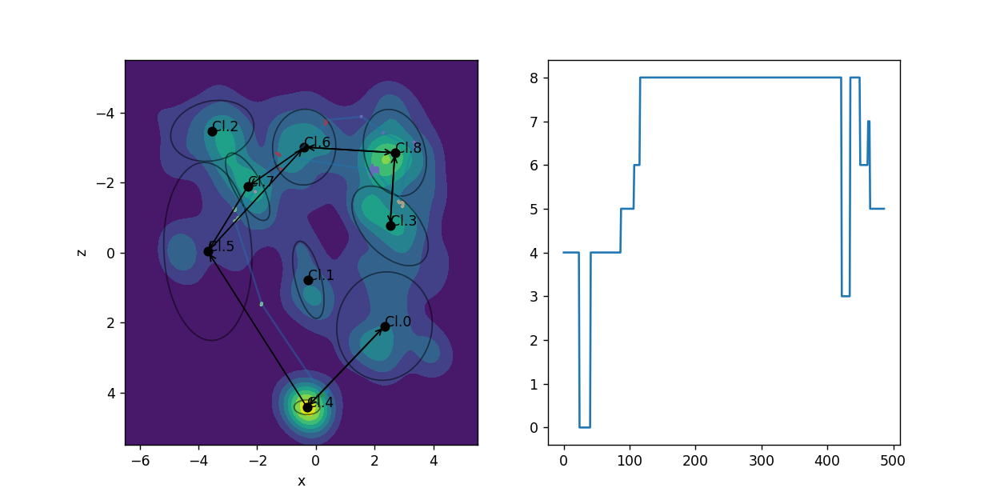

[4, 0, 4, 5, 6, 8, 3, 8, 6, 7, 5]
[[4, 0], [0, 4], [4, 5], [5, 6], [6, 8], [8, 3], [3, 8], [8, 6], [6, 7], [7, 5]]


<IPython.core.display.Javascript object>


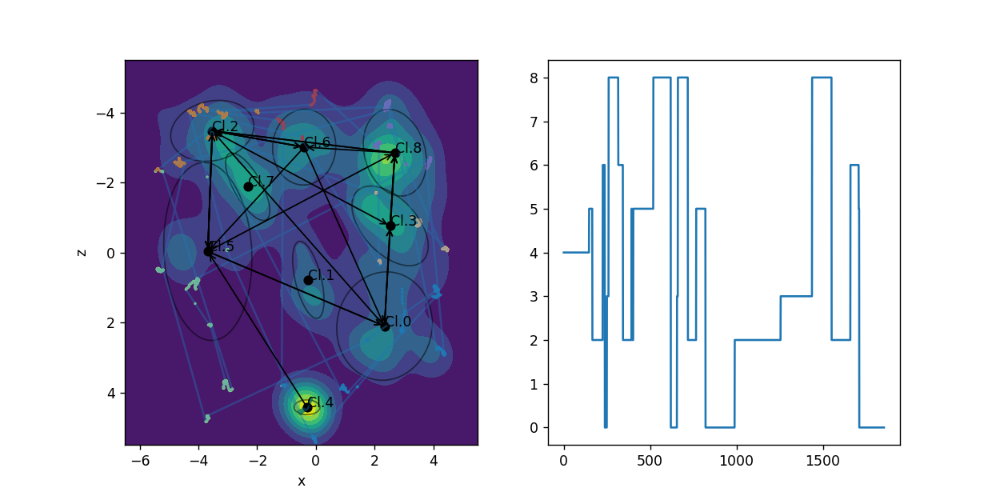

[4, 5, 2, 6, 0, 3, 8, 6, 2, 5, 2, 5, 8, 0, 3, 8, 2, 5, 0, 2, 3, 8, 2, 6, 5, 0]
[[4, 5], [5, 2], [2, 6], [6, 0], [0, 3], [3, 8], [8, 6], [6, 2], [2, 5], [5, 2], [2, 5], [5, 8], [8, 0], [0, 3], [3, 8], [8, 2], [2, 5], [5, 0], [0, 2], [2, 3], [3, 8], [8, 2], [2, 6], [6, 5], [5, 0]]


<IPython.core.display.Javascript object>


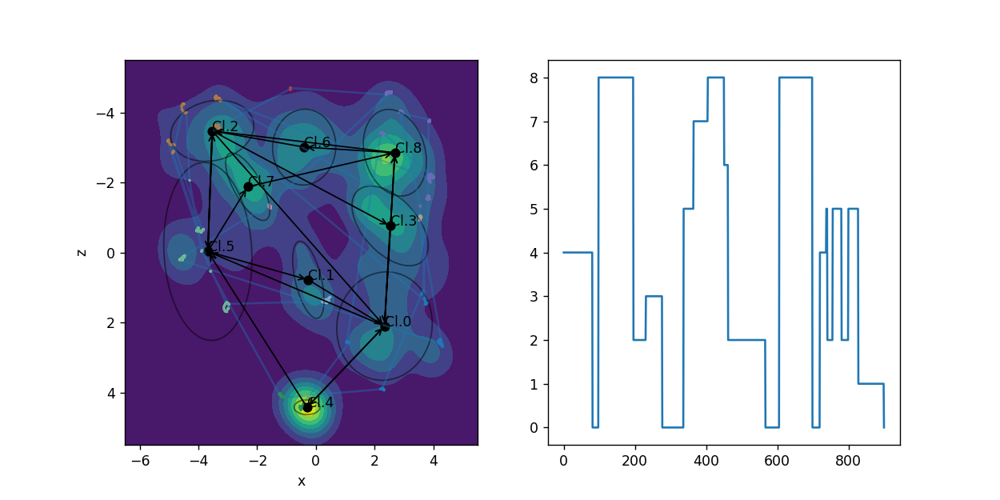

[4, 0, 8, 2, 3, 0, 5, 7, 8, 6, 2, 0, 8, 0, 4, 5, 2, 5, 2, 5, 1, 0]
[[4, 0], [0, 8], [8, 2], [2, 3], [3, 0], [0, 5], [5, 7], [7, 8], [8, 6], [6, 2], [2, 0], [0, 8], [8, 0], [0, 4], [4, 5], [5, 2], [2, 5], [5, 2], [2, 5], [5, 1], [1, 0]]


<IPython.core.display.Javascript object>


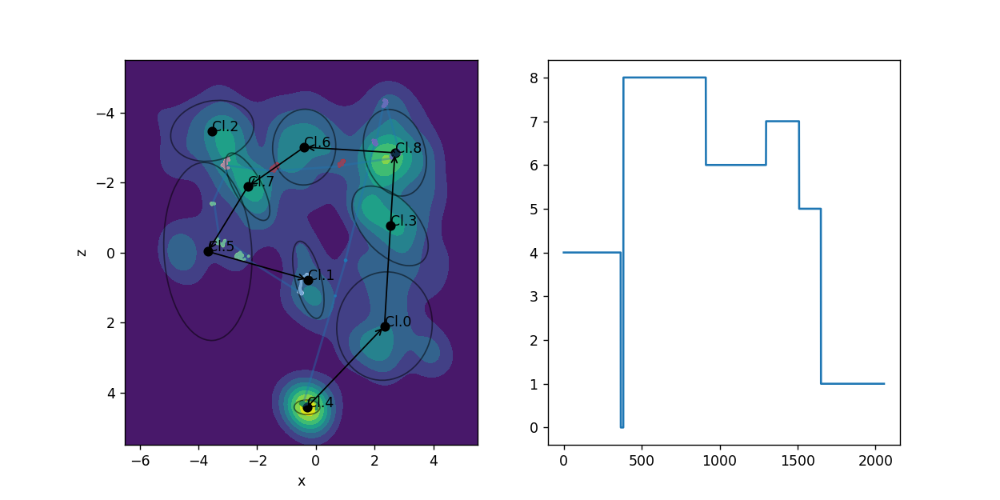

[4, 0, 8, 6, 7, 5, 1]
[[4, 0], [0, 8], [8, 6], [6, 7], [7, 5], [5, 1]]


<IPython.core.display.Javascript object>


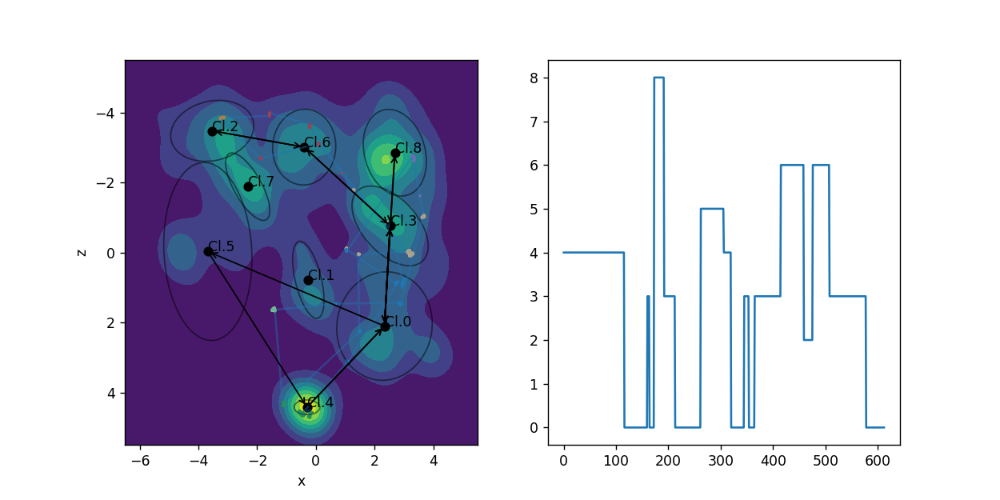

[4, 0, 3, 0, 8, 3, 0, 5, 4, 0, 3, 0, 3, 6, 2, 6, 3, 0]
[[4, 0], [0, 3], [3, 0], [0, 8], [8, 3], [3, 0], [0, 5], [5, 4], [4, 0], [0, 3], [3, 0], [0, 3], [3, 6], [6, 2], [2, 6], [6, 3], [3, 0]]


<IPython.core.display.Javascript object>


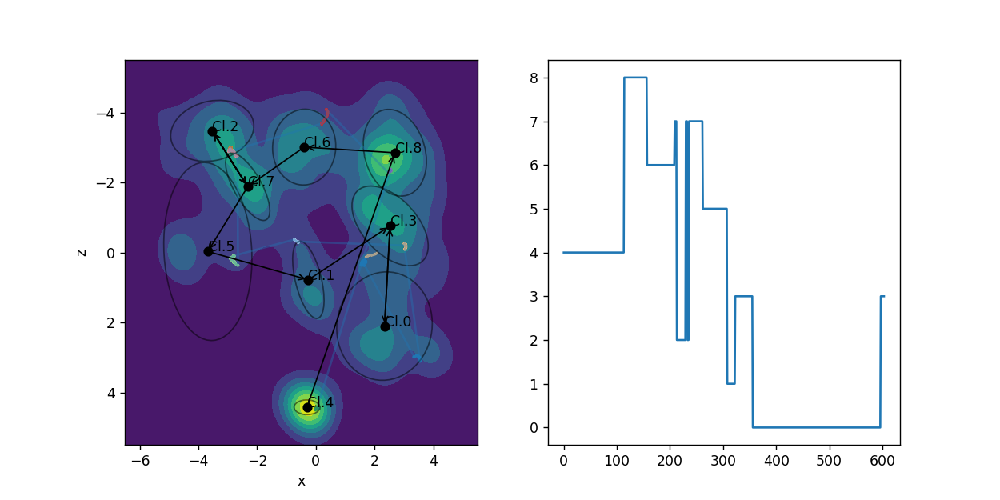

[4, 8, 6, 7, 2, 7, 2, 7, 5, 1, 3, 0, 3]
[[4, 8], [8, 6], [6, 7], [7, 2], [2, 7], [7, 2], [2, 7], [7, 5], [5, 1], [1, 3], [3, 0], [0, 3]]


<IPython.core.display.Javascript object>


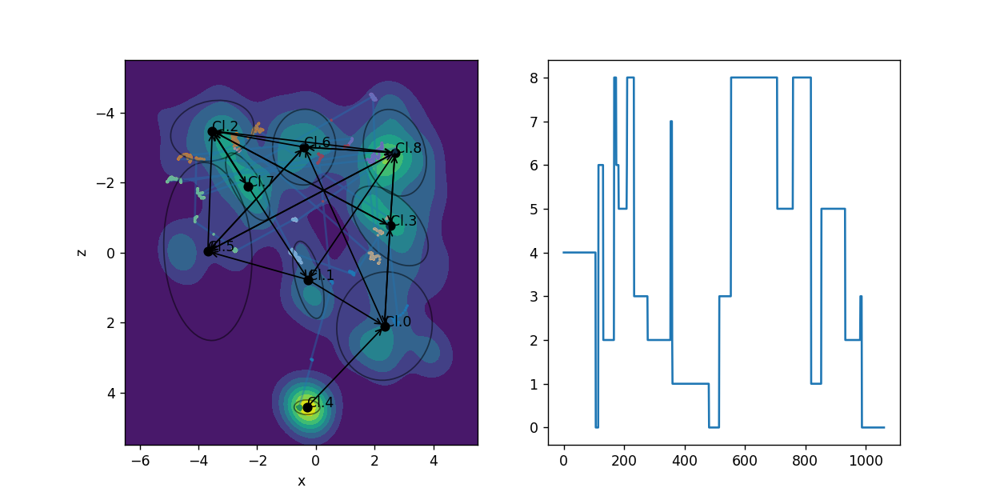

[4, 0, 6, 2, 8, 6, 5, 6, 8, 3, 2, 7, 2, 1, 0, 3, 8, 5, 8, 1, 5, 2, 3, 0]
[[4, 0], [0, 6], [6, 2], [2, 8], [8, 6], [6, 5], [5, 6], [6, 8], [8, 3], [3, 2], [2, 7], [7, 2], [2, 1], [1, 0], [0, 3], [3, 8], [8, 5], [5, 8], [8, 1], [1, 5], [5, 2], [2, 3], [3, 0]]


<IPython.core.display.Javascript object>


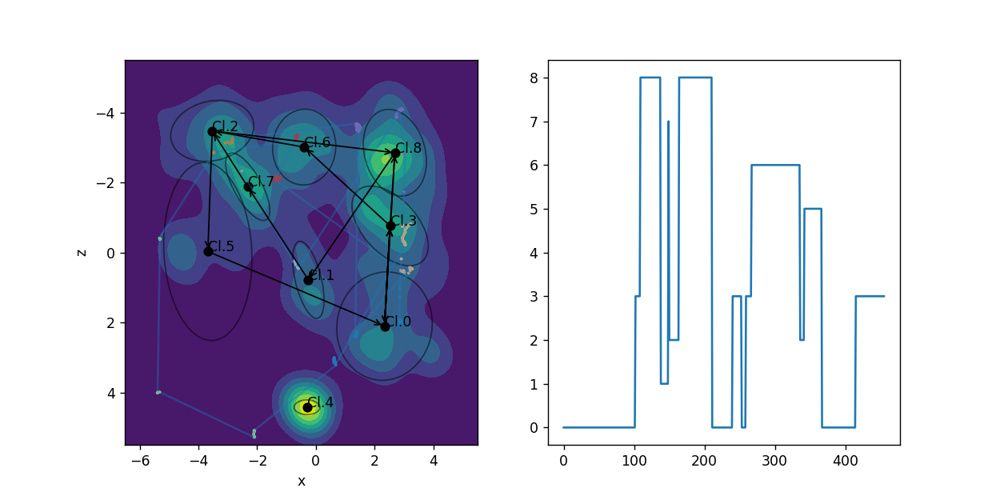

[0, 3, 8, 1, 7, 2, 8, 0, 3, 0, 3, 6, 2, 5, 0, 3]
[[0, 3], [3, 8], [8, 1], [1, 7], [7, 2], [2, 8], [8, 0], [0, 3], [3, 0], [0, 3], [3, 6], [6, 2], [2, 5], [5, 0], [0, 3]]


<IPython.core.display.Javascript object>


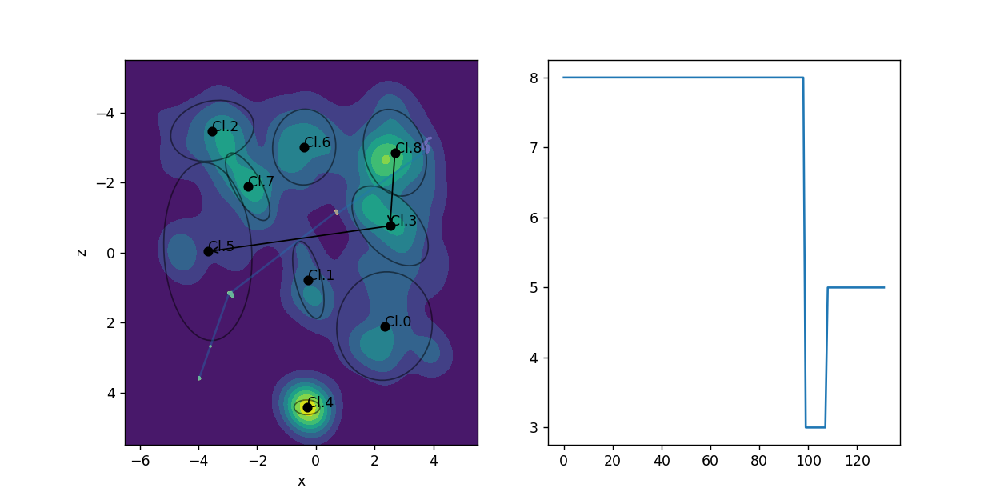

[8, 3, 5]
[[8, 3], [3, 5]]


<IPython.core.display.Javascript object>


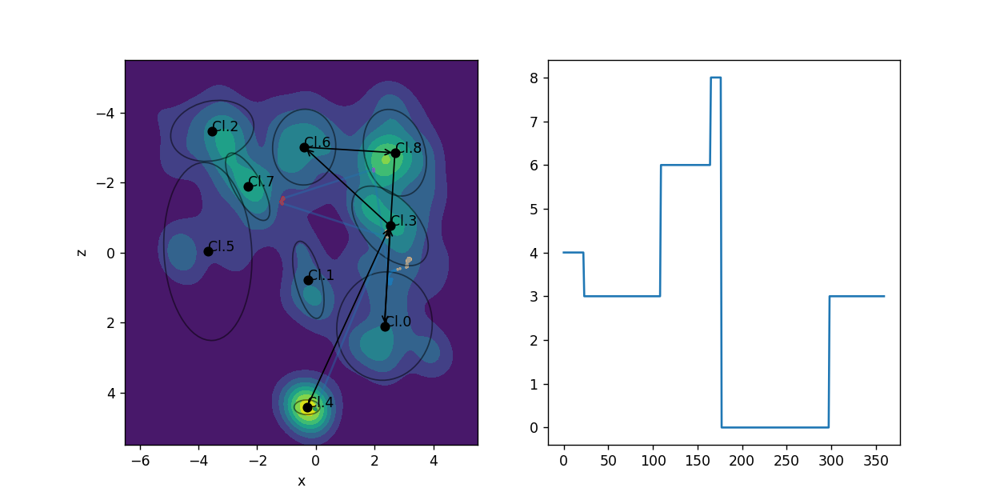

[4, 3, 6, 8, 0, 3]
[[4, 3], [3, 6], [6, 8], [8, 0], [0, 3]]


<IPython.core.display.Javascript object>


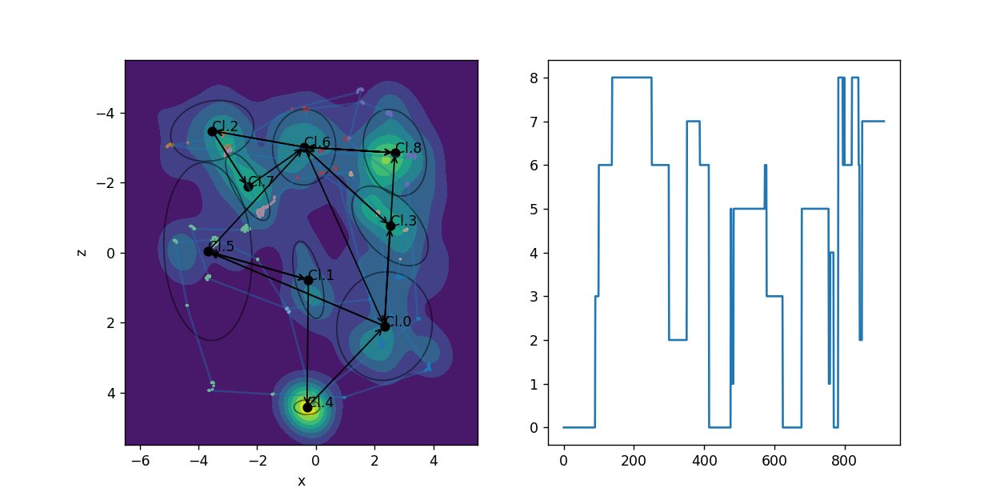

[0, 3, 6, 8, 6, 2, 7, 6, 0, 5, 1, 5, 6, 3, 0, 5, 1, 4, 0, 8, 6, 8, 6, 8, 6, 2, 7]
[[0, 3], [3, 6], [6, 8], [8, 6], [6, 2], [2, 7], [7, 6], [6, 0], [0, 5], [5, 1], [1, 5], [5, 6], [6, 3], [3, 0], [0, 5], [5, 1], [1, 4], [4, 0], [0, 8], [8, 6], [6, 8], [8, 6], [6, 8], [8, 6], [6, 2], [2, 7]]


<IPython.core.display.Javascript object>


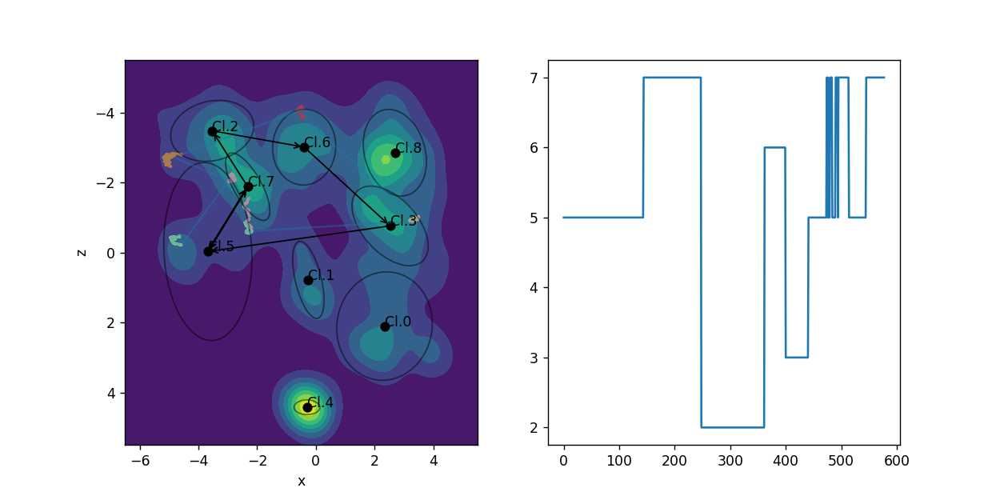

[5, 7, 2, 6, 3, 5, 7, 5, 7, 5, 7, 5, 7, 5, 7, 5, 7]
[[5, 7], [7, 2], [2, 6], [6, 3], [3, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 7]]


<IPython.core.display.Javascript object>


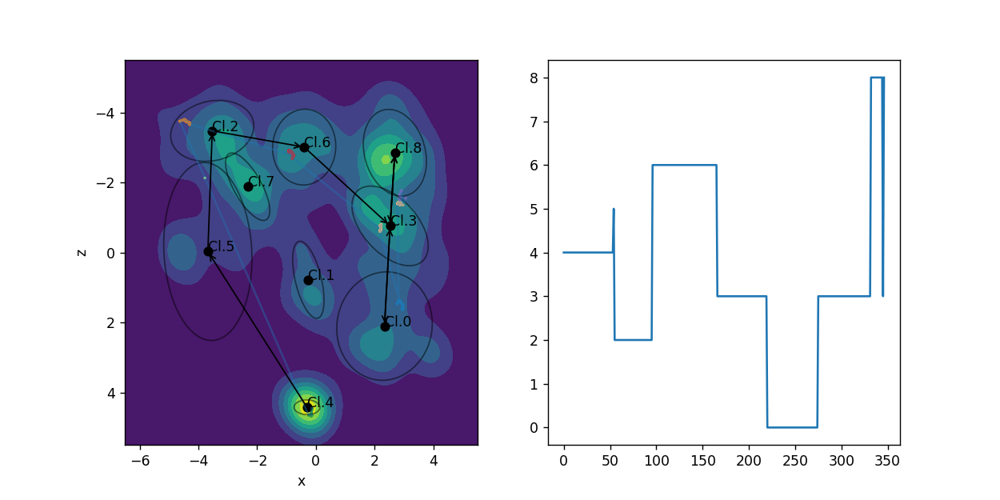

[4, 5, 2, 6, 3, 0, 3, 8, 3, 8]
[[4, 5], [5, 2], [2, 6], [6, 3], [3, 0], [0, 3], [3, 8], [8, 3], [3, 8]]


<IPython.core.display.Javascript object>


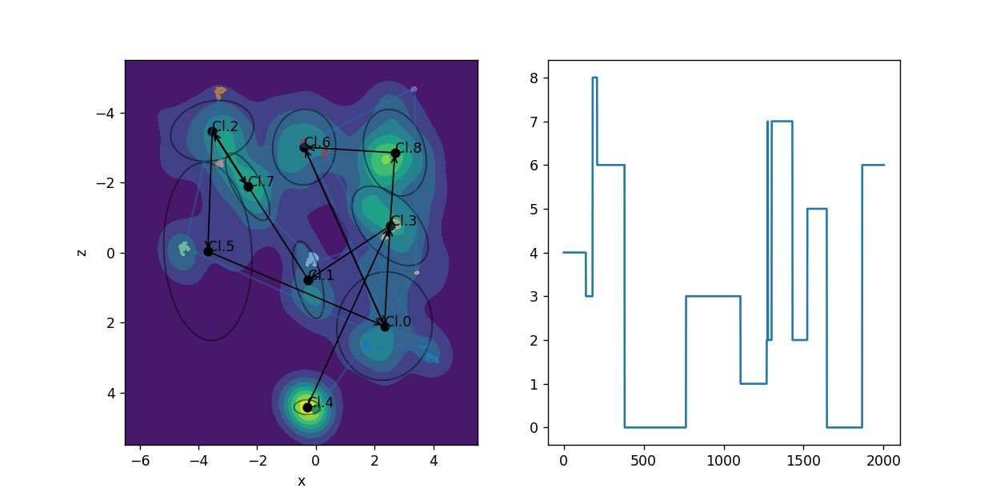

[4, 3, 8, 6, 0, 3, 1, 2, 7, 2, 7, 2, 5, 0, 6]
[[4, 3], [3, 8], [8, 6], [6, 0], [0, 3], [3, 1], [1, 2], [2, 7], [7, 2], [2, 7], [7, 2], [2, 5], [5, 0], [0, 6]]


<IPython.core.display.Javascript object>


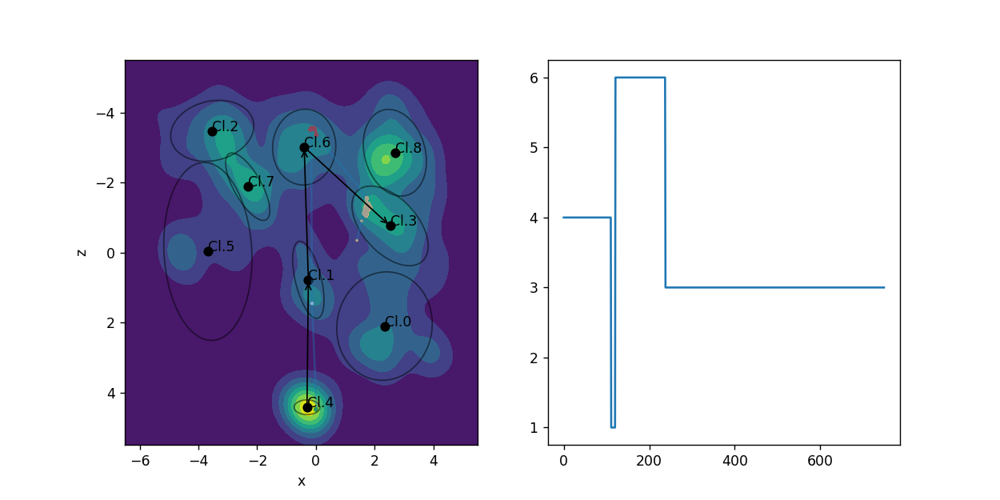

[4, 1, 6, 3]
[[4, 1], [1, 6], [6, 3]]


<IPython.core.display.Javascript object>


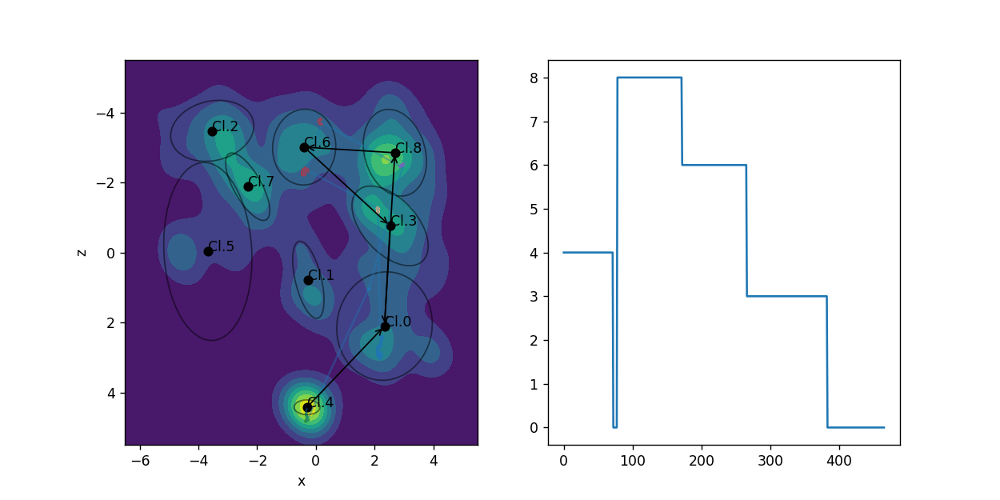

[4, 0, 8, 6, 3, 0]
[[4, 0], [0, 8], [8, 6], [6, 3], [3, 0]]


<IPython.core.display.Javascript object>


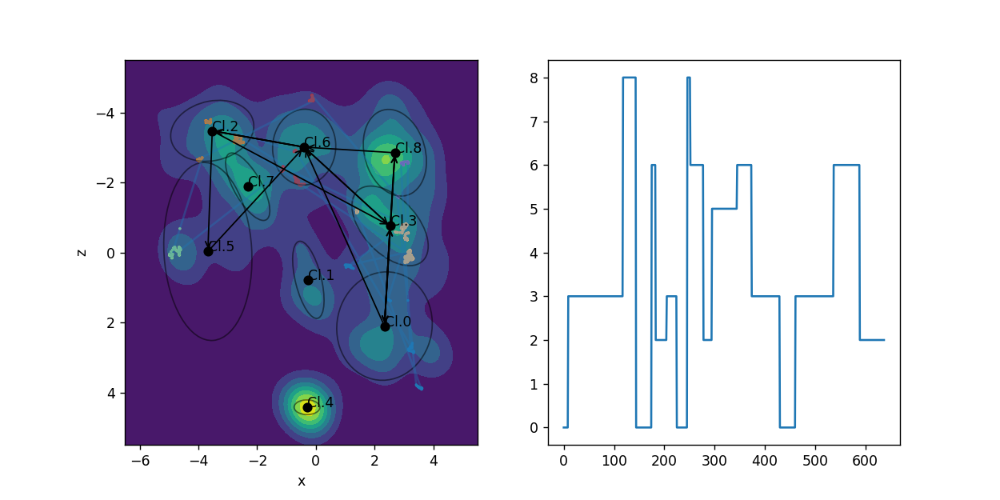

[0, 3, 8, 0, 6, 2, 3, 0, 8, 6, 2, 5, 6, 3, 0, 3, 6, 2]
[[0, 3], [3, 8], [8, 0], [0, 6], [6, 2], [2, 3], [3, 0], [0, 8], [8, 6], [6, 2], [2, 5], [5, 6], [6, 3], [3, 0], [0, 3], [3, 6], [6, 2]]


<IPython.core.display.Javascript object>


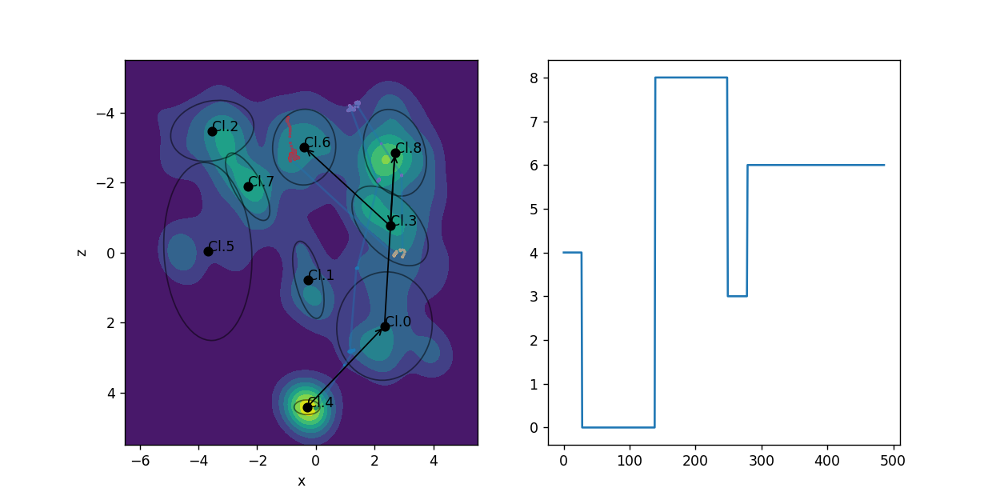

[4, 0, 8, 3, 6]
[[4, 0], [0, 8], [8, 3], [3, 6]]


<IPython.core.display.Javascript object>


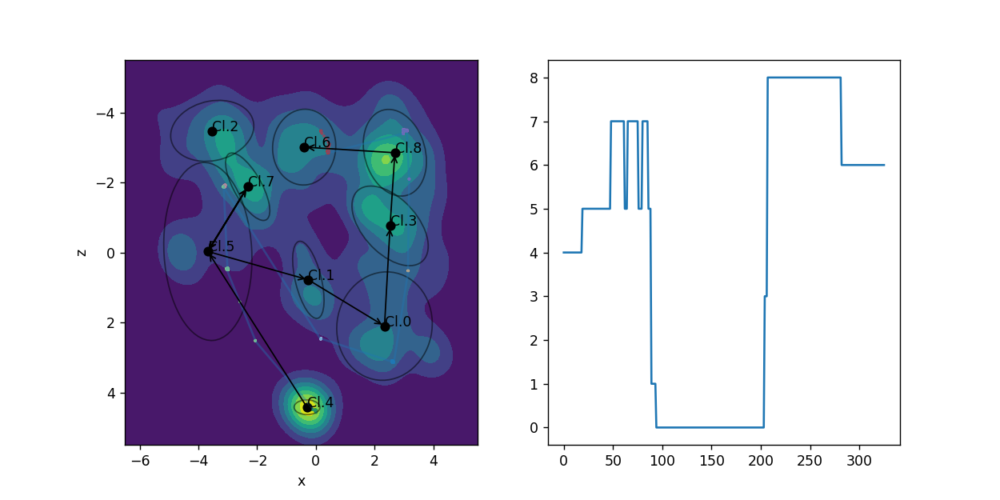

[4, 5, 7, 5, 7, 5, 7, 5, 1, 0, 3, 8, 6]
[[4, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 7], [7, 5], [5, 1], [1, 0], [0, 3], [3, 8], [8, 6]]


<IPython.core.display.Javascript object>


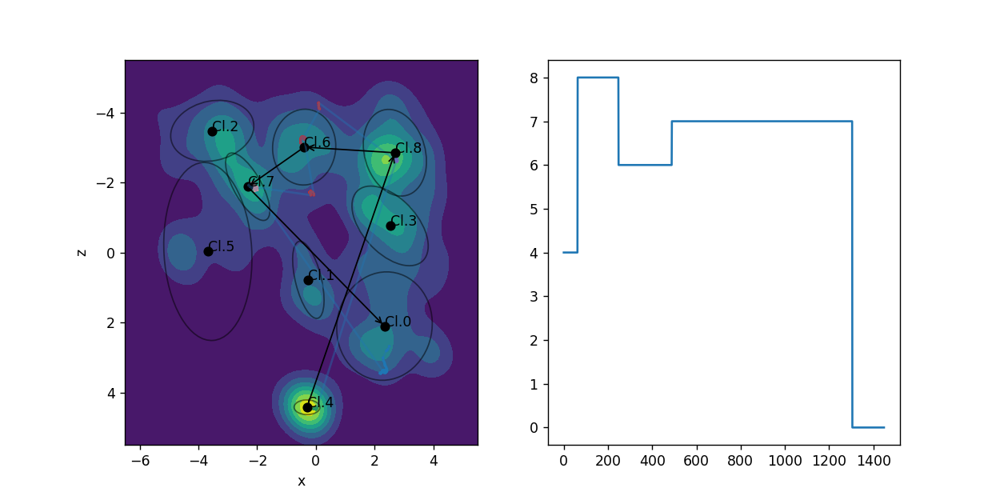

[4, 8, 6, 7, 0]
[[4, 8], [8, 6], [6, 7], [7, 0]]


<IPython.core.display.Javascript object>


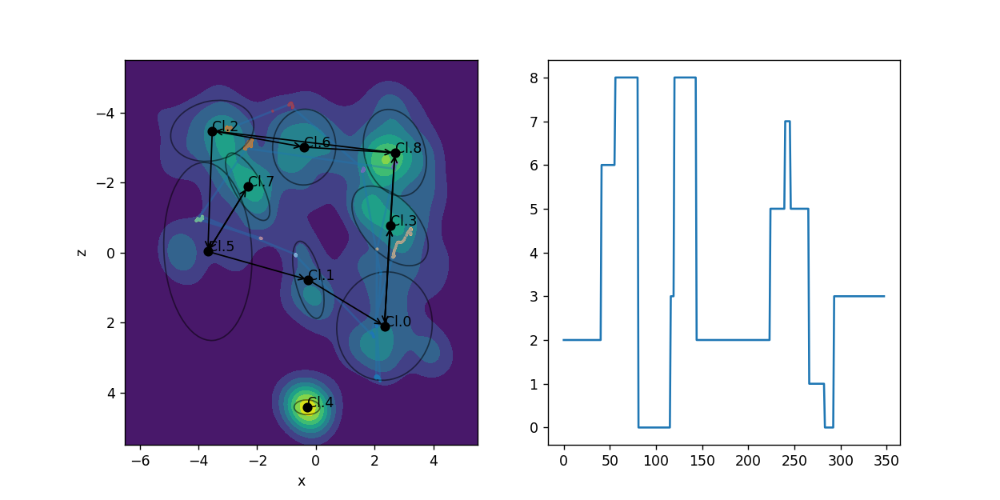

[2, 6, 8, 0, 3, 8, 2, 5, 7, 5, 1, 0, 3]
[[2, 6], [6, 8], [8, 0], [0, 3], [3, 8], [8, 2], [2, 5], [5, 7], [7, 5], [5, 1], [1, 0], [0, 3]]


<IPython.core.display.Javascript object>


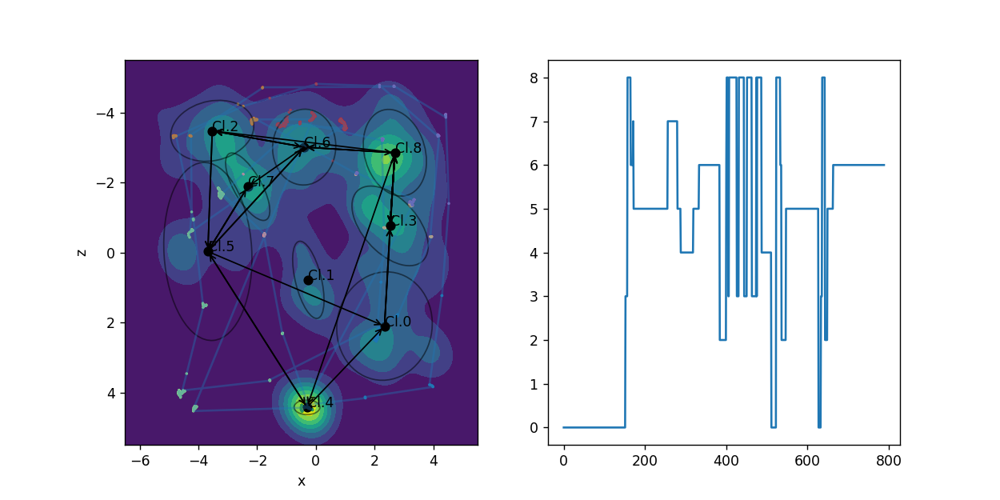

[0, 3, 8, 6, 7, 5, 7, 5, 4, 5, 6, 2, 6, 8, 3, 8, 3, 8, 3, 8, 3, 8, 3, 8, 4, 0, 8, 6, 2, 5, 0, 3, 8, 2, 5, 6]
[[0, 3], [3, 8], [8, 6], [6, 7], [7, 5], [5, 7], [7, 5], [5, 4], [4, 5], [5, 6], [6, 2], [2, 6], [6, 8], [8, 3], [3, 8], [8, 3], [3, 8], [8, 3], [3, 8], [8, 3], [3, 8], [8, 3], [3, 8], [8, 4], [4, 0], [0, 8], [8, 6], [6, 2], [2, 5], [5, 0], [0, 3], [3, 8], [8, 2], [2, 5], [5, 6]]


<IPython.core.display.Javascript object>


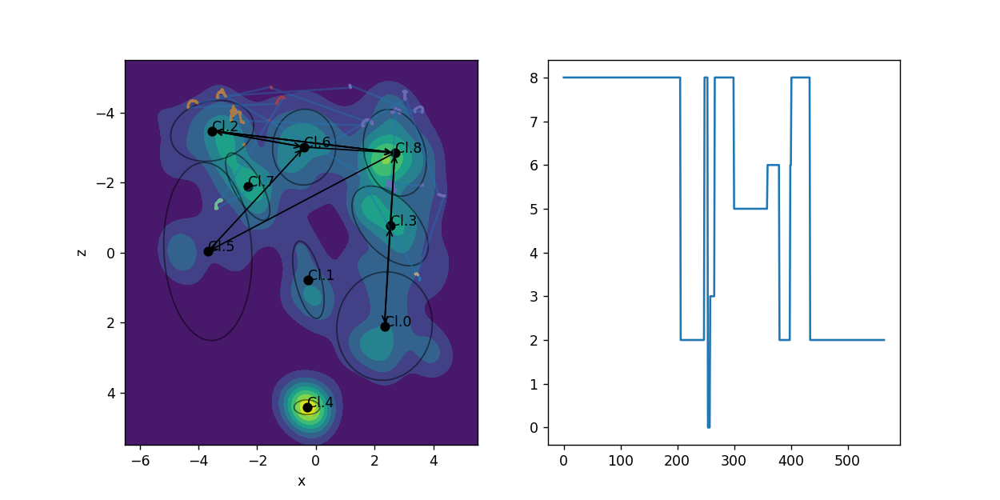

[8, 2, 8, 0, 3, 8, 5, 6, 2, 6, 8, 2]
[[8, 2], [2, 8], [8, 0], [0, 3], [3, 8], [8, 5], [5, 6], [6, 2], [2, 6], [6, 8], [8, 2]]


<IPython.core.display.Javascript object>


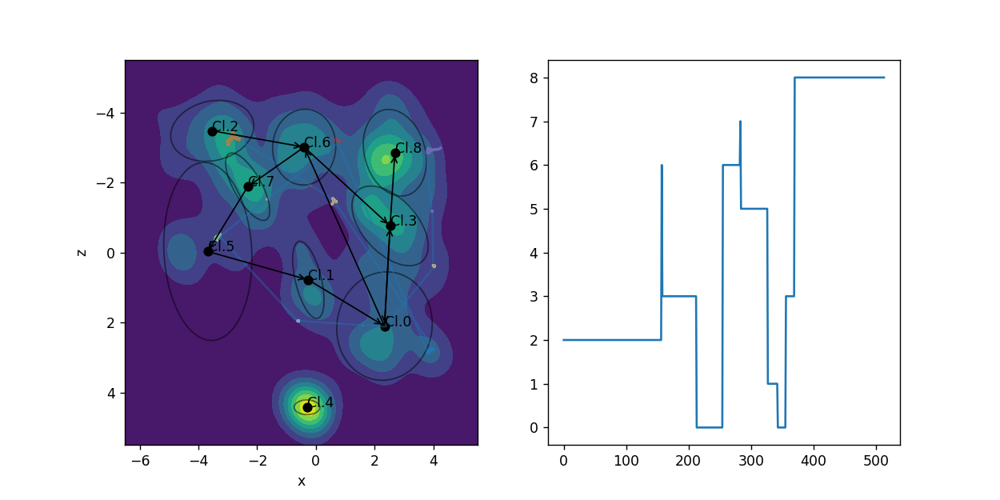

[2, 6, 3, 0, 6, 7, 5, 1, 0, 3, 8]
[[2, 6], [6, 3], [3, 0], [0, 6], [6, 7], [7, 5], [5, 1], [1, 0], [0, 3], [3, 8]]


<IPython.core.display.Javascript object>


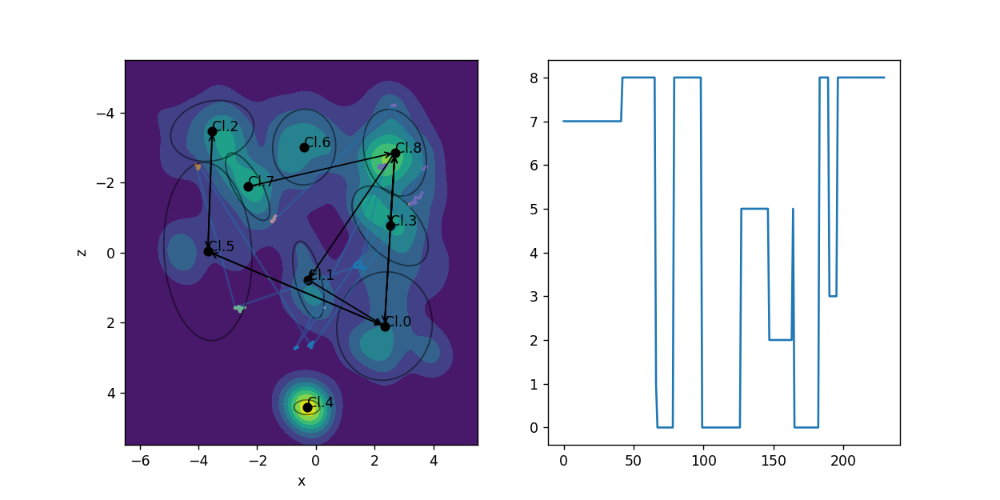

[7, 8, 1, 0, 8, 0, 5, 2, 5, 0, 8, 3, 8]
[[7, 8], [8, 1], [1, 0], [0, 8], [8, 0], [0, 5], [5, 2], [2, 5], [5, 0], [0, 8], [8, 3], [3, 8]]


<IPython.core.display.Javascript object>


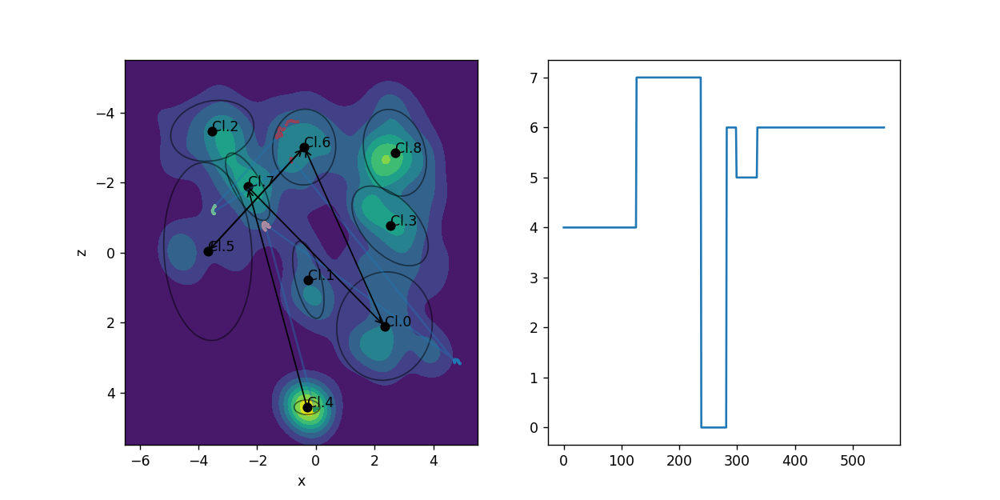

[4, 7, 0, 6, 5, 6]
[[4, 7], [7, 0], [0, 6], [6, 5], [5, 6]]


In [207]:


for uId in ids:
    path = paths[uId] #ts[uId],xs[uId],ys[uId],zs[uId]
    #dpath = dpaths[uId]
    t,x,y,z = paths[uId].T
    X = np.vstack([x,z]).T
    labels = gmm.predict(X)
    fig, [ax,ax1] = plt.subplots(1,2,figsize=(10,5))
    
    #ax = fig.add_subplot()
    cfset = ax.contourf(Xc, Zc, f)
    ax.plot(x,z,alpha=0.4)
    ax.scatter(x,z,s=1,c=[mycols[l] for l in labels])

    ax.set_xlabel('x')
    ax.set_ylabel('z')
    ax.set_ylim((5.5,-5.5))
    ax.set_xlim((-6.5,5.5))
    
    means = gmm.means_
    covariances = gmm.covariances_

    drawEllipses(means, covariances, ax=ax)
    for i, mean in enumerate(means):
        ax.text(mean[0],mean[1],'Cl.'+str(i))
    
    ax1.plot(labels)
    
    visits = [labels[0]]
    oldl = labels[0]
    for l in labels:
        if l != oldl:
            visits.append(l)
            oldl = l
    
            
    print(visits)
    transitions = [[s,e] for s,e in zip(visits[:-1],visits[1:])]
    print(transitions)
    for t in transitions:
        s,e = t
        x,y = means[s]
        x1,y1 = means[e]
        dx,dy = (x1-x), (y1-y)
        #ax.arrow(x,y,0.9*dx,0.9*dy,width=0.1)
        ax.annotate("", xy=(x1,y1), xytext=(x, y), arrowprops=dict(arrowstyle="->"))
    
    

In [84]:
labels

array([4, 4, 4, ..., 2, 2, 2])

In [67]:
labels

array([4, 4, 4, ..., 2, 2, 2])